# Load packages

In [3]:
# Loading the required packages to run this notebook
from src.visualisation.SummaryModels import SummaryModels
import src.utils.utils as utils
from src.visualisation.VisualiseTrajectories import VisualiseTrajectories
from src.data.Datasets import AISDataset
from pathlib import Path
import pandas as pd

# Define the region to look into
region = "Bornholm"
zoom = 8
n = 10

In [4]:
# Use the SummaryModels class for everything related to the reconstructions
generative_dist = "GMM"
GMM_components = 3
learning_rate = 0.00003
GMM_equally_weighted = False
file_name = "RegionBornholm_01062019_30092019_Fish_14400_86400_600"
summary_models = SummaryModels(file_name, generative_dist=generative_dist, learning_rate=learning_rate,
                               GMM_equally_weighted=GMM_equally_weighted, GMM_components=GMM_components)

In [5]:
# Use the VisualiseTrajectories class for geographically visualising trajectories 
fig_size = (10, 10)
visualise_trajectories = VisualiseTrajectories(region, save_figures=False, plot_figures=True, fig_size=fig_size, zoom=zoom)
processed_data_dir =  visualise_trajectories.processed_data_dir

# Read the info file to know how to read the data file
data_file = processed_data_dir / ("data_" + file_name + ".pkl")
data_info_file = processed_data_dir / ("datasetInfo_" + file_name + ".pkl")
data_info = utils.read_data_info_file(data_info_file)

# Load the static Google Map image for the RIO
img = visualise_trajectories.read_static_map()

In [6]:
# Function that plots the actual and reconstructed side by side
def plot_actual_reconstructed(idx):
    # Setup for the plotting
    fig_size_tmp = visualise_trajectories.fig_size
    visualise_trajectories.fig_size = (20,10)
    fig, ax = visualise_trajectories.visualise_static_map(img, subplots=[1, 2])
    plot_figures_tmp = visualise_trajectories.plot_figures
    visualise_trajectories.plot_figures = False
        
    # For plotting a single complete vessel trajectory on the static map
    index = df_n.iloc[idx]["Index"]
    data_set = AISDataset(file_name, data_info=data_info, indicies=[index], discrete=False)
    df_actual = utils.get_tracks_from_dataset(data_set, continuous_representation=True)
    
    # For plotting the corresponding model reconstruction
    index = df_n.iloc[idx]["Data set Index"]
    data_set = train_evaluate.validation_dataloader.dataset
    reconstruction = train_evaluate.track_reconstructions(data_set, index)
    
    df_recon = reconstruction["Reconstruction"][2:]
    
    # Setup actual and reconstruction data frames
    df_speed = utils.concat_actual_recon(df_actual, df_recon, "Speed")
    df_course = utils.concat_actual_recon(df_actual, df_recon, "Course")
    
    # Do the actual plotting
    visualise_trajectories.plot_single_track(df_actual, ax[0], use_cmap=True, df_speed=df_speed,
                                                      df_course=df_course, fig=fig, rect=[0.15, 0.72, 0.12, 0.12], 
                                                      rect2=[0.575, 0.72, 0.12, 0.12])
    visualise_trajectories.plot_figures = plot_figures_tmp
    visualise_trajectories.plot_single_track(df_recon, ax[1], use_cmap=True)
    visualise_trajectories.fig_size = fig_size_tmp
    return {"Actual trajectory": df_actual, "Reconstructed trajectory": df_recon,
            "Speed data frame": df_speed, "Course data frame": df_course}

# Fishing Reconstruction Example

In [8]:
# Get some trajectories to show an example from 
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_GMM3NEW_lr3e-05.pth


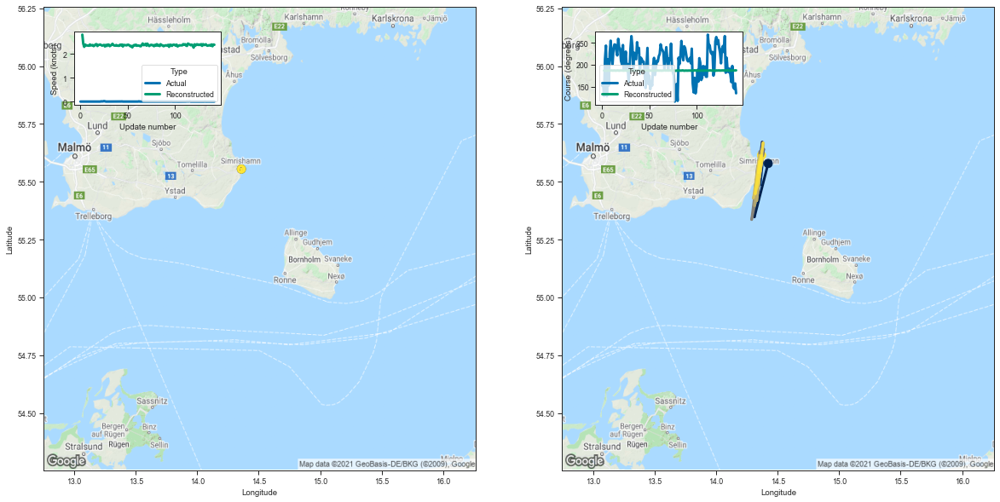

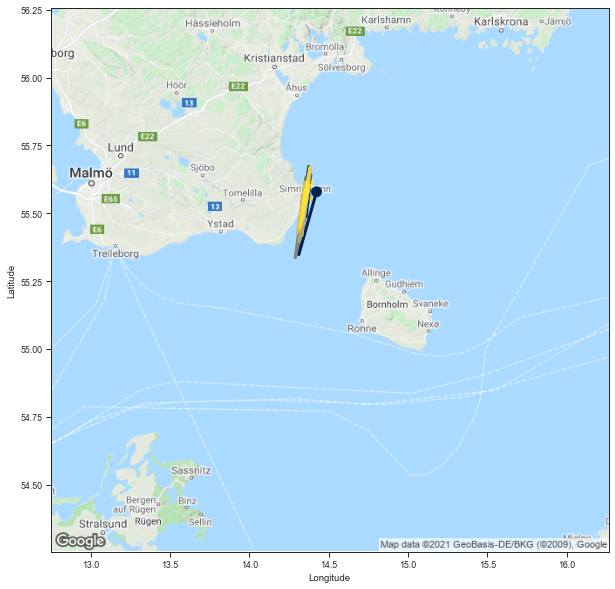

     Data set Index    Index       MMSI  Longitude   Latitude     Speed  \
0                 0  6962046  265759000  14.359659  55.554878  0.000000   
1                 0  6962046  265759000  14.359651  55.554905  0.001667   
2                 0  6962046  265759000  14.359662  55.554871  0.000000   
3                 0  6962046  265759000  14.359672  55.554893  0.000000   
4                 0  6962046  265759000  14.359683  55.554924  0.001754   
..              ...      ...        ...        ...        ...       ...   
138               0  6962046  265759000  14.359682  55.554882  0.000000   
139               0  6962046  265759000  14.359687  55.554901  0.000000   
140               0  6962046  265759000  14.359698  55.554886  0.000000   
141               0  6962046  265759000  14.359681  55.554882  0.000000   
142               0  6962046  265759000  14.359686  55.554871  0.000000   

         Course Ship type  Track length          Time stamp  
0    152.721664   Fishing           1

,Longitude,Latitude,Speed,Course,Longitude sigma,Latitude sigma,Speed sigma,Course sigma,Max mixing index,Max mixing probability
2,14.423255,55.579060,2.801803,187.027206,0.060266,0.146449,3.394372,100.414116,1,1.0
3,14.311489,55.347660,2.422770,186.519104,0.036734,0.088538,3.178276,100.177574,1,1.0
4,14.305527,55.361332,2.291219,186.091980,0.033080,0.083844,3.109030,99.962242,1,1.0
5,14.332433,55.472065,2.386317,186.985916,0.034691,0.083198,3.182883,100.447769,1,1.0
6,14.351875,55.541279,2.354616,187.006592,0.033616,0.082801,3.163842,100.468307,1,1.0
...,...,...,...,...,...,...,...,...,...,...
138,14.370439,55.592297,2.336846,187.159180,0.034130,0.085132,3.155212,100.541008,1,1.0
139,14.366739,55.604561,2.391228,187.283295,0.034318,0.084779,3.202372,100.605492,1,1.0
140,14.363947,55.609650,2.316641,187.052582,0.033858,0.083017,3.127374,100.460403,1,1.0
141,14.344457,55.538086,2.387315,187.132065,0.033837,0.082041,3.183943,100.524208,1,1.0


In [9]:
# Plot the actual and reconstructed trajectories side by side
tracks = plot_actual_reconstructed(3)

# Plot them on the same figure
visualise_trajectories.fig_size = fig_size
plot_figures_tmp = visualise_trajectories.plot_figures
fig, ax = visualise_trajectories.visualise_static_map(img)
visualise_trajectories.plot_figures = False
visualise_trajectories.plot_single_track(tracks["Actual trajectory"], ax, use_cmap=True)
visualise_trajectories.plot_figures = plot_figures_tmp
visualise_trajectories.plot_single_track(tracks["Reconstructed trajectory"], ax, use_cmap=True)

print(tracks['Actual trajectory'])
tracks['Reconstructed trajectory']

# Best Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_GMM3NEW_lr3e-05.pth


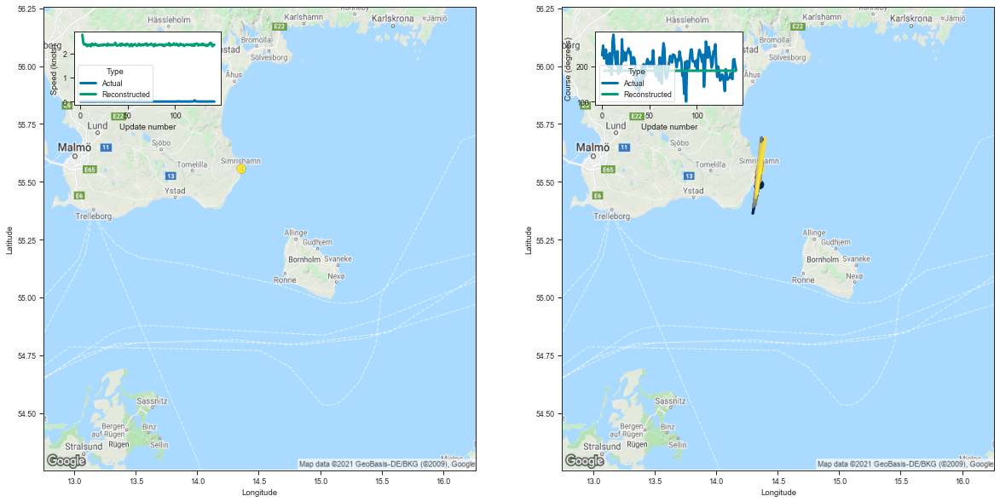

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.353415  55.487434  2.783307  186.713913         0.060589   
3    14.327657  55.437286  2.446986  186.735062         0.037582   
4    14.298187  55.363407  2.368887  186.382202         0.033754   
5    14.348950  55.523445  2.380093  186.910141         0.033925   
6    14.366284  55.591061  2.377976  187.138824         0.033654   
..         ...        ...       ...         ...              ...   
138  14.373493  55.608376  2.447007  187.575485         0.034573   
139  14.357484  55.553566  2.390851  187.226593         0.034068   
140  14.334081  55.479107  2.298774  186.639618         0.033460   
141  14.331562  55.446388  2.360877  186.697662         0.033466   
142  14.357979  55.555363  2.358530  187.093826         0.033241   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.149780     3.423352    100.264198                 1   
3          0.093240     3.247310    100.274780 

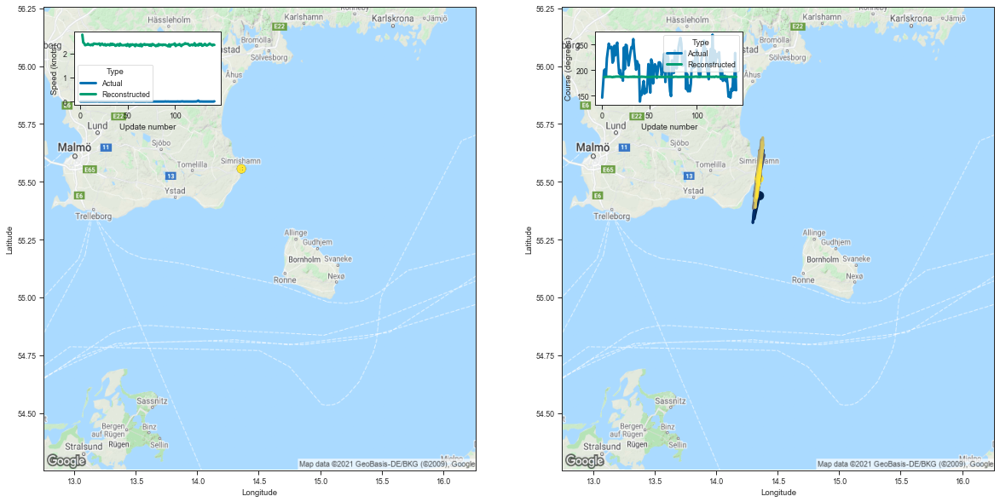

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.352864  55.439632  2.777540  186.545197         0.058667   
3    14.309557  55.338760  2.449499  186.459747         0.037595   
4    14.345048  55.541210  2.414082  187.251541         0.034880   
5    14.335319  55.528389  2.336624  186.917297         0.034191   
6    14.348975  55.584873  2.351164  187.082825         0.034113   
..         ...        ...       ...         ...              ...   
138  14.343131  55.531509  2.372625  187.128159         0.033339   
139  14.330523  55.430305  2.356462  186.645218         0.033757   
140  14.362020  55.573872  2.327396  187.035828         0.033228   
141  14.347300  55.483112  2.362720  186.870575         0.033911   
142  14.348307  55.513336  2.349969  186.975616         0.033842   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.142045     3.369885    100.144203                 1   
3          0.090451     3.237924    100.119484 

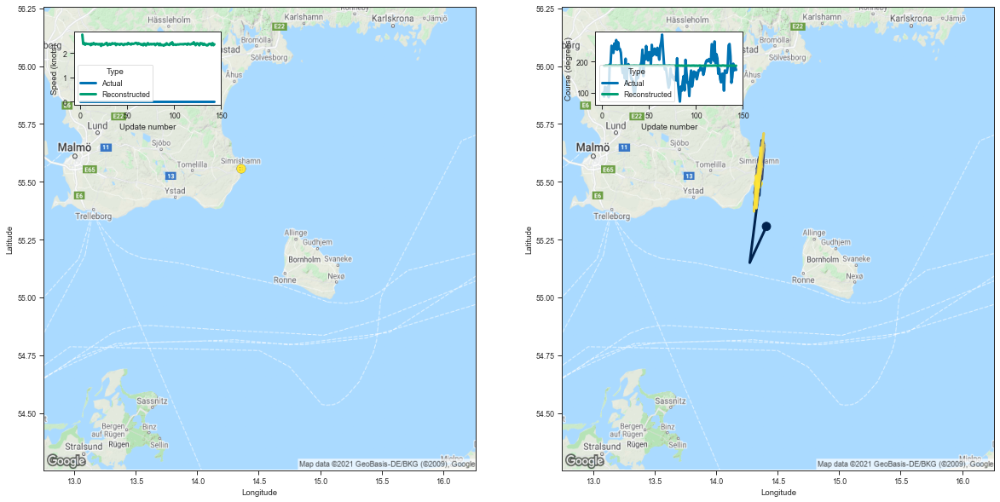

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.408915  55.306686  2.750961  186.165649         0.059269   
3    14.273562  55.150494  2.367850  185.636124         0.036301   
4    14.371658  55.564644  2.407670  187.225250         0.035394   
5    14.321296  55.421753  2.333247  186.556961         0.033114   
6    14.351666  55.523254  2.387289  187.109009         0.033618   
..         ...        ...       ...         ...              ...   
139  14.363781  55.647591  2.365762  187.521652         0.034436   
140  14.323390  55.389378  2.318828  186.424454         0.033955   
141  14.324814  55.524506  2.401727  187.142532         0.033638   
142  14.337405  55.473640  2.315207  186.585068         0.033263   
143  14.341713  55.492569  2.354590  186.763123         0.033392   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.144992     3.376328     99.973068                 1   
3          0.089122     3.167222     99.723755 

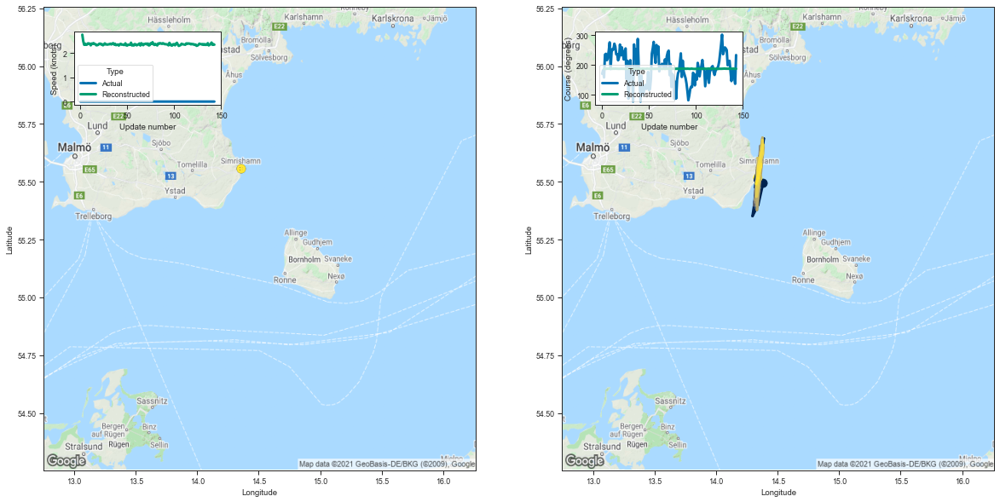

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.381943  55.493382  2.758900  186.447601         0.059696   
3    14.342628  55.400192  2.488493  186.894318         0.037913   
4    14.295910  55.351532  2.339868  186.336990         0.034231   
5    14.362404  55.587891  2.383359  187.227097         0.034567   
6    14.349824  55.573723  2.338863  187.043335         0.034415   
..         ...        ...       ...         ...              ...   
139  14.364881  55.578018  2.366247  187.111191         0.033520   
140  14.364715  55.565598  2.432711  187.296158         0.034528   
141  14.325800  55.490219  2.339507  186.744858         0.033224   
142  14.341860  55.515736  2.365591  186.961029         0.034166   
143  14.338729  55.516541  2.344470  186.772995         0.033133   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.148336     3.392795    100.118446                 1   
3          0.092643     3.251643    100.362602 

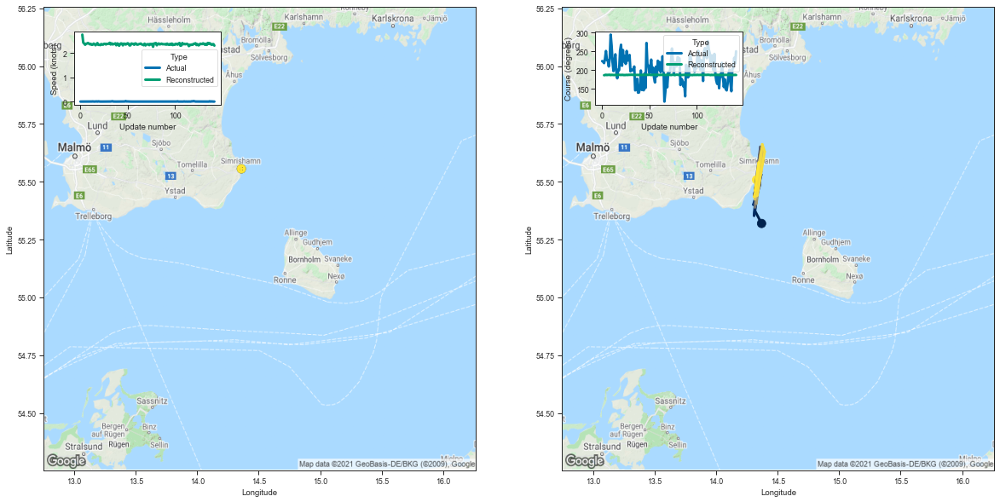

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.369587  55.319569  2.751715  186.111725         0.059637   
3    14.316027  55.373901  2.423805  186.590012         0.037691   
4    14.360600  55.602585  2.383955  187.338058         0.035074   
5    14.313416  55.447208  2.335416  186.565445         0.033133   
6    14.341885  55.551987  2.376574  187.042145         0.033660   
..         ...        ...       ...         ...              ...   
138  14.308561  55.434681  2.366876  186.696991         0.032897   
139  14.331222  55.480492  2.334410  186.722336         0.033770   
140  14.316799  55.461407  2.356539  186.721375         0.033416   
141  14.346192  55.582756  2.361291  187.131622         0.034614   
142  14.329294  55.508472  2.300259  186.642059         0.032619   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.144212     3.394407     99.927658                 1   
3          0.093407     3.217367    100.230751 

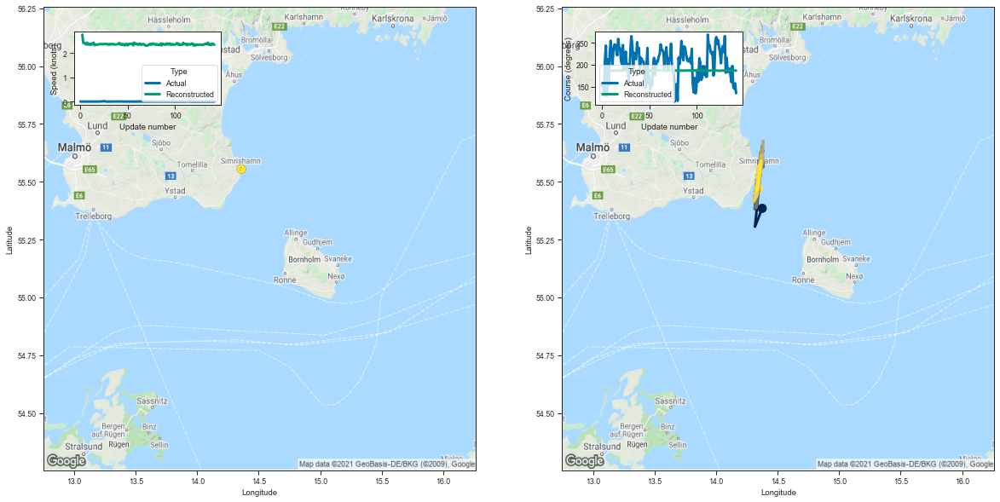

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.374718  55.384907  2.755774  186.299484         0.059935   
3    14.316081  55.306095  2.412971  186.246643         0.036786   
4    14.368338  55.583885  2.426461  187.265060         0.034575   
5    14.338524  55.512764  2.377417  187.042191         0.035191   
6    14.340144  55.476330  2.349046  186.916000         0.034040   
..         ...        ...       ...         ...              ...   
138  14.328293  55.456787  2.336502  186.671494         0.033007   
139  14.349001  55.537056  2.337169  186.874191         0.033782   
140  14.367112  55.590420  2.391493  187.290756         0.033747   
141  14.349212  55.505707  2.362855  186.997940         0.033873   
142  14.341957  55.469189  2.338610  186.744904         0.033229   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.146570     3.375719    100.036644                 1   
3          0.093437     3.201428    100.025795 

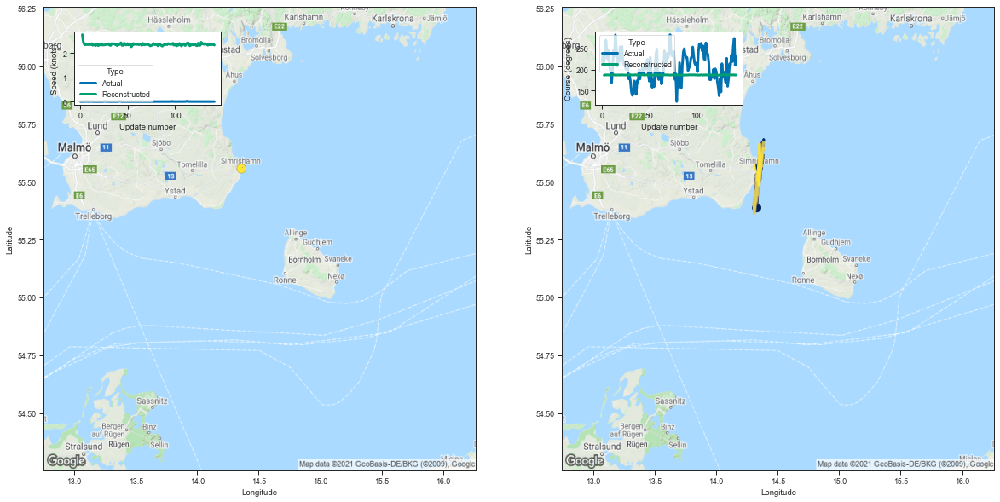

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.329753  55.387451  2.769945  186.299591         0.061014   
3    14.335835  55.493114  2.484377  187.198288         0.037359   
4    14.337352  55.545277  2.369314  187.003250         0.034930   
5    14.332090  55.570766  2.348242  187.092133         0.033894   
6    14.338737  55.570183  2.355991  187.120041         0.033477   
..         ...        ...       ...         ...              ...   
138  14.350494  55.511169  2.353426  186.979034         0.033399   
139  14.353788  55.663734  2.369642  187.438232         0.032814   
140  14.350228  55.532875  2.355457  186.885010         0.033418   
141  14.347613  55.486435  2.368029  186.857391         0.033109   
142  14.343929  55.560429  2.336983  186.907288         0.032408   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.147244     3.411023    100.020294                 1   
3          0.092488     3.279746    100.534729 

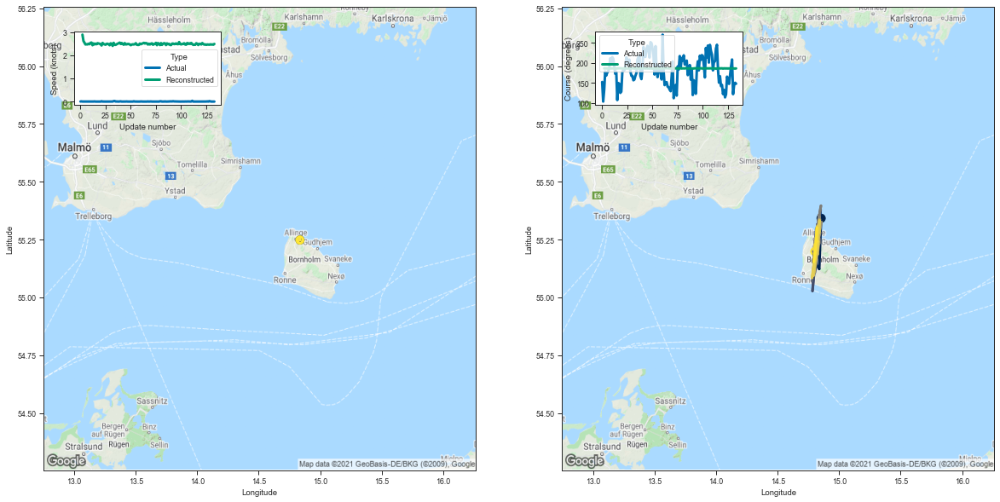

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.853580  55.341934  2.889128  186.389114         0.058844   
3    14.838436  55.122761  2.616907  186.349213         0.039285   
4    14.816536  55.140347  2.544005  186.229385         0.035538   
5    14.813160  55.208668  2.464300  186.256775         0.034444   
6    14.825766  55.239113  2.471974  186.416306         0.033953   
..         ...        ...       ...         ...              ...   
129  14.815755  55.245525  2.470401  186.355270         0.034286   
130  14.819412  55.301514  2.460822  186.526321         0.033822   
131  14.805240  55.191048  2.464997  186.061035         0.033401   
132  14.794304  55.153465  2.456034  186.023743         0.033466   
133  14.802593  55.198051  2.487165  186.300140         0.033817   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.144239     3.272288    100.104874                 1   
3          0.091230     3.111486    100.097229 

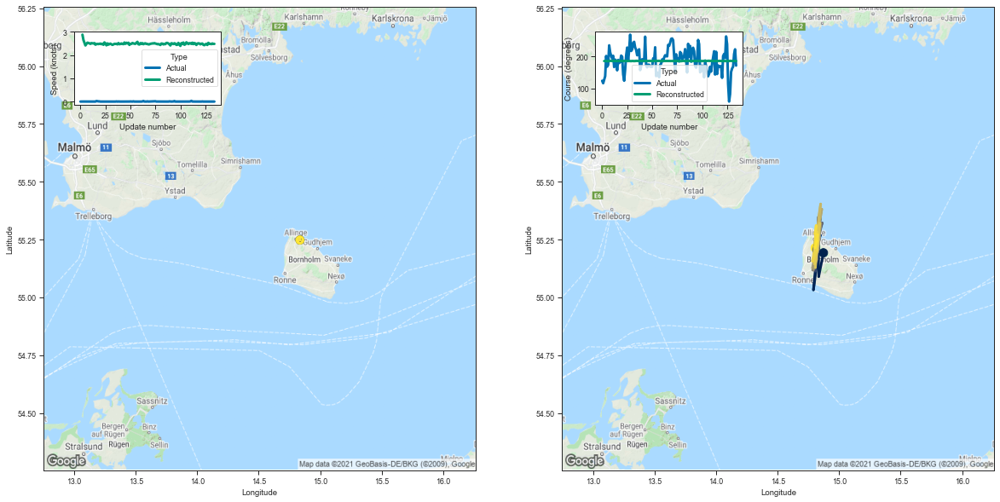

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.872373  55.192612  2.883233  186.173721         0.057539   
3    14.834119  55.089893  2.653306  186.461670         0.037815   
4    14.830872  55.256176  2.540705  186.757980         0.035776   
5    14.791233  55.032310  2.416939  185.506653         0.033980   
6    14.821031  55.151035  2.481587  186.114578         0.034271   
..         ...        ...       ...         ...              ...   
130  14.825111  55.270531  2.486051  186.492355         0.034457   
131  14.802922  55.219105  2.474856  186.446457         0.033997   
132  14.816238  55.240582  2.501360  186.362900         0.033637   
133  14.819970  55.243729  2.484319  186.464752         0.034095   
134  14.805189  55.214348  2.484316  186.403839         0.034630   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.140222     3.252547     99.996857                 1   
3          0.089763     3.105203    100.151894 

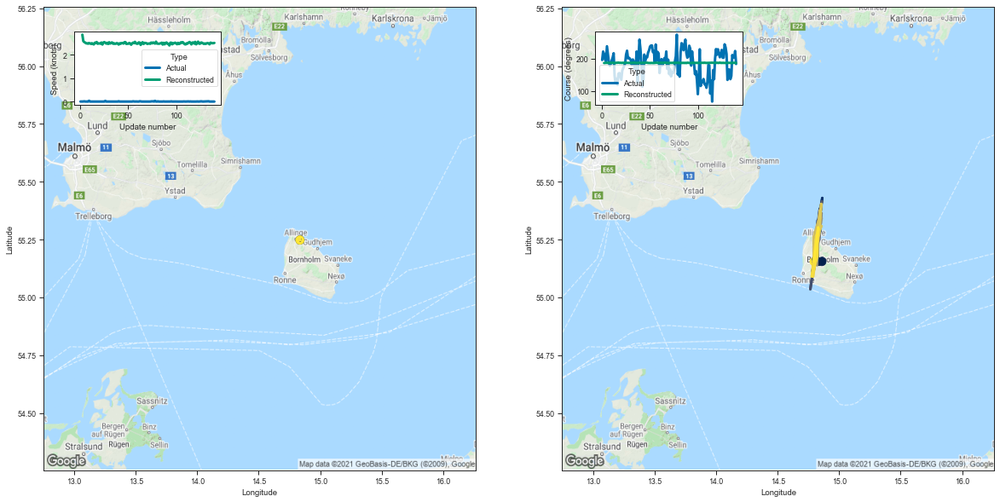

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.859460  55.155277  2.855841  185.919739         0.057873   
3    14.834589  55.141247  2.579339  186.234787         0.037558   
4    14.816213  55.222145  2.538711  186.478836         0.035603   
5    14.813828  55.222504  2.514328  186.426132         0.034389   
6    14.818393  55.196342  2.483945  186.381241         0.034632   
..         ...        ...       ...         ...              ...   
136  14.823218  55.177799  2.513544  186.340958         0.034429   
137  14.823378  55.236210  2.498647  186.419785         0.034368   
138  14.831634  55.292648  2.488369  186.658875         0.035464   
139  14.829290  55.302181  2.491976  186.618713         0.034062   
140  14.797480  55.154896  2.502176  186.163773         0.033622   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.140298     3.208253     99.869408                 1   
3          0.091024     3.088043    100.044891 

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
95,95,6805561,265759000,Fishing,143,-646.018066,-4.517609
60,60,6869996,265759000,Fishing,143,-646.617981,-4.521804
25,25,7292936,266054000,Fishing,144,-653.153381,-4.535787
44,44,7135380,266054000,Fishing,144,-653.224304,-4.536280
29,29,6787151,265759000,Fishing,143,-649.164612,-4.539613
74,74,6962046,265759000,Fishing,143,-649.797119,-4.544036
17,17,6685896,265759000,Fishing,143,-653.354919,-4.568916
20,20,1961288,230069190,Fishing,134,-614.648804,-4.586931
8,8,1943886,230069190,Fishing,135,-621.341492,-4.602530
70,70,2240973,230069190,Fishing,141,-652.895386,-4.630464


In [10]:
# Focus on the n best cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
    print(tracks['Reconstructed trajectory'])
df_n

# Worst Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_GMM3NEW_lr3e-05.pth


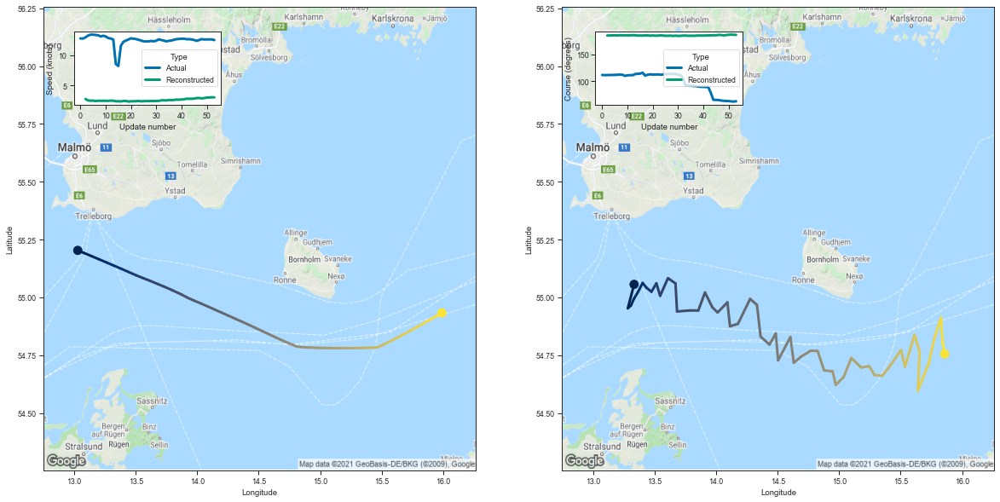

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   13.333229  55.056103  2.790843  185.187439         0.084375   
3   13.282476  54.952713  2.540639  185.441956         0.057076   
4   13.308414  54.965725  2.513998  185.558823         0.053021   
5   13.331307  54.993198  2.519654  185.679352         0.052335   
6   13.367609  55.025650  2.441815  185.445038         0.051603   
7   13.402527  55.062405  2.501314  185.871597         0.052771   
8   13.433858  55.041660  2.481553  185.746948         0.051059   
9   13.474315  55.024330  2.497729  185.651566         0.049840   
10  13.514534  55.060490  2.481794  185.721695         0.050639   
11  13.545047  55.006737  2.481508  185.656998         0.050252   
12  13.608614  55.082973  2.513390  185.993027         0.048242   
13  13.669973  55.060146  2.498992  185.880508         0.047293   
14  13.682527  54.939030  2.412495  185.177811         0.045256   
15  13.790433  54.943436  2.415963  185.270950         0.04136

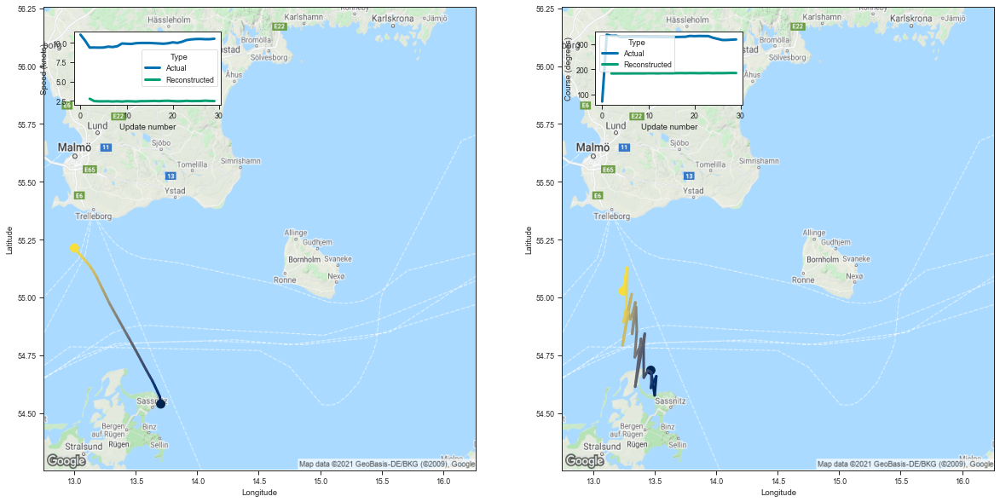

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   13.469399  54.684769  2.763443  183.908585         0.081170   
3   13.500658  54.576038  2.457323  184.014465         0.051042   
4   13.513704  54.658970  2.425664  184.253571         0.049863   
5   13.469440  54.608356  2.424638  184.070465         0.047705   
6   13.474681  54.630756  2.434491  184.139755         0.048040   
7   13.473325  54.675968  2.403905  184.340515         0.049122   
8   13.447539  54.684288  2.434167  184.323990         0.048812   
9   13.412031  54.652824  2.395377  184.150574         0.048437   
10  13.410357  54.787895  2.444993  184.716080         0.050431   
11  13.420117  54.842884  2.428977  184.760040         0.050369   
12  13.342160  54.613468  2.403051  184.151260         0.049307   
13  13.389622  54.820663  2.446922  184.871826         0.050534   
14  13.385777  54.792381  2.447906  184.731247         0.050365   
15  13.338573  54.740688  2.458532  184.666855         0.05075

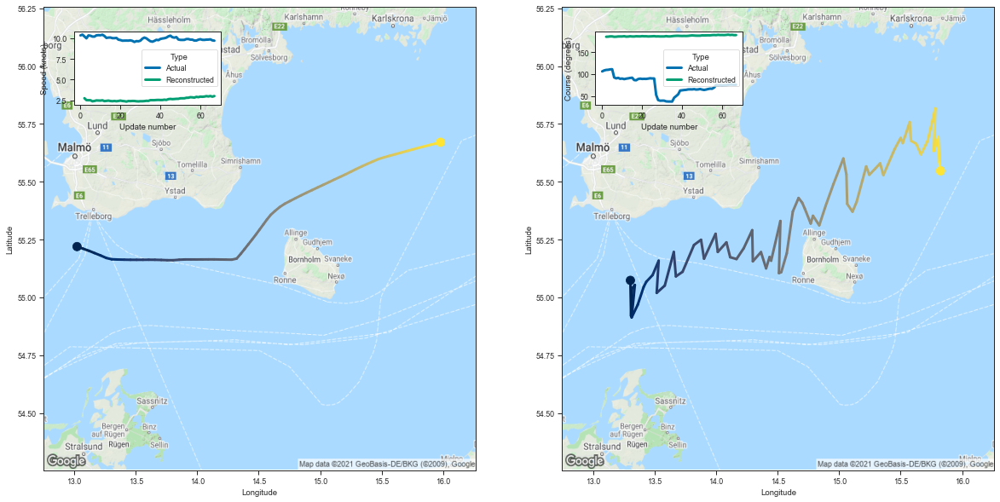

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   13.303175  55.073483  2.762128  185.063400         0.084251   
3   13.308703  54.919159  2.528653  185.298904         0.056970   
4   13.315843  55.037949  2.519220  185.887360         0.054731   
5   13.339525  55.053570  2.518946  185.861420         0.053075   
6   13.313304  54.913025  2.386773  184.984650         0.048896   
..        ...        ...       ...         ...              ...   
63  15.782331  55.817287  3.013553  189.910080         0.042878   
64  15.770114  55.632881  2.973147  189.118332         0.042075   
65  15.806313  55.693512  3.025861  189.497467         0.042685   
66  15.814925  55.585423  2.947402  188.815704         0.041385   
67  15.824374  55.547020  3.024016  188.906616         0.042016   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.184349     3.793842     99.253273                 1   
3         0.120380     3.680617     99.395348                

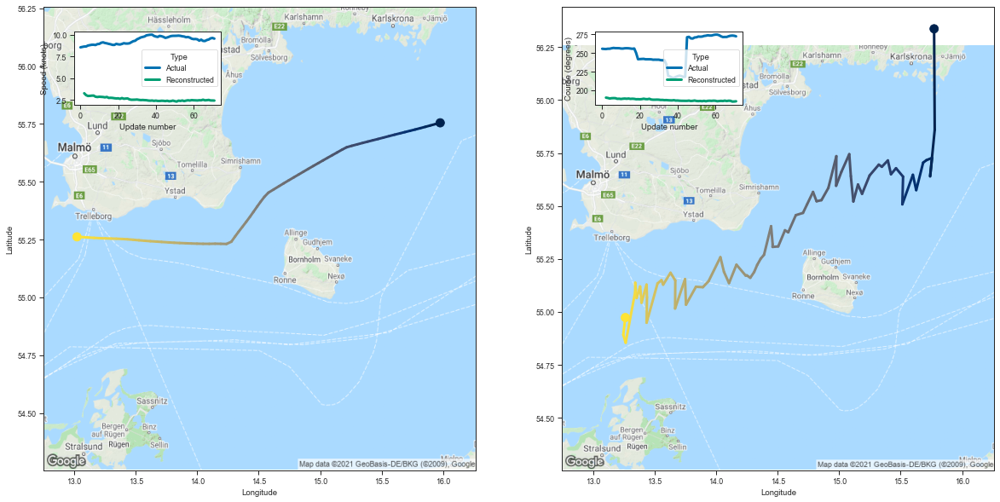

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.772171  56.336811  3.266090  190.203888         0.070431   
3   15.777229  55.859684  3.050177  189.747589         0.046385   
4   15.739884  55.640137  2.957180  189.023972         0.042002   
5   15.755692  55.727253  2.970909  189.423157         0.041836   
6   15.708707  55.716194  2.994197  189.547363         0.042176   
..        ...        ...       ...         ...              ...   
67  13.342912  55.137810  2.472046  186.040131         0.052233   
68  13.341456  55.092690  2.503322  185.951218         0.051971   
69  13.264855  54.854305  2.443218  184.910446         0.051579   
70  13.245309  54.892040  2.439287  185.014618         0.050385   
71  13.261939  54.973274  2.429488  185.309601         0.051702   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.170058     3.291987    102.172386                 1   
3         0.105897     3.134632    101.912971                

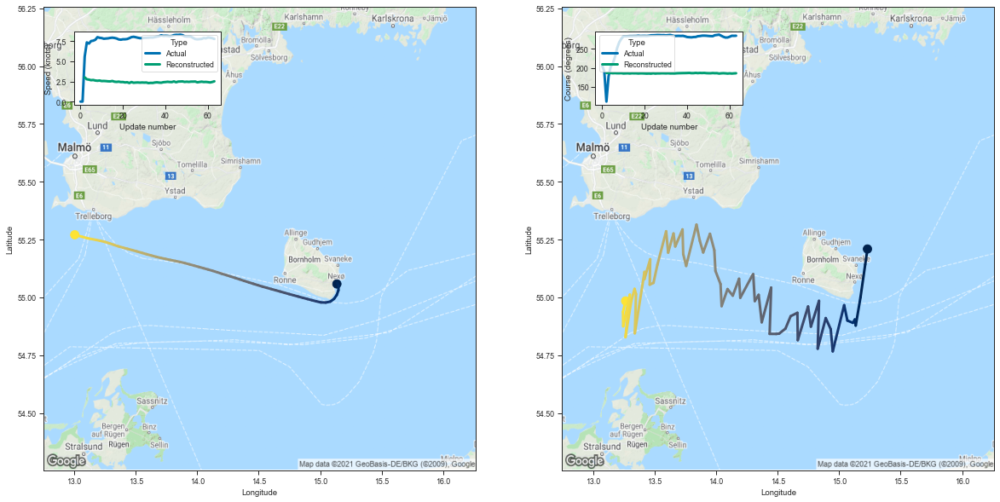

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.230444  55.209160  3.009653  186.397156         0.061339   
3   15.211891  55.141338  2.770442  186.852020         0.041265   
4   15.173761  55.000019  2.725614  186.306168         0.038611   
5   15.135057  54.877972  2.655902  185.707321         0.037520   
6   15.128135  54.904453  2.679938  185.972504         0.037549   
..        ...        ...       ...         ...              ...   
59  13.263229  54.827835  2.442310  184.804489         0.050310   
60  13.298819  55.011547  2.416798  185.328857         0.050781   
61  13.244880  54.874760  2.374981  184.811584         0.050301   
62  13.242813  54.936962  2.434313  185.279007         0.050691   
63  13.264637  54.984486  2.518008  185.637253         0.051939   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.148970     3.179128    100.145103                 1   
3         0.098115     3.102514    100.373405                

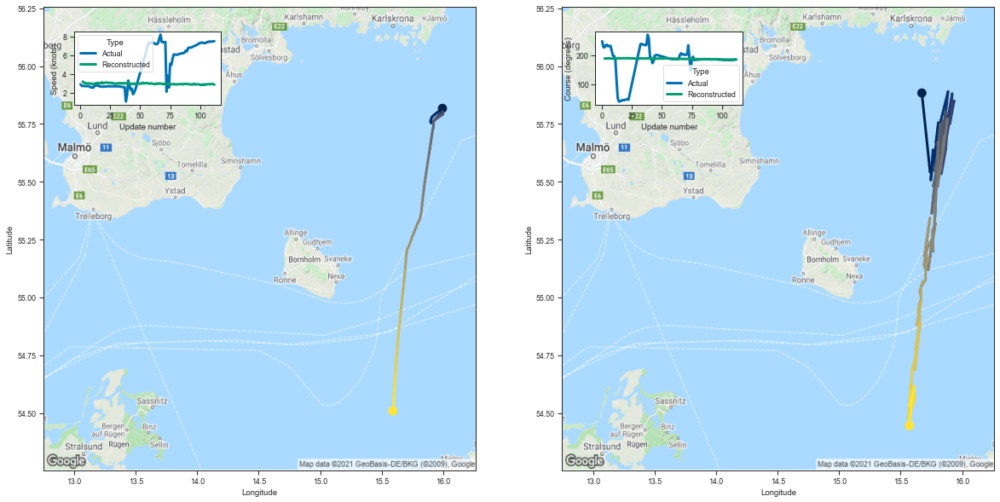

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.672514  55.883862  3.176346  188.818283         0.067322   
3    15.739629  55.541557  3.037741  189.065582         0.044954   
4    15.802123  55.636192  3.009495  189.197495         0.041596   
5    15.787385  55.671612  2.973495  189.191757         0.040342   
6    15.806891  55.755539  2.980260  189.604828         0.040032   
..         ...        ...       ...         ...              ...   
108  15.608724  54.615406  2.887106  185.569321         0.042174   
109  15.568328  54.529202  2.886064  185.323257         0.041750   
110  15.609620  54.599854  2.922407  185.654572         0.042390   
111  15.593441  54.565578  2.906003  185.466721         0.041939   
112  15.571688  54.445297  2.839841  184.859436         0.041441   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.157456     3.238524    101.431877                 1   
3          0.101398     3.132452    101.573235 

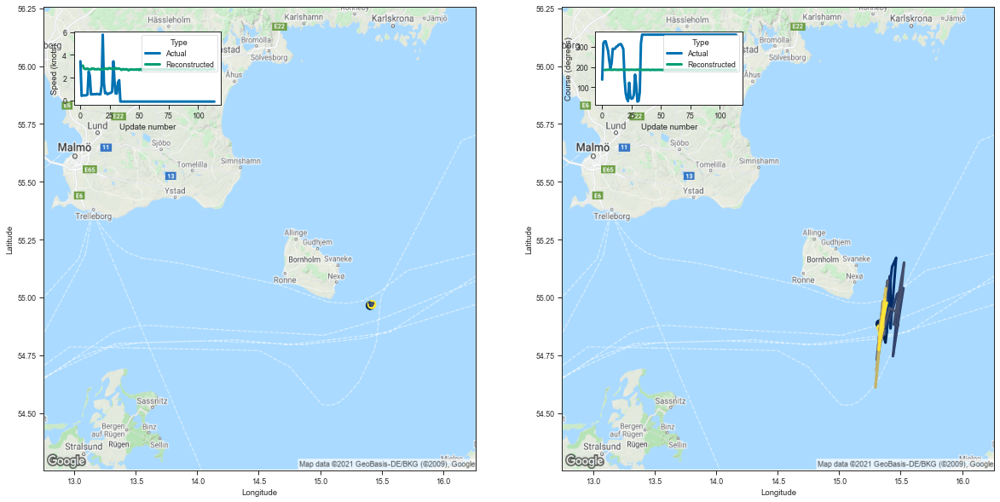

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.332306  54.885345  3.064934  185.465729         0.062772   
3    15.377220  54.804790  2.805324  185.907257         0.042067   
4    15.420134  55.006519  2.757077  186.430481         0.039457   
5    15.410533  55.031197  2.751798  186.520676         0.038214   
6    15.417981  55.086815  2.796625  186.923691         0.038942   
..         ...        ...       ...         ...              ...   
110  15.370291  54.991440  2.737731  186.464706         0.038693   
111  15.322052  54.772499  2.716773  185.476868         0.037137   
112  15.349602  54.912548  2.746360  186.025787         0.037580   
113  15.387009  54.976772  2.751728  186.256607         0.037592   
114  15.341369  54.868629  2.713590  185.891800         0.038112   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.147752     3.161017     99.625397                 1   
3          0.093007     2.993018     99.884033 

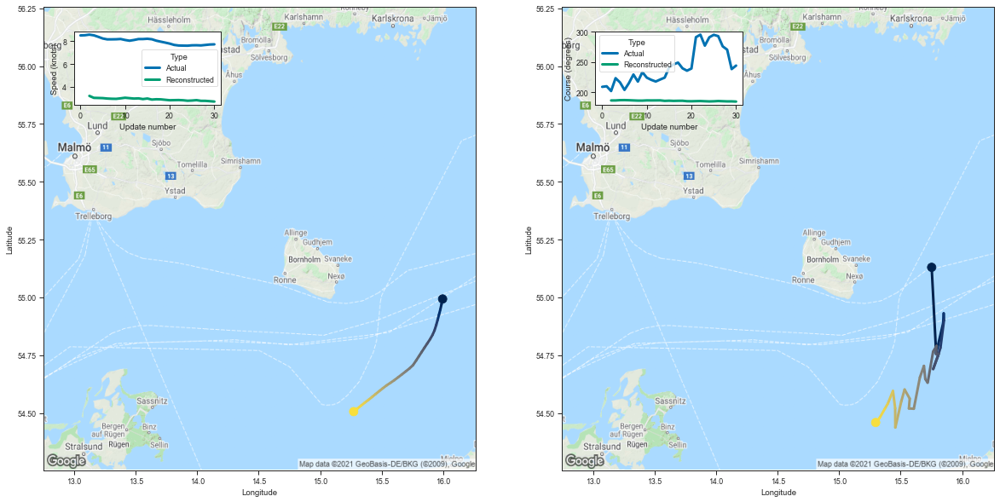

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.752270  55.129910  3.218140  186.402054         0.071974   
3   15.788704  54.757961  3.047271  186.418106         0.048014   
4   15.845826  54.888355  3.036874  186.889801         0.044049   
5   15.850153  54.930698  3.024674  186.988251         0.044711   
6   15.852660  54.901047  2.988174  186.763809         0.044029   
7   15.823768  54.781792  2.968364  186.449326         0.043983   
8   15.802639  54.745724  2.960527  186.139481         0.042866   
9   15.764510  54.689941  3.005001  186.125015         0.044134   
10  15.810062  54.756470  3.056325  186.504059         0.043478   
11  15.788395  54.754780  3.019639  186.427155         0.043686   
12  15.792358  54.790462  2.985443  186.474777         0.043870   
13  15.763963  54.764912  3.002518  186.530365         0.044218   
14  15.722662  54.638947  2.940474  185.718201         0.042660   
15  15.719269  54.631172  2.989686  185.999863         0.04275

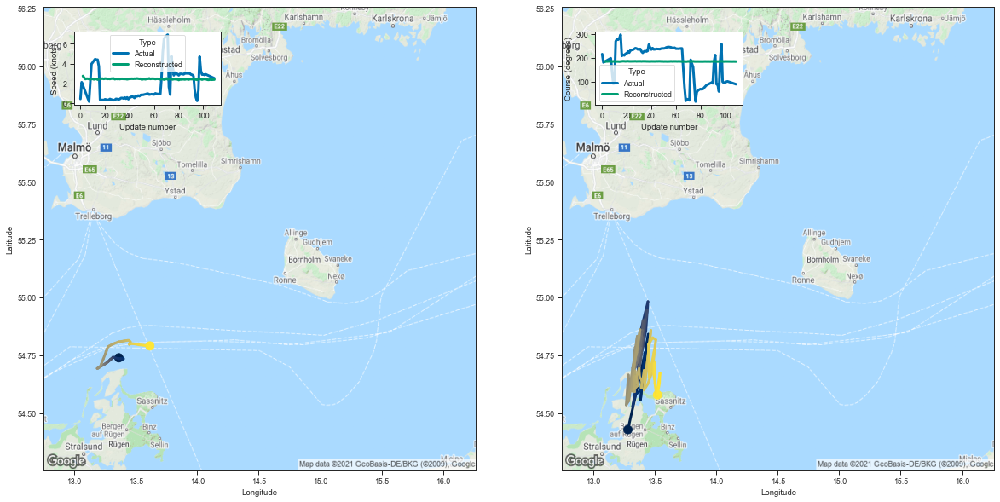

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    13.282796  54.427753  2.732882  183.275635         0.075866   
3    13.411804  54.734097  2.559024  184.899109         0.053735   
4    13.404108  54.657829  2.421703  184.261276         0.049436   
5    13.432911  54.770641  2.458711  184.768326         0.051074   
6    13.433476  54.797600  2.458451  184.910034         0.048819   
..         ...        ...       ...         ...              ...   
105  13.502047  54.629749  2.353112  184.038651         0.046951   
106  13.515178  54.575054  2.375714  183.988815         0.045664   
107  13.543926  54.673779  2.352550  184.220520         0.045764   
108  13.539559  54.628559  2.365223  184.063370         0.045024   
109  13.523501  54.578510  2.367228  183.859100         0.044735   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.161721     3.679440     98.301422                 1   
3          0.112919     3.628469     99.180077 

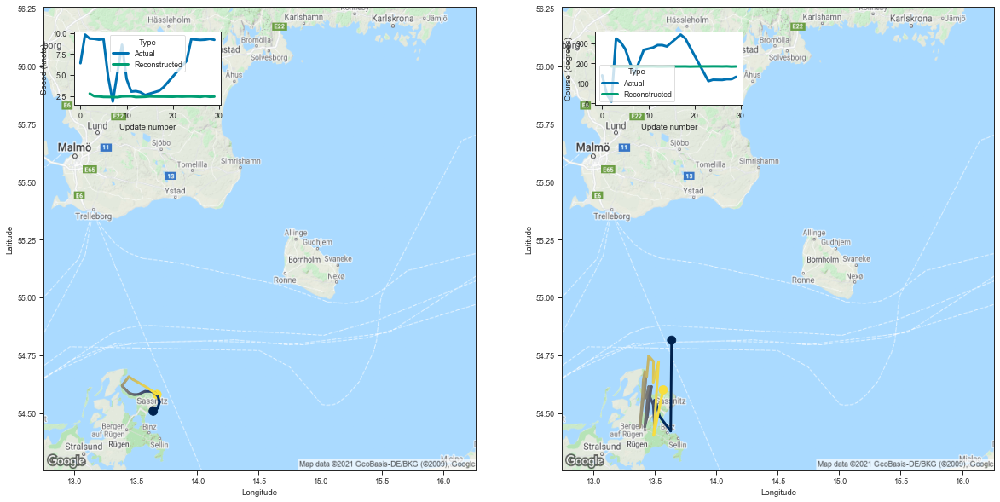

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   13.638245  54.814697  2.780065  184.280472         0.080305   
3   13.630727  54.422066  2.465996  183.602371         0.050337   
4   13.540218  54.485016  2.439307  183.810745         0.046687   
5   13.513862  54.537903  2.378411  183.785294         0.047009   
6   13.498199  54.522808  2.372534  183.619431         0.047043   
7   13.499187  54.554695  2.362998  183.727402         0.047424   
8   13.501590  54.420963  2.349552  183.317169         0.045867   
9   13.489422  54.535877  2.439158  184.002396         0.046897   
10  13.447920  54.585949  2.455126  184.079498         0.048492   
11  13.474493  54.614300  2.458609  184.327850         0.048154   
12  13.440044  54.482986  2.364554  183.487473         0.046509   
13  13.419264  54.439163  2.376301  183.455688         0.047937   
14  13.451912  54.613865  2.394670  183.954926         0.048628   
15  13.448543  54.606030  2.443047  184.267120         0.04954

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
36,36,7969192,273352230,Fishing,54,-619.635498,-11.474731
101,101,1176042,211755650,Fishing,30,-331.279083,-11.042636
97,97,7993496,273513600,Fishing,68,-574.921021,-8.454721
6,6,7960421,273294000,Fishing,72,-586.102295,-8.140310
37,37,1615516,220339000,Fishing,64,-514.016479,-8.031507
33,33,4352040,261015270,Fishing,113,-875.736206,-7.749878
56,56,4380691,261017210,Fishing,115,-890.177734,-7.740676
1,1,4547326,261061000,Fishing,31,-234.565384,-7.566625
21,21,19488,211243240,Fishing,110,-808.783508,-7.352577
73,73,1113112,211542610,Fishing,30,-214.329697,-7.144323


In [11]:
# Focus on the n worst cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=True)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
    #print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
    print(tracks['Reconstructed trajectory'])
df_n

# Best 100 Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_GMM3NEW_lr3e-05.pth


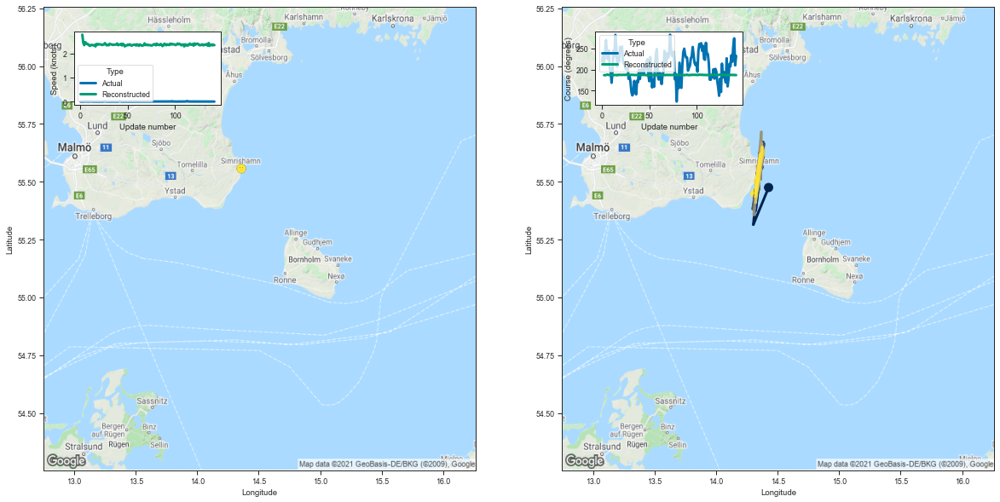

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.426680  55.475025  2.776388  186.620575         0.059701   
3    14.302717  55.314556  2.443975  186.436813         0.037235   
4    14.340917  55.531750  2.339929  186.826447         0.034574   
5    14.383925  55.634014  2.466852  187.786835         0.035147   
6    14.368154  55.663033  2.421041  187.655563         0.034136   
..         ...        ...       ...         ...              ...   
138  14.336608  55.507938  2.354354  186.903427         0.033117   
139  14.360781  55.619926  2.364922  187.317291         0.033135   
140  14.326693  55.514389  2.329147  186.805328         0.033083   
141  14.340404  55.510361  2.363757  186.862396         0.034266   
142  14.316215  55.449203  2.338084  186.641022         0.033731   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.147572     3.382327    100.210556                 1   
3          0.089643     3.219879    100.124252 

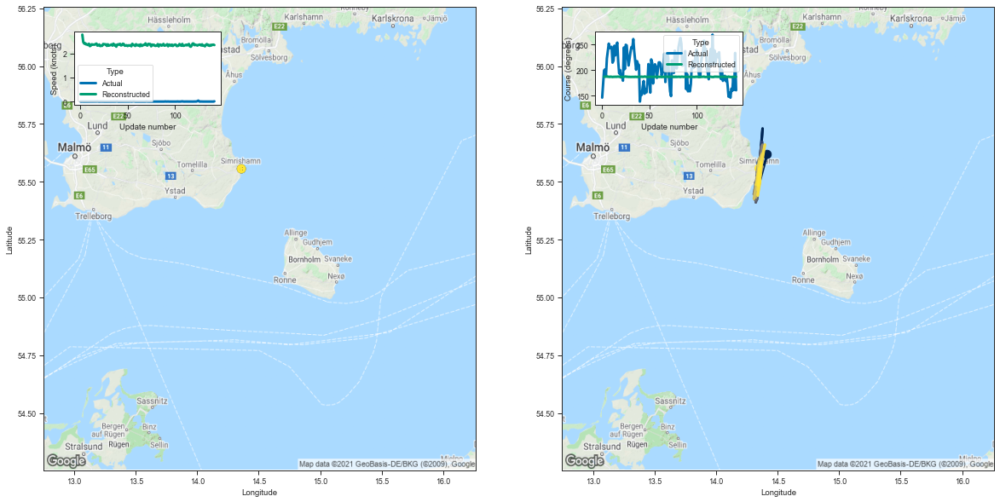

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.414622  55.618252  2.789287  187.106400         0.061273   
3    14.340618  55.474209  2.481322  187.147583         0.037292   
4    14.352689  55.552067  2.415909  187.241119         0.034938   
5    14.377798  55.729832  2.429018  187.932755         0.034463   
6    14.350326  55.560722  2.381132  187.104492         0.033553   
..         ...        ...       ...         ...              ...   
138  14.357678  55.497784  2.360706  186.931061         0.034245   
139  14.361590  55.563522  2.342178  187.045914         0.033447   
140  14.364804  55.584209  2.367416  187.151047         0.033438   
141  14.343318  55.482327  2.371310  186.840805         0.033359   
142  14.350122  55.557705  2.355454  187.102814         0.034161   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.150639     3.416212    100.455460                 1   
3          0.092627     3.250220    100.513901 

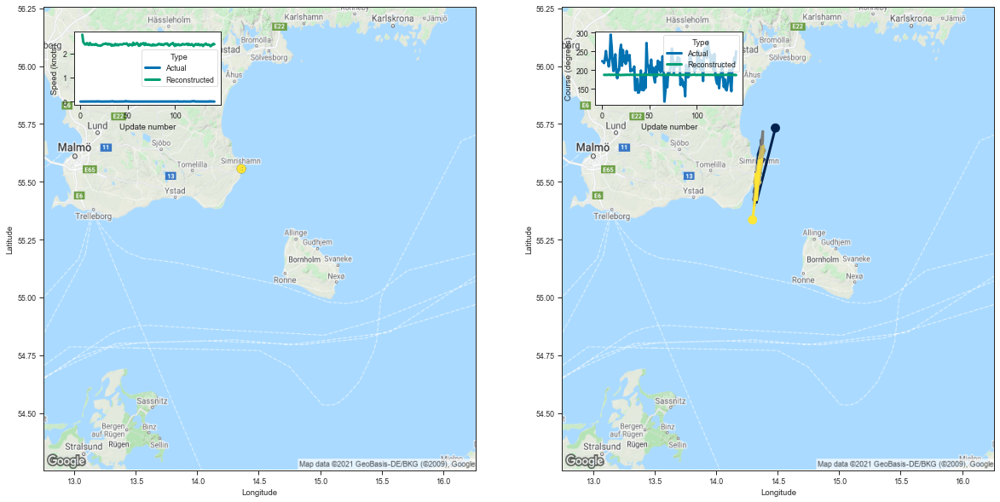

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.482035  55.732456  2.772014  187.231552         0.060690   
3    14.327093  55.410282  2.468214  186.800995         0.036731   
4    14.338295  55.534813  2.407343  187.192368         0.035154   
5    14.323009  55.511211  2.363706  186.955658         0.033923   
6    14.326133  55.511829  2.367276  187.028397         0.033759   
..         ...        ...       ...         ...              ...   
138  14.333474  55.475163  2.291047  186.539444         0.032968   
139  14.321649  55.533371  2.345059  186.903275         0.033345   
140  14.329897  55.421959  2.343683  186.620361         0.033645   
141  14.352660  55.592037  2.394220  187.279114         0.033687   
142  14.296350  55.335232  2.372108  186.329605         0.032941   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.152753     3.413996    100.539764                 1   
3          0.090269     3.225245    100.294563 

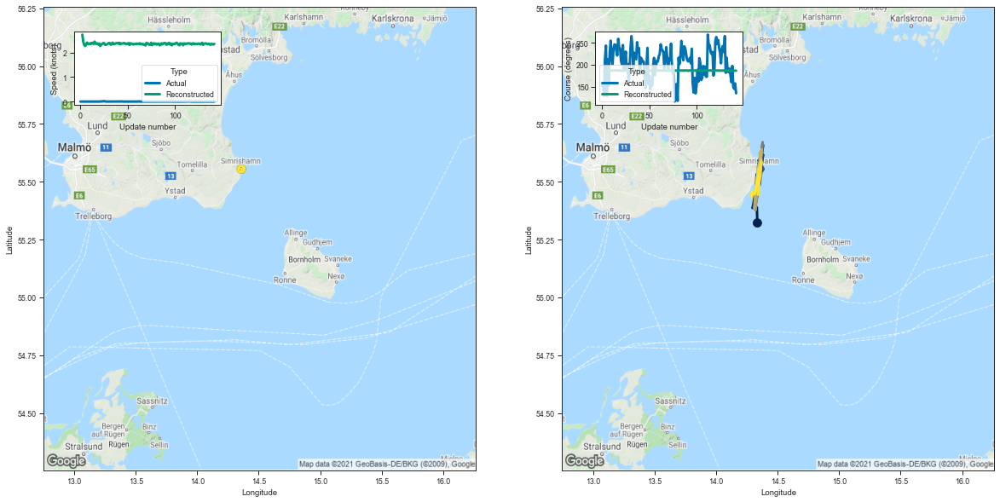

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.335482  55.321758  2.737952  185.974548         0.058717   
3    14.331353  55.387066  2.449941  186.577576         0.036400   
4    14.318504  55.396454  2.319346  186.274368         0.034155   
5    14.296880  55.386623  2.275140  186.103531         0.032248   
6    14.362465  55.578922  2.337773  187.098236         0.033834   
..         ...        ...       ...         ...              ...   
138  14.319154  55.462315  2.327987  186.700378         0.033371   
139  14.346125  55.456547  2.364080  186.748276         0.033569   
140  14.345524  55.492641  2.342398  186.790558         0.033015   
141  14.341506  55.522114  2.334619  186.827484         0.033246   
142  14.313027  55.445721  2.358619  186.720520         0.033595   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.144222     3.389774     99.871323                 1   
3          0.089606     3.257597    100.203140 

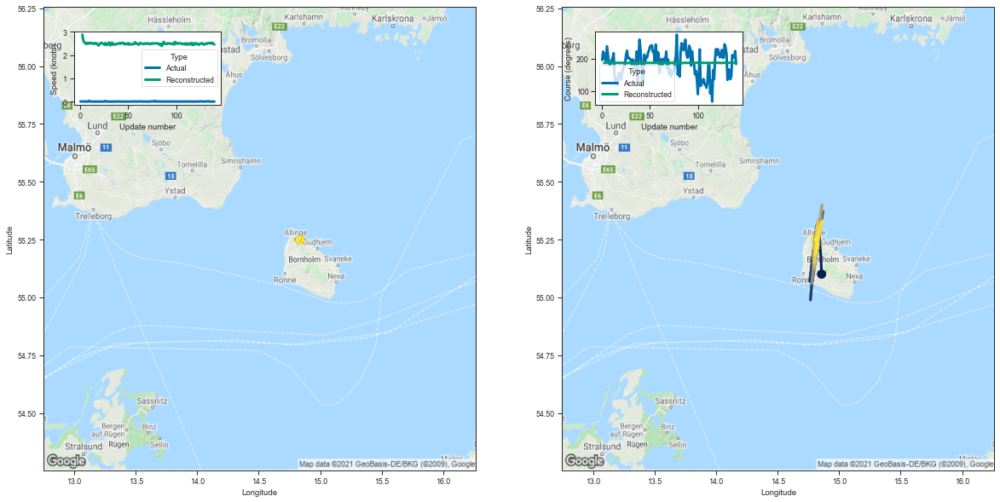

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.857546  55.100517  2.874083  185.857880         0.059198   
3    14.851403  55.177578  2.629354  186.689713         0.039120   
4    14.839792  55.257641  2.540367  186.651505         0.035675   
5    14.831633  55.287445  2.507224  186.661636         0.034482   
6    14.803508  55.237064  2.473275  186.401138         0.034652   
..         ...        ...       ...         ...              ...   
136  14.828003  55.264954  2.518940  186.556381         0.035087   
137  14.809873  55.188286  2.487035  186.246689         0.034708   
138  14.827436  55.231884  2.524990  186.488937         0.033899   
139  14.819375  55.205166  2.483764  186.306213         0.033896   
140  14.815405  55.254589  2.452446  186.296051         0.033265   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.141566     3.239122     99.829720                 1   
3          0.090459     3.128510    100.275330 

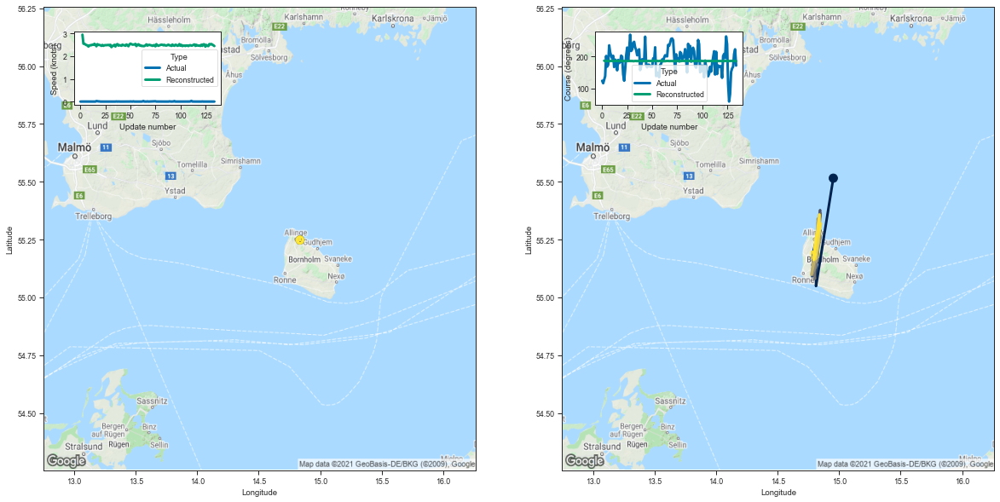

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.952631  55.515438  2.952156  187.286377         0.061432   
3    14.812356  55.049435  2.551952  185.872665         0.038155   
4    14.811784  55.205421  2.547781  186.477783         0.036451   
5    14.839616  55.242733  2.516393  186.588928         0.035002   
6    14.802222  55.184669  2.491358  186.321182         0.034771   
..         ...        ...       ...         ...              ...   
130  14.839455  55.357655  2.524395  186.894073         0.034698   
131  14.842313  55.296104  2.537621  186.753784         0.034411   
132  14.809434  55.254673  2.511616  186.574417         0.034569   
133  14.792684  55.162067  2.481643  186.109039         0.033481   
134  14.805408  55.187267  2.449006  186.159714         0.034749   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.145467     3.301444    100.577446                 1   
3          0.089882     3.092453     99.855522 

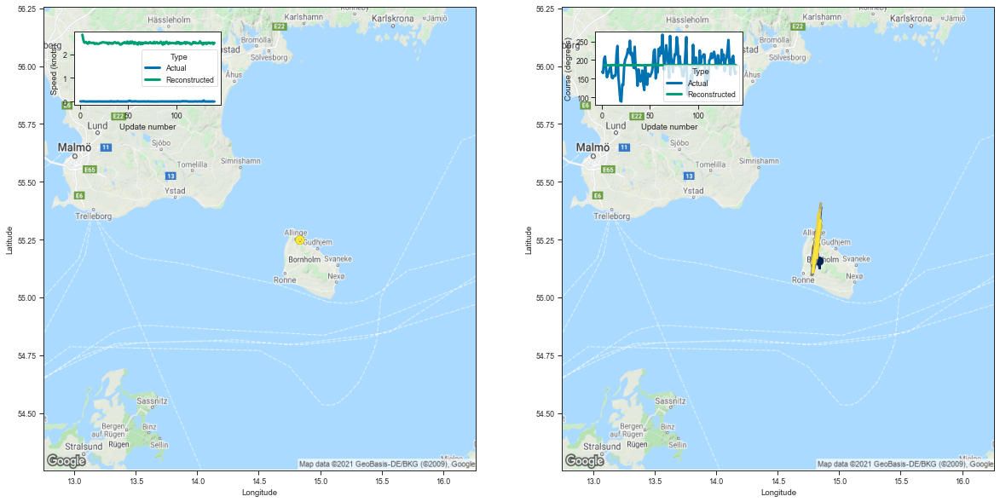

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.837729  55.156452  2.840232  185.850571         0.056140   
3    14.842463  55.126053  2.627374  186.375229         0.037449   
4    14.822685  55.181564  2.500660  186.358063         0.035879   
5    14.808063  55.219463  2.503658  186.383209         0.034328   
6    14.825442  55.256817  2.523683  186.494415         0.034099   
..         ...        ...       ...         ...              ...   
136  14.816704  55.244556  2.463311  186.380875         0.034824   
137  14.831901  55.273178  2.482835  186.400238         0.033850   
138  14.847840  55.332634  2.502547  186.780716         0.034749   
139  14.786849  55.107845  2.436447  185.827744         0.033965   
140  14.809635  55.214737  2.494161  186.336105         0.034105   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.139465     3.236865     99.821724                 1   
3          0.089023     3.090515    100.110832 

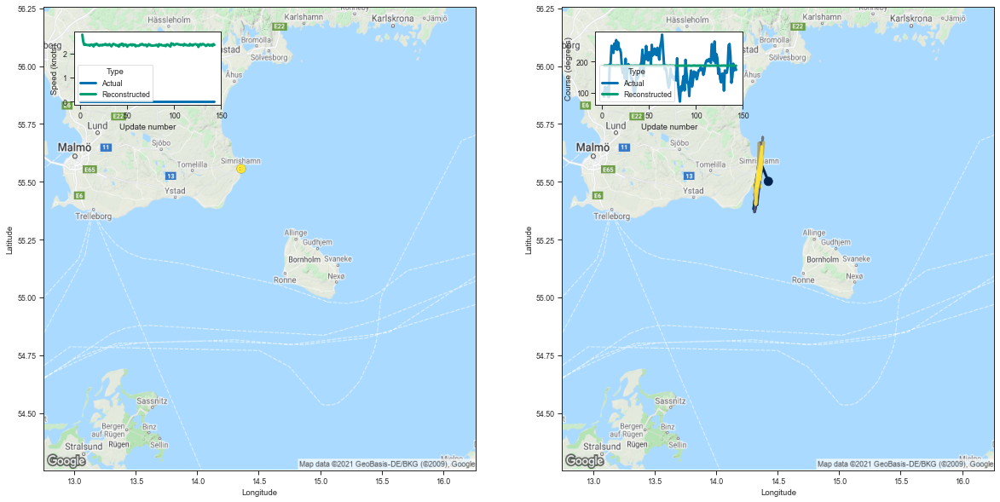

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.424641  55.501564  2.785985  186.680359         0.059112   
3    14.375952  55.565880  2.490495  187.376007         0.038465   
4    14.314764  55.371025  2.362837  186.572952         0.034902   
5    14.366537  55.634731  2.388515  187.465454         0.034531   
6    14.366458  55.650745  2.365417  187.521957         0.034881   
..         ...        ...       ...         ...              ...   
139  14.372222  55.652443  2.352025  187.374039         0.033994   
140  14.359994  55.511532  2.361953  186.906235         0.033960   
141  14.335998  55.545235  2.318456  186.889862         0.033022   
142  14.336410  55.483486  2.392835  186.899246         0.033240   
143  14.331156  55.480946  2.356697  186.809616         0.033130   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.144598     3.389096    100.236115                 1   
3          0.093047     3.283345    100.620049 

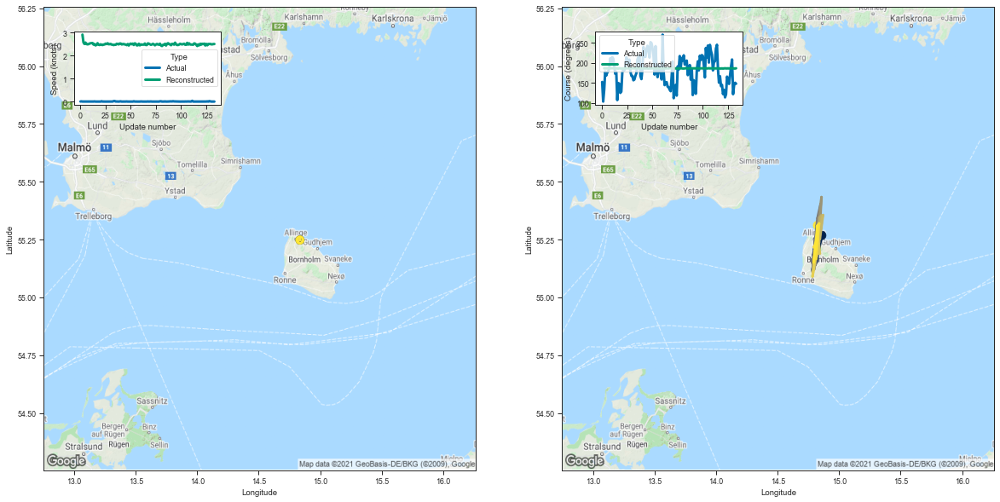

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.858698  55.267860  2.910403  186.497437         0.059963   
3    14.817721  55.153217  2.574956  186.434769         0.038143   
4    14.820009  55.231720  2.504837  186.449539         0.034845   
5    14.825451  55.238049  2.563734  186.664124         0.034572   
6    14.826762  55.281567  2.500704  186.615356         0.034246   
..         ...        ...       ...         ...              ...   
129  14.825439  55.277679  2.505922  186.651825         0.034248   
130  14.824543  55.250011  2.487845  186.477020         0.034298   
131  14.792982  55.151474  2.489728  186.094131         0.032351   
132  14.794106  55.159977  2.499786  186.136902         0.033605   
133  14.824501  55.311241  2.502548  186.620193         0.034107   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.144144     3.283761    100.167183                 1   
3          0.091366     3.084533    100.153572 

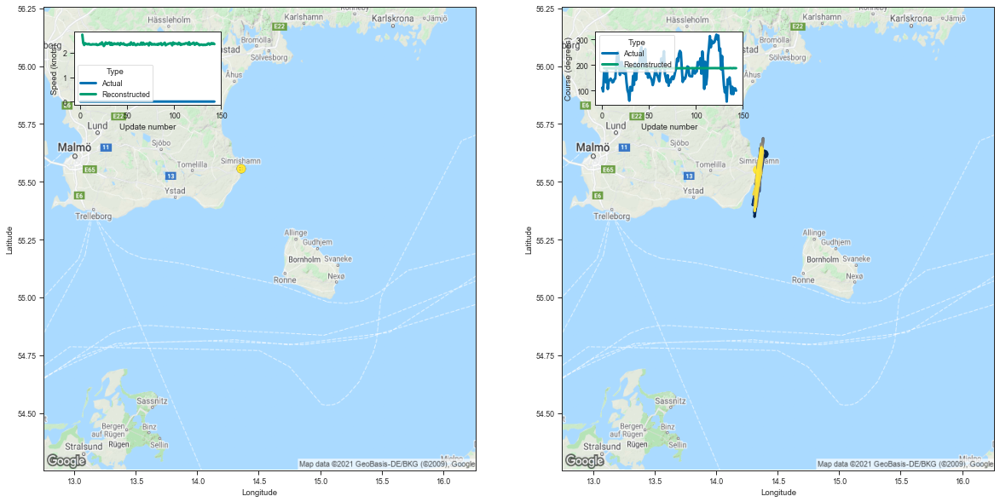

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.389137  55.619396  2.747885  186.964142         0.060370   
3    14.312486  55.349335  2.406169  186.420288         0.037139   
4    14.319715  55.433117  2.320252  186.560501         0.033880   
5    14.375204  55.618938  2.396432  187.356094         0.034734   
6    14.334875  55.513851  2.368156  187.025375         0.034621   
..         ...        ...       ...         ...              ...   
139  14.313760  55.374168  2.357301  186.528091         0.033739   
140  14.367425  55.648155  2.400751  187.500107         0.034516   
141  14.341553  55.557350  2.367674  187.110519         0.033648   
142  14.330602  55.500736  2.390877  187.018356         0.033490   
143  14.336729  55.550972  2.359011  187.095047         0.033318   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.147827     3.394331    100.390739                 1   
3          0.092770     3.194861    100.137238 

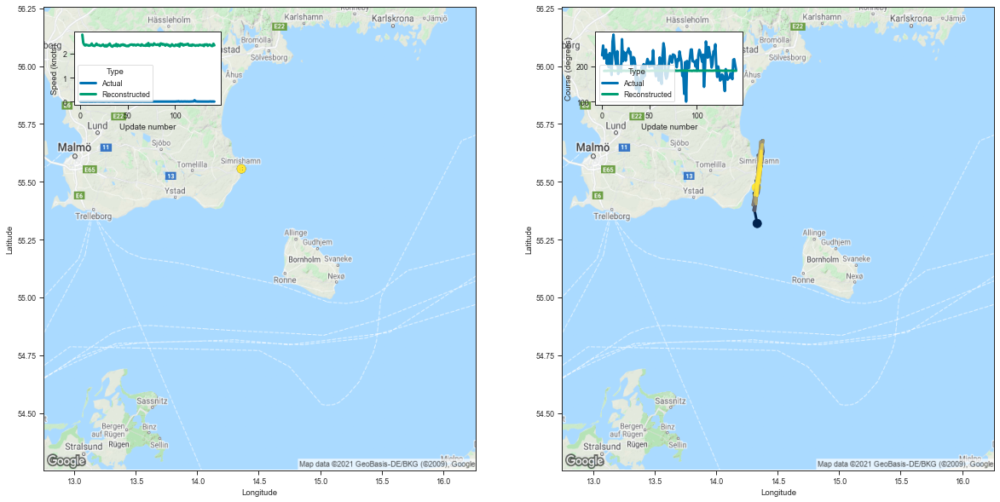

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.334128  55.319458  2.796364  186.333420         0.059341   
3    14.314375  55.370865  2.456308  186.795654         0.038139   
4    14.307554  55.451096  2.375094  186.765137         0.035473   
5    14.312692  55.400566  2.339478  186.503204         0.033195   
6    14.346099  55.539696  2.380435  187.089478         0.033298   
..         ...        ...       ...         ...              ...   
138  14.367005  55.612534  2.355583  187.201035         0.034089   
139  14.332823  55.439568  2.323701  186.592697         0.033514   
140  14.324653  55.488194  2.319964  186.746445         0.032542   
141  14.365981  55.562782  2.415635  187.291687         0.033743   
142  14.327242  55.475388  2.349356  186.812225         0.033977   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.143970     3.386088    100.031715                 1   
3          0.092100     3.224443    100.314384 

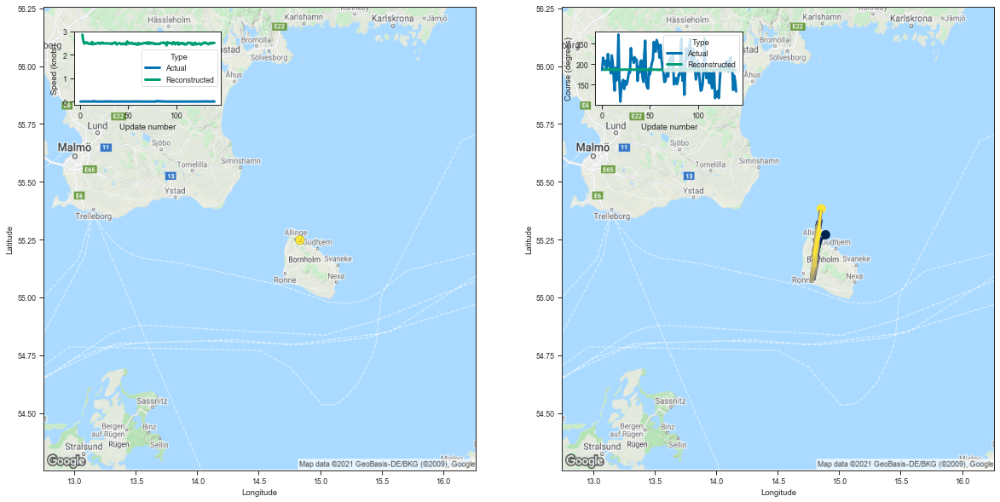

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.890291  55.270874  2.860987  186.288147         0.058305   
3    14.852651  55.247978  2.593837  186.687180         0.038595   
4    14.808161  55.144440  2.474263  186.011581         0.033789   
5    14.830586  55.244236  2.532185  186.579514         0.034574   
6    14.839312  55.334534  2.517015  186.866028         0.034877   
..         ...        ...       ...         ...              ...   
136  14.805927  55.188011  2.501198  186.338394         0.033935   
137  14.797043  55.196007  2.479153  186.257782         0.034054   
138  14.842376  55.282940  2.515457  186.665146         0.033840   
139  14.819016  55.237156  2.497610  186.465698         0.034377   
140  14.854555  55.383141  2.510894  186.846100         0.035079   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.141794     3.259336    100.068611                 1   
3          0.090806     3.099134    100.289299 

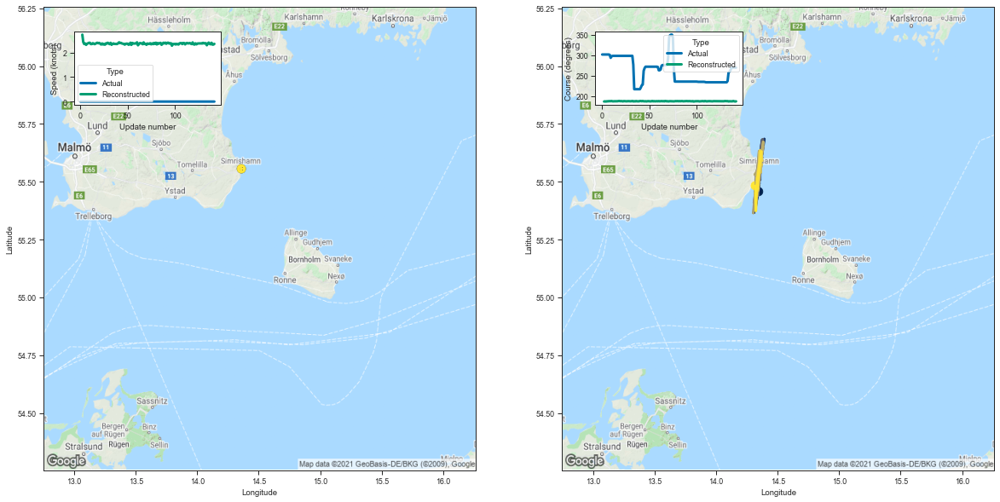

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.345357  55.457432  2.728885  186.331757         0.058590   
3    14.308160  55.366600  2.425228  186.601883         0.037065   
4    14.311632  55.374287  2.347005  186.318283         0.034143   
5    14.334775  55.482861  2.367639  186.784668         0.033851   
6    14.340049  55.512852  2.312317  186.812454         0.034038   
..         ...        ...       ...         ...              ...   
138  14.331614  55.478413  2.334074  186.723846         0.033591   
139  14.367762  55.630440  2.396916  187.539352         0.034491   
140  14.334710  55.504120  2.321358  186.845703         0.033631   
141  14.323197  55.374367  2.324469  186.401123         0.033443   
142  14.318392  55.482620  2.352478  186.732391         0.032782   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.145163     3.363924    100.045525                 1   
3          0.092905     3.216694    100.222038 

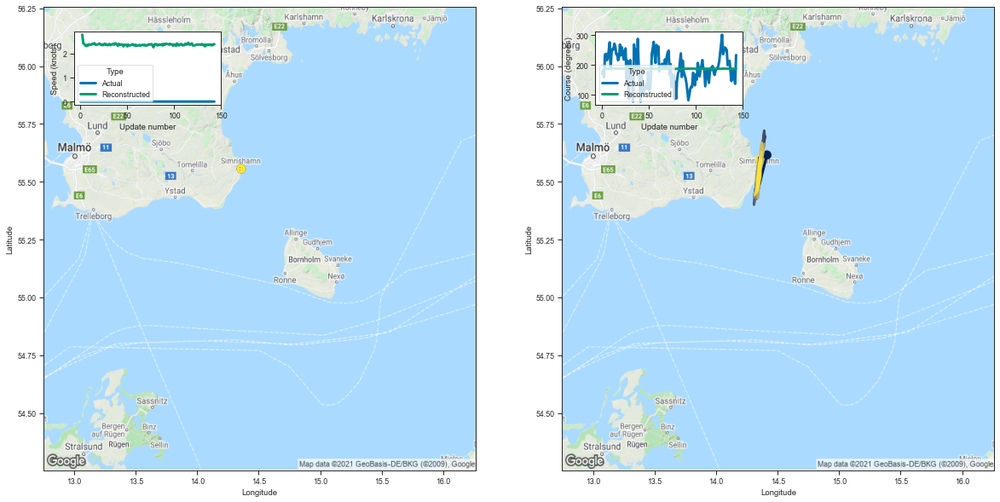

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.412657  55.615536  2.778650  186.967957         0.060931   
3    14.330752  55.441608  2.421483  186.783951         0.037064   
4    14.342865  55.545895  2.385289  187.210403         0.034970   
5    14.336895  55.513073  2.351455  186.886826         0.033547   
6    14.318734  55.437027  2.302667  186.531433         0.033154   
..         ...        ...       ...         ...              ...   
139  14.347115  55.549232  2.339102  186.959732         0.033679   
140  14.357383  55.589344  2.353612  187.181396         0.033533   
141  14.334314  55.473068  2.335386  186.742371         0.032992   
142  14.365651  55.591766  2.382303  187.224762         0.033518   
143  14.354976  55.595726  2.381755  187.245071         0.034282   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.149277     3.409895    100.395027                 1   
3          0.092557     3.205210    100.304146 

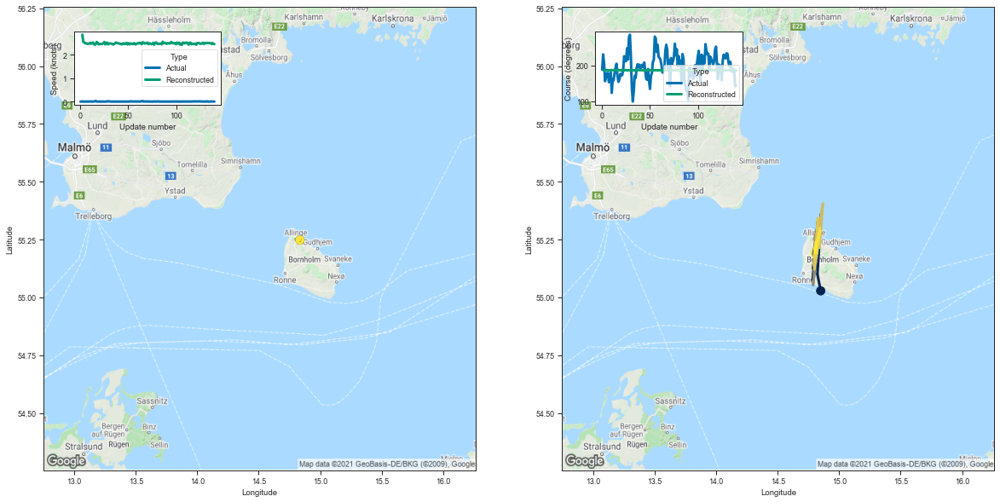

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.850312  55.028290  2.856329  185.604874         0.057718   
3    14.823325  55.100418  2.545994  186.055099         0.037621   
4    14.841234  55.249950  2.521533  186.554474         0.035000   
5    14.814266  55.172668  2.483654  186.263458         0.034712   
6    14.796463  55.126118  2.489291  186.121368         0.033744   
..         ...        ...       ...         ...              ...   
136  14.845019  55.288006  2.490912  186.596512         0.033754   
137  14.801137  55.210201  2.460998  186.248108         0.034185   
138  14.802807  55.205494  2.495608  186.458618         0.034534   
139  14.817221  55.241074  2.460817  186.336823         0.033700   
140  14.806422  55.192486  2.453253  186.151184         0.034154   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.139133     3.215773     99.684204                 1   
3          0.090147     3.067698     99.962601 

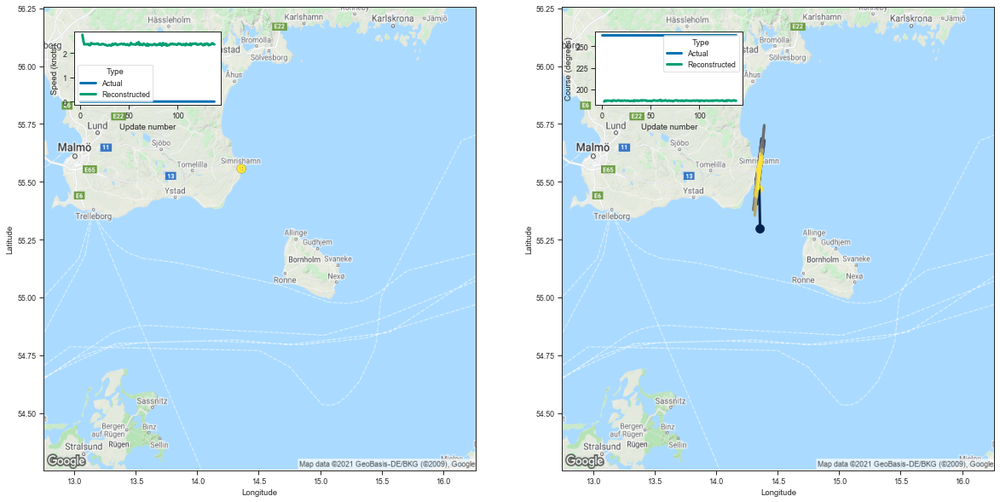

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.357590  55.296398  2.764902  185.990540         0.059729   
3    14.350838  55.468029  2.509315  187.190109         0.038591   
4    14.316139  55.438721  2.357379  186.650635         0.034003   
5    14.353769  55.556454  2.372161  187.079132         0.034112   
6    14.351382  55.573189  2.365811  187.115097         0.033922   
..         ...        ...       ...         ...              ...   
134  14.349006  55.575550  2.353866  187.152573         0.033383   
135  14.343074  55.557472  2.383863  187.117615         0.034152   
136  14.363736  55.606358  2.412879  187.485718         0.034347   
137  14.351687  55.549763  2.370347  187.045670         0.032954   
138  14.344400  55.468311  2.361395  186.933533         0.033727   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.146273     3.405762     99.873154                 1   
3          0.092128     3.255113    100.513268 

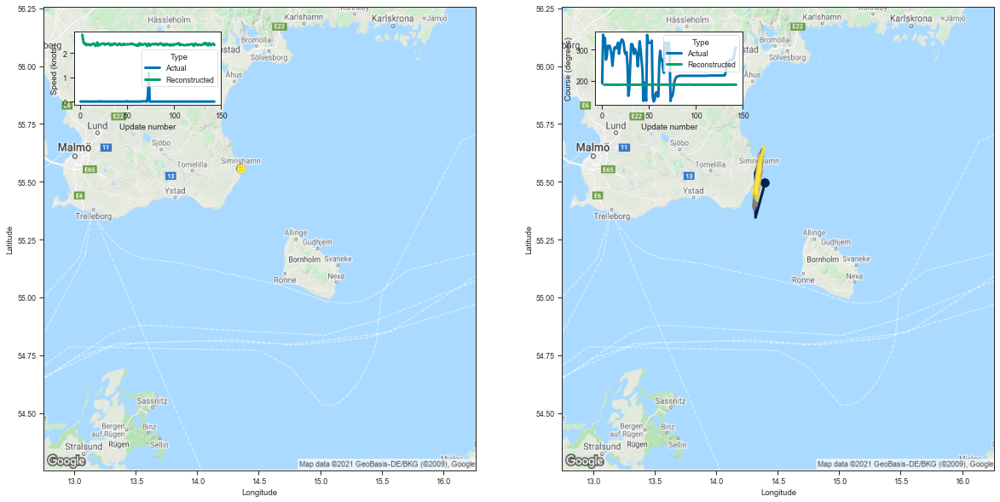

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.397627  55.494846  2.764295  186.554520         0.059233   
3    14.320428  55.345768  2.491041  186.748291         0.037425   
4    14.317155  55.465675  2.387243  186.762222         0.034089   
5    14.361948  55.588943  2.409964  187.349716         0.035244   
6    14.327337  55.490986  2.326313  186.733292         0.033396   
..         ...        ...       ...         ...              ...   
139  14.318980  55.463100  2.326359  186.617737         0.032747   
140  14.326791  55.448593  2.343338  186.690979         0.033123   
141  14.354676  55.583015  2.379856  187.247849         0.033371   
142  14.357280  55.570229  2.394627  187.231628         0.033526   
143  14.322199  55.454369  2.336141  186.624893         0.033175   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.146584     3.375808    100.177185                 1   
3          0.090686     3.236151    100.281067 

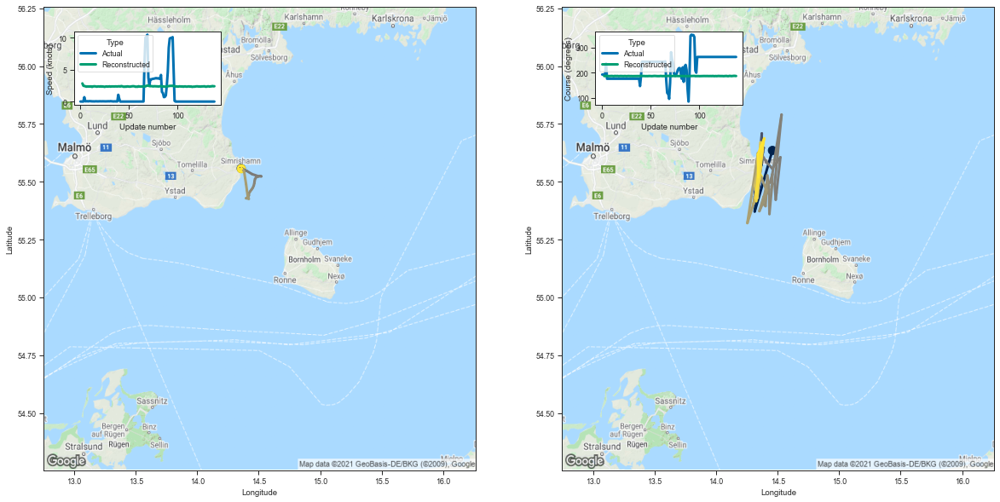

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.457835  55.635361  2.843601  187.219955         0.060203   
3    14.313786  55.371357  2.488253  186.798050         0.037593   
4    14.377701  55.657940  2.430452  187.640991         0.035718   
5    14.344053  55.543262  2.403769  187.145233         0.033606   
6    14.324888  55.506264  2.333742  186.772476         0.033388   
..         ...        ...       ...         ...              ...   
134  14.350434  55.572601  2.380784  187.108704         0.033475   
135  14.365595  55.608990  2.380046  187.283829         0.034820   
136  14.390985  55.687054  2.431937  187.827896         0.034224   
137  14.339719  55.617695  2.395460  187.460678         0.034758   
138  14.342974  55.518726  2.401401  187.088989         0.034202   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.146776     3.430454    100.517159                 1   
3          0.089337     3.255230    100.312569 

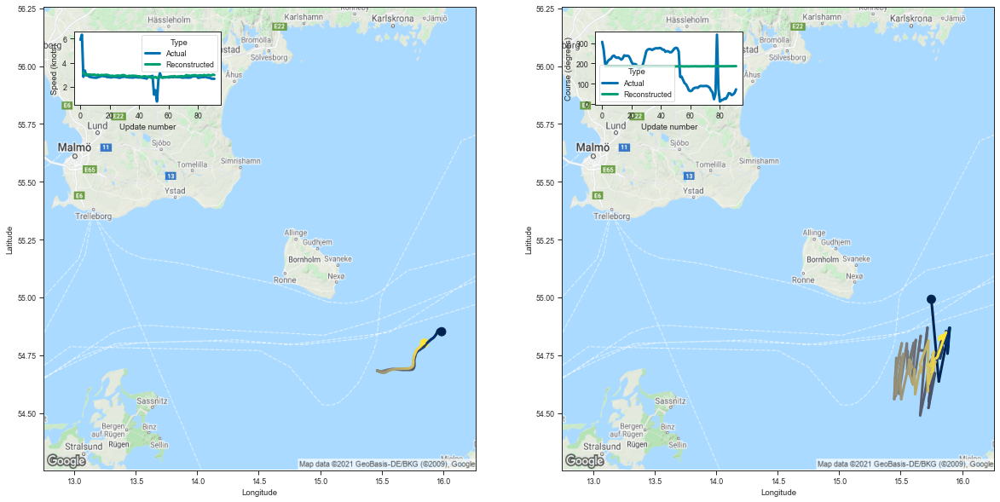

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.749684  54.991783  3.198712  185.947296         0.070010   
3   15.810461  54.635902  3.034078  186.079712         0.047155   
4   15.895503  54.867722  3.046125  186.854950         0.044737   
5   15.881384  54.756844  3.016618  186.516495         0.044269   
6   15.899880  54.868328  3.027358  186.824249         0.043838   
..        ...        ...       ...         ...              ...   
87  15.803979  54.748287  2.996149  186.401047         0.043110   
88  15.809748  54.760170  2.964324  186.311447         0.043049   
89  15.815991  54.767967  2.953772  186.286148         0.043184   
90  15.869302  54.848572  3.015006  186.691772         0.044049   
91  15.840635  54.820965  2.985464  186.540253         0.042908   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.158189     3.106730     99.881973                 1   
3         0.102413     2.992267     99.977676                

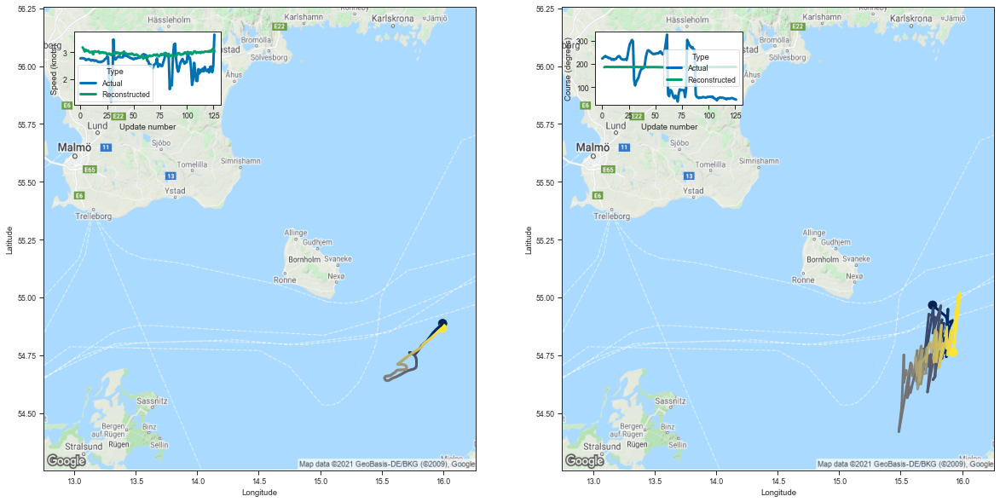

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.759962  54.966213  3.174056  185.580719         0.068839   
3    15.869181  54.917259  3.117710  187.045547         0.049994   
4    15.885071  54.889835  3.018292  186.832825         0.044733   
5    15.923627  54.900105  3.086057  187.100098         0.044676   
6    15.895665  54.869362  3.043962  186.980499         0.044386   
..         ...        ...       ...         ...              ...   
122  15.949142  54.901382  3.054966  186.999130         0.043478   
123  15.933981  54.865990  3.019589  186.728607         0.043546   
124  15.966125  55.003757  3.088787  187.487289         0.044591   
125  15.985728  55.020317  3.141190  187.731003         0.045683   
126  15.926337  54.762802  3.020035  186.474701         0.043867   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.164315     3.087603     99.715897                 1   
3          0.106407     3.073210    100.483093 

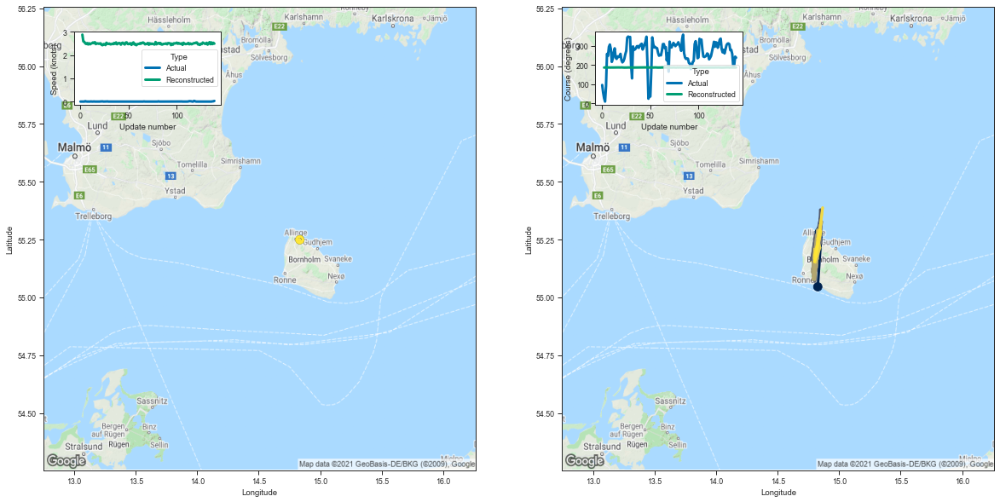

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.826493  55.045807  2.877997  185.771408         0.057156   
3    14.853806  55.259945  2.590200  186.735779         0.038755   
4    14.845947  55.313667  2.566399  187.062866         0.036695   
5    14.812971  55.286682  2.503464  186.710464         0.035808   
6    14.792461  55.189316  2.474926  186.207962         0.034056   
..         ...        ...       ...         ...              ...   
135  14.799099  55.153732  2.466609  186.065491         0.033750   
136  14.844100  55.291100  2.543388  186.683014         0.034624   
137  14.802869  55.180927  2.469831  186.132446         0.033579   
138  14.827503  55.233704  2.526011  186.464935         0.034925   
139  14.807276  55.161083  2.490103  186.238281         0.034080   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.137790     3.229876     99.771561                 1   
3          0.091934     3.103538    100.331558 

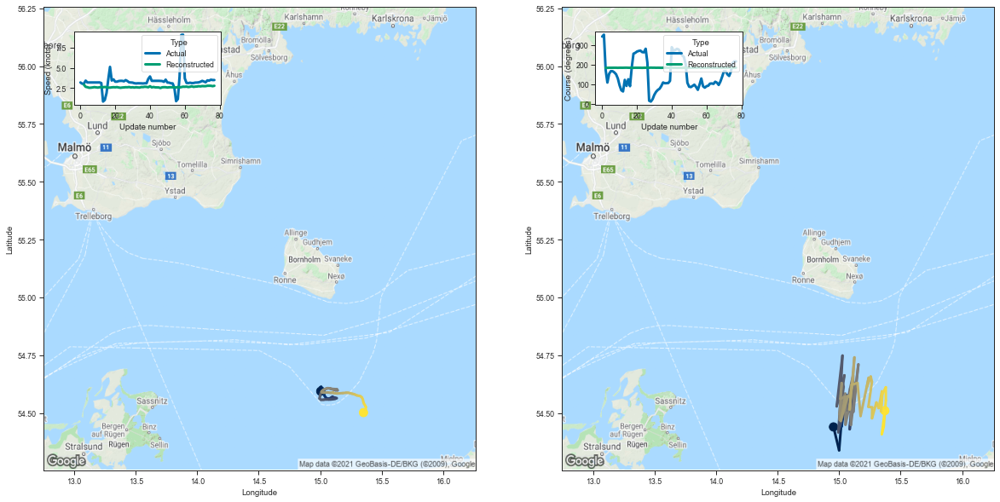

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.954228  54.439617  2.920588  183.807358         0.061749   
3   15.000015  54.338551  2.659074  183.954559         0.040711   
4   15.037466  54.582802  2.611580  184.522141         0.037703   
5   15.025102  54.578819  2.541794  184.412094         0.036790   
6   15.020180  54.585690  2.554802  184.467682         0.036691   
..        ...        ...       ...         ...              ...   
73  15.379513  54.611259  2.790068  185.306625         0.040961   
74  15.380014  54.554871  2.792964  185.109802         0.040348   
75  15.362625  54.440460  2.789022  184.807938         0.039604   
76  15.346944  54.408081  2.742863  184.477188         0.040283   
77  15.371544  54.510315  2.789855  184.996872         0.039616   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.143959     3.168231     98.746696                 1   
3         0.089683     3.000433     98.835953                

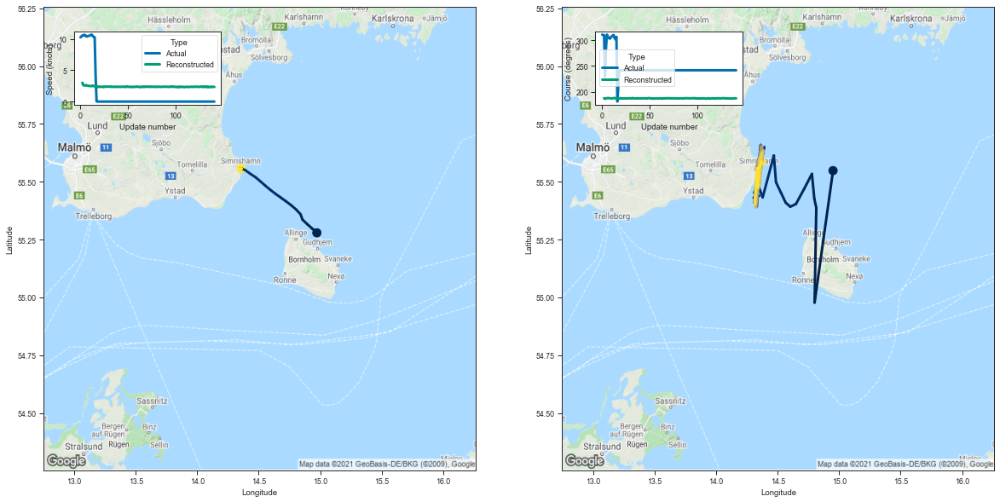

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.950482  55.548149  3.013289  187.402222         0.063522   
3    14.800669  54.977257  2.612778  185.984909         0.039730   
4    14.814486  55.387287  2.595733  187.199036         0.038362   
5    14.798595  55.425388  2.553765  187.180069         0.037335   
6    14.778872  55.533928  2.631724  187.753891         0.036252   
..         ...        ...       ...         ...              ...   
137  14.331764  55.557793  2.306114  186.974640         0.033583   
138  14.339456  55.474148  2.371351  186.883804         0.034213   
139  14.345565  55.555603  2.323089  186.847137         0.033835   
140  14.370248  55.580997  2.368482  187.186020         0.033623   
141  14.367293  55.587448  2.335548  187.104340         0.033260   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.153248     3.358448    100.631622                 1   
3          0.093714     3.118888     99.912155 

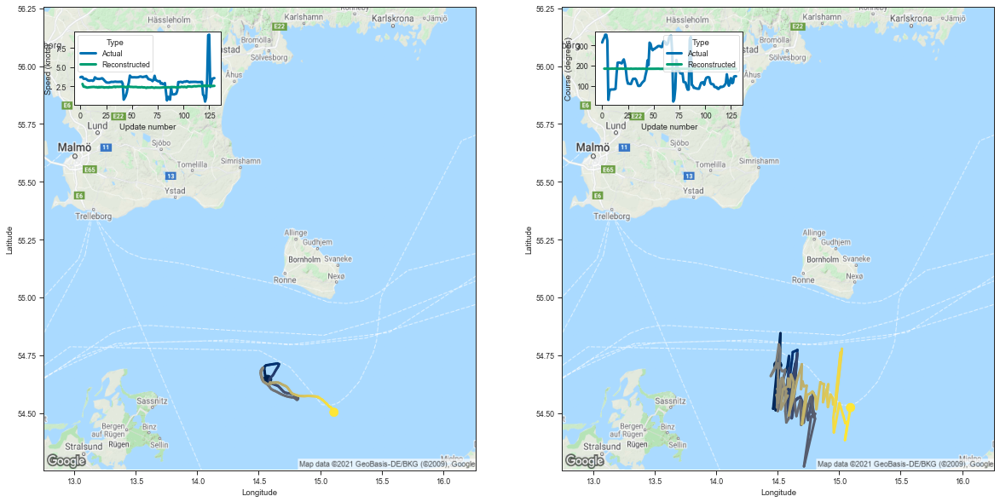

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.501263  54.706848  2.834259  184.528793         0.060023   
3    14.484208  54.511623  2.490561  184.044037         0.038464   
4    14.517884  54.716774  2.450593  184.457932         0.036037   
5    14.523206  54.844669  2.440507  184.875595         0.036297   
6    14.464017  54.518272  2.363264  183.628311         0.034196   
..         ...        ...       ...         ...              ...   
126  15.033914  54.487747  2.591650  184.250412         0.037586   
127  15.050112  54.456066  2.587099  184.243774         0.037869   
128  15.069803  54.463036  2.538323  184.129517         0.037194   
129  15.047572  54.382618  2.577456  183.901382         0.037448   
130  15.092626  54.523438  2.578204  184.367340         0.037396   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.140443     3.299449     99.082550                 1   
3          0.088435     3.077733     98.868927 

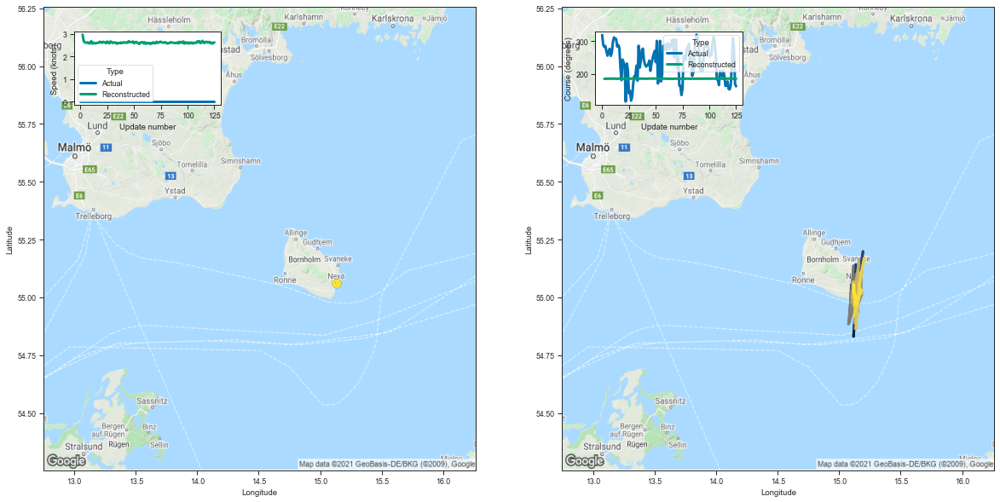

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.145535  55.037140  2.970245  185.672363         0.061077   
3    15.117232  54.830887  2.695482  185.693314         0.038737   
4    15.137580  55.007812  2.627234  185.992584         0.036625   
5    15.107239  54.954136  2.612343  185.912460         0.034180   
6    15.107116  54.974102  2.609674  185.952988         0.035706   
..         ...        ...       ...         ...              ...   
121  15.146049  54.972103  2.599011  185.798874         0.035556   
122  15.132821  54.967930  2.621003  185.888123         0.036040   
123  15.119964  55.054996  2.569700  186.086609         0.036665   
124  15.112699  55.025349  2.602829  186.186218         0.036443   
125  15.144499  54.994843  2.627482  185.940811         0.036392   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.144039     3.194662     99.746841                 1   
3          0.089825     2.996496     99.768295 

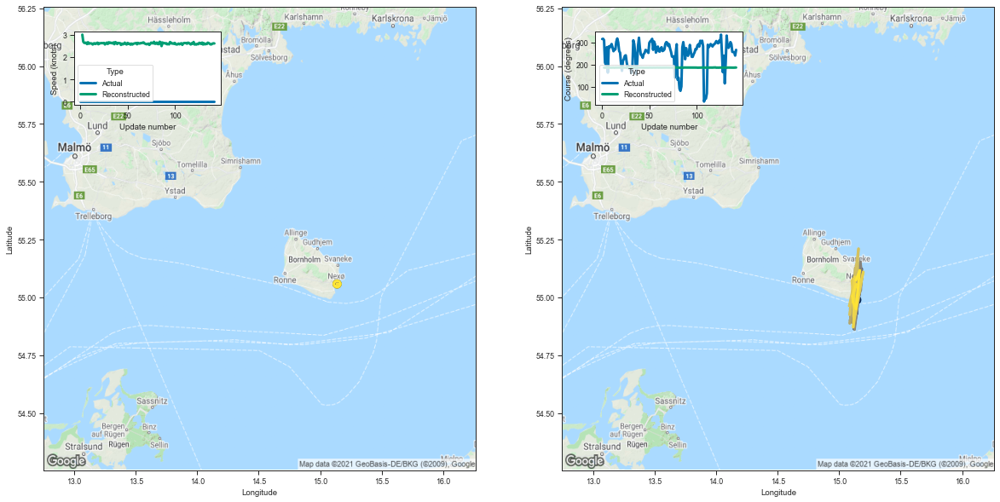

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.143421  54.988899  3.008789  185.811127         0.061069   
3    15.131537  54.931232  2.692310  185.901855         0.039072   
4    15.147112  54.958244  2.638664  185.914078         0.037249   
5    15.143003  54.927391  2.636505  185.842957         0.036028   
6    15.131673  55.042618  2.646974  186.302414         0.035897   
..         ...        ...       ...         ...              ...   
138  15.107388  55.005802  2.568112  185.830597         0.036497   
139  15.113321  54.979801  2.574381  185.755798         0.034978   
140  15.136229  54.950287  2.602684  185.791519         0.035596   
141  15.167648  55.116402  2.617581  186.288605         0.036231   
142  15.136825  55.074593  2.612568  186.277481         0.035921   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.144157     3.194058     99.805344                 1   
3          0.091713     3.039308     99.874641 

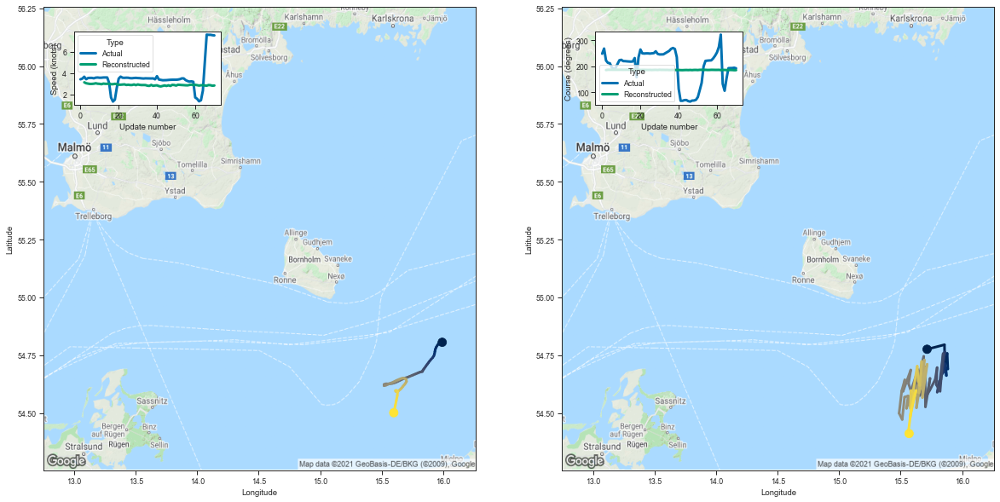

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.714978  54.775505  3.147722  185.167343         0.068971   
3   15.856431  54.795116  3.060571  186.412994         0.047688   
4   15.859398  54.704334  3.025546  186.300842         0.043874   
5   15.878384  54.757393  2.997292  186.282104         0.044207   
6   15.883823  54.690144  3.000539  186.227966         0.044168   
..        ...        ...       ...         ...              ...   
66  15.606887  54.558872  2.832023  185.233292         0.041666   
67  15.625320  54.597366  2.893470  185.515961         0.043060   
68  15.586302  54.514812  2.875962  185.288223         0.041927   
69  15.562755  54.417740  2.826961  184.674896         0.041772   
70  15.568824  54.411030  2.850788  184.818512         0.042052   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.156640     3.061149     99.470642                 1   
3         0.104598     2.979642    100.158012                

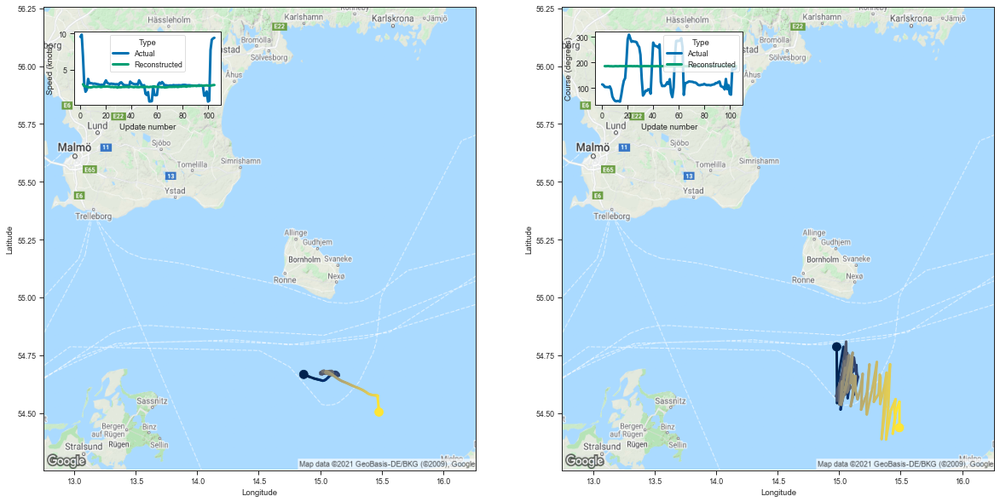

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.980267  54.786098  2.965721  185.056671         0.064105   
3    14.983690  54.542828  2.703911  184.774033         0.040982   
4    15.043382  54.708553  2.664269  185.219543         0.038096   
5    15.035052  54.785557  2.632279  185.385468         0.036945   
6    14.987542  54.636845  2.529525  184.517609         0.035781   
..         ...        ...       ...         ...              ...   
101  15.455708  54.478596  2.770588  184.823135         0.039688   
102  15.435822  54.410229  2.778867  184.559647         0.039460   
103  15.461156  54.505234  2.810790  185.070724         0.040863   
104  15.490617  54.548820  2.847056  185.302750         0.041933   
105  15.490236  54.436440  2.861299  185.022003         0.042882   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.150947     3.222927     99.399925                 1   
3          0.094522     3.069648     99.277771 

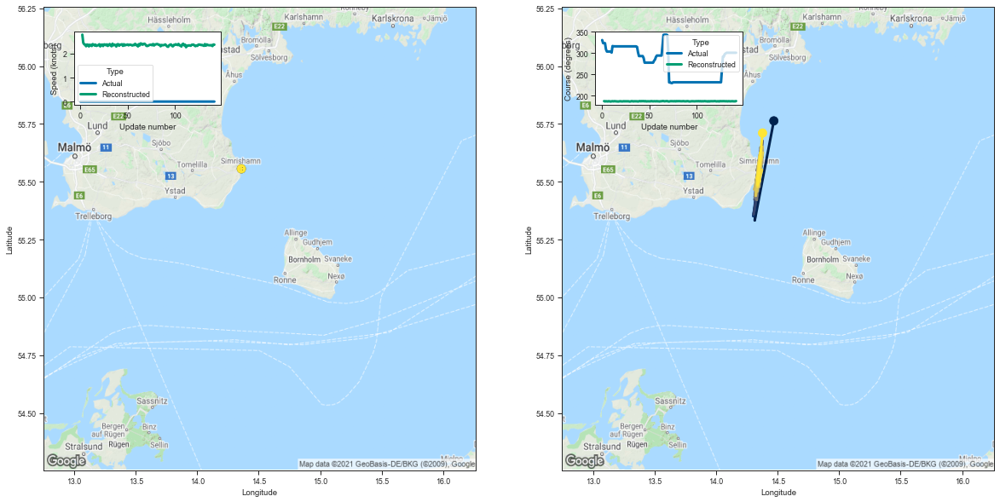

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.469310  55.763264  2.794162  187.351624         0.062417   
3    14.314132  55.332954  2.451656  186.541382         0.037675   
4    14.342934  55.517490  2.391346  187.031357         0.035309   
5    14.329622  55.472801  2.370128  186.837402         0.034073   
6    14.337280  55.465218  2.309063  186.543182         0.033191   
..         ...        ...       ...         ...              ...   
138  14.362763  55.606018  2.352616  187.175003         0.033969   
139  14.336291  55.505596  2.356432  186.897964         0.033746   
140  14.351088  55.540913  2.317068  186.937881         0.033339   
141  14.337011  55.486866  2.381547  186.828400         0.033322   
142  14.377435  55.710747  2.375689  187.524948         0.033550   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.156817     3.406643    100.603157                 1   
3          0.091627     3.256022    100.185074 

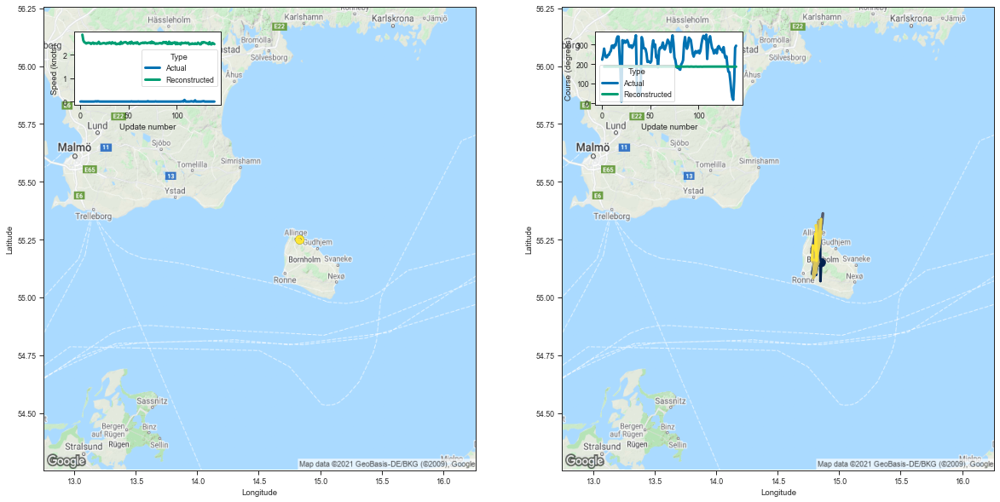

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.854486  55.150059  2.850668  185.929672         0.058176   
3    14.848144  55.070316  2.603794  186.160049         0.038378   
4    14.845215  55.299736  2.529670  186.691574         0.035156   
5    14.824095  55.233814  2.506550  186.437317         0.035271   
6    14.815739  55.166603  2.473655  186.243256         0.034014   
..         ...        ...       ...         ...              ...   
135  14.778810  55.162556  2.446588  185.888947         0.033659   
136  14.786510  55.224255  2.433544  186.248795         0.033334   
137  14.810749  55.199894  2.495699  186.257874         0.034765   
138  14.807390  55.274879  2.476056  186.567505         0.034943   
139  14.816542  55.157715  2.445774  186.040894         0.033912   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.140970     3.245459     99.882416                 1   
3          0.090177     3.072831    100.005295 

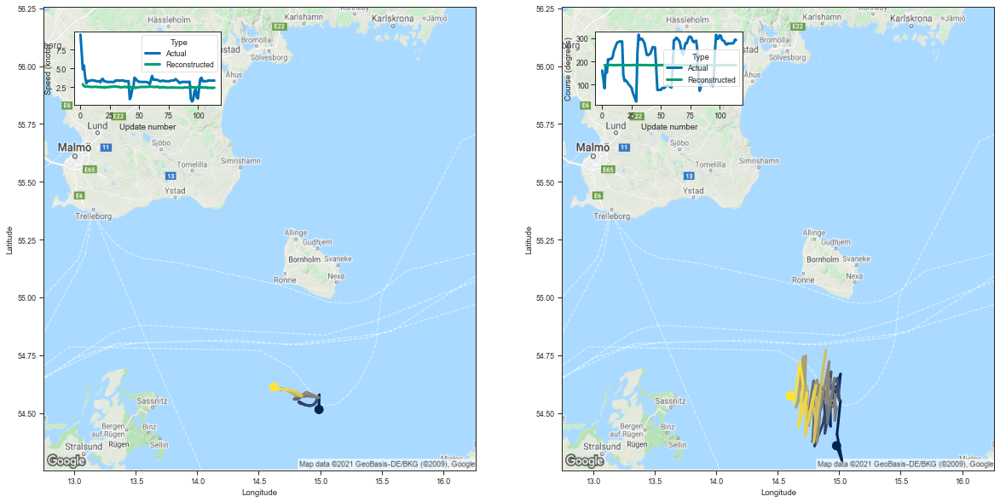

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.978792  54.358421  2.896213  183.574402         0.063014   
3    15.022705  54.294685  2.655213  183.838272         0.041199   
4    14.982885  54.408279  2.565639  183.905121         0.037502   
5    15.010653  54.551613  2.599469  184.527542         0.037396   
6    14.992423  54.570938  2.592278  184.580231         0.037428   
..         ...        ...       ...         ...              ...   
110  14.695058  54.666916  2.414150  184.286118         0.035060   
111  14.681005  54.719925  2.449001  184.622391         0.034583   
112  14.636425  54.548252  2.368282  183.846405         0.034205   
113  14.603771  54.593243  2.426263  184.066406         0.035051   
114  14.602483  54.573788  2.434678  184.107193         0.034821   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.145504     3.156588     98.625381                 1   
3          0.091732     2.976173     98.769485 

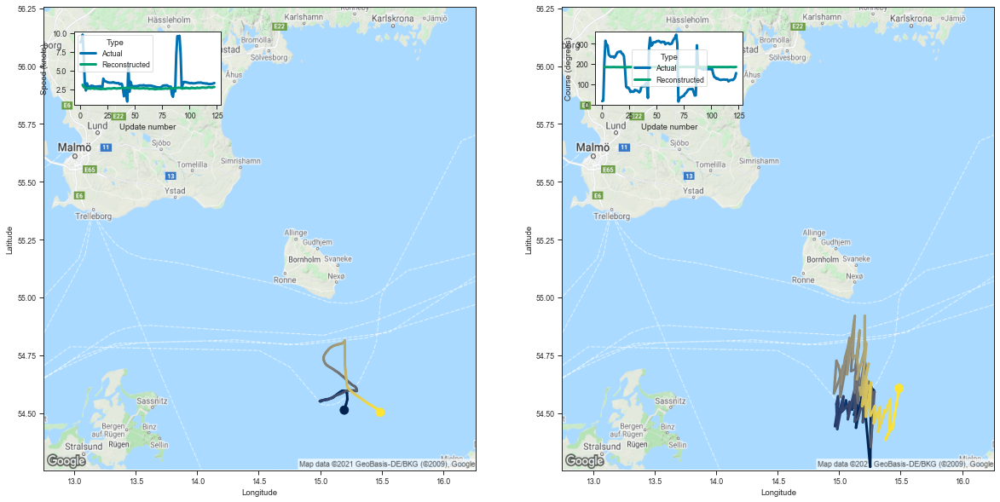

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.259539  54.589985  3.104963  184.840652         0.067686   
3    15.252714  54.267204  2.813717  184.188675         0.044163   
4    15.217666  54.473934  2.712476  184.623077         0.039494   
5    15.193718  54.598877  2.700945  185.010773         0.039475   
6    15.154469  54.485165  2.627381  184.432297         0.037825   
..         ...        ...       ...         ...              ...   
119  15.407890  54.417553  2.772531  184.697968         0.039926   
120  15.376180  54.384117  2.735070  184.452606         0.039737   
121  15.424640  54.440620  2.741773  184.542175         0.040053   
122  15.432631  54.429398  2.813785  184.712158         0.040587   
123  15.487693  54.606567  2.809999  185.369171         0.041292   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.151794     3.206407     99.291534                 1   
3          0.094241     2.990974     98.928558 

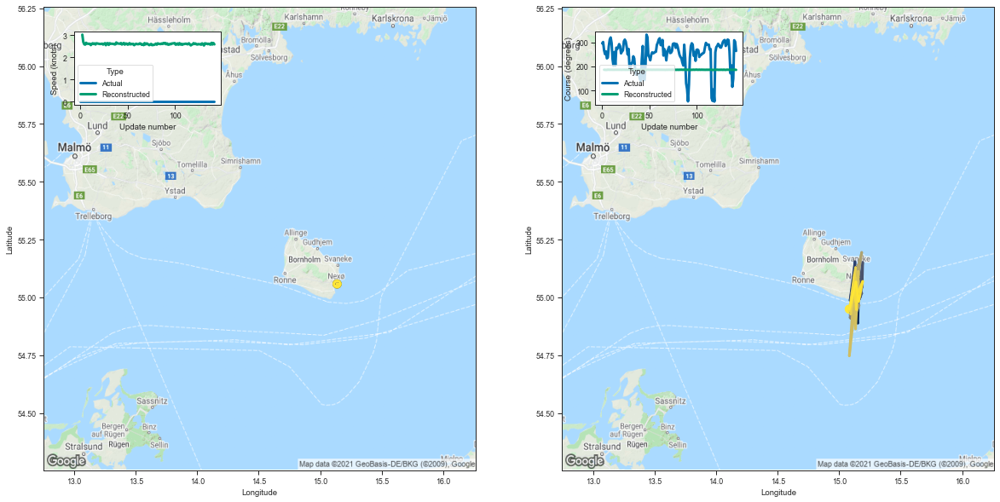

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.161275  55.072517  3.032666  186.231216         0.062794   
3    15.152054  54.888702  2.703228  185.883133         0.039873   
4    15.129025  54.920589  2.597991  185.596069         0.036851   
5    15.113525  54.966026  2.577871  185.759888         0.036245   
6    15.155352  55.119568  2.663003  186.636108         0.036960   
..         ...        ...       ...         ...              ...   
138  15.142670  55.008129  2.579276  185.815567         0.036077   
139  15.191825  55.068954  2.661109  186.498428         0.037318   
140  15.158262  54.981697  2.584309  185.914032         0.035420   
141  15.136436  55.066402  2.651043  186.265991         0.035862   
142  15.082777  54.949039  2.592729  185.761749         0.035163   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.145209     3.230813    100.032944                 1   
3          0.093384     3.007847     99.866997 

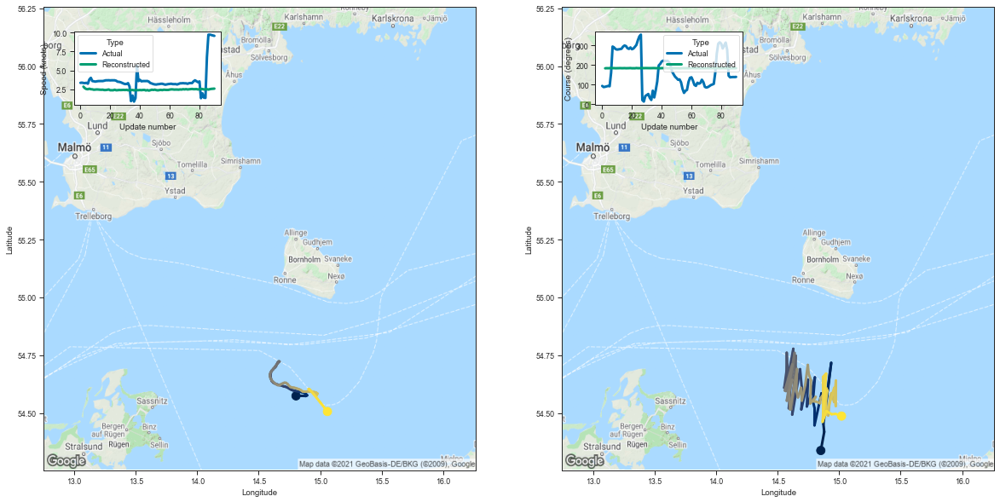

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.851143  54.337631  2.862567  183.534805         0.059237   
3   14.878917  54.418072  2.654196  184.135101         0.039993   
4   14.872237  54.452999  2.546884  183.934402         0.037347   
5   14.891965  54.530010  2.523525  184.177032         0.036106   
6   14.935649  54.716942  2.588913  185.056335         0.037236   
..        ...        ...       ...         ...              ...   
86  14.865504  54.461620  2.478168  183.829041         0.035968   
87  14.896139  54.508335  2.532737  184.123245         0.037068   
88  14.938721  54.494511  2.569899  184.109924         0.036194   
89  14.971173  54.496159  2.582801  184.256134         0.037851   
90  15.019551  54.486660  2.602410  184.261139         0.037189   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.137976     3.149466     98.601028                 1   
3         0.090405     3.045725     98.903030                

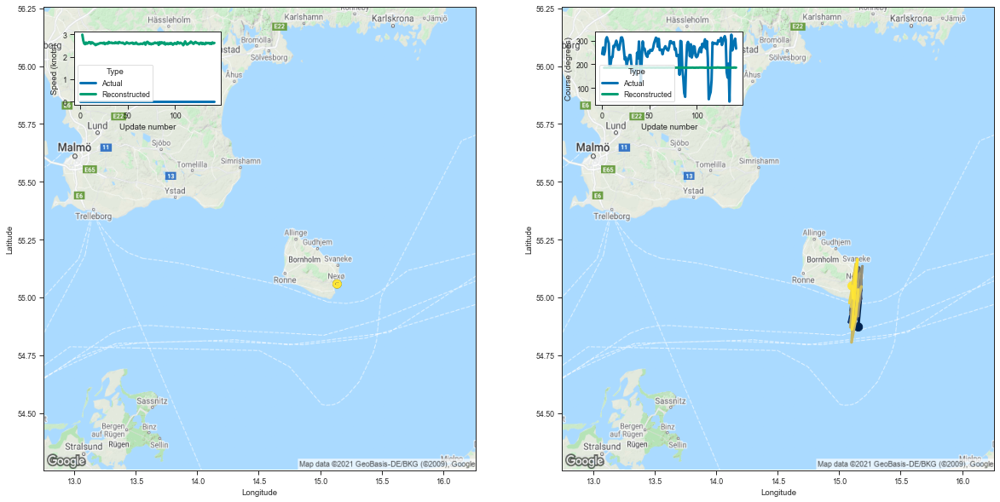

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.155845  54.871948  2.993149  185.419083         0.059201   
3    15.175333  54.985741  2.733081  186.304504         0.040166   
4    15.121747  54.940792  2.595174  185.806412         0.036707   
5    15.093796  54.942402  2.566294  185.556244         0.034966   
6    15.116539  55.063026  2.638677  186.275589         0.035581   
..         ...        ...       ...         ...              ...   
138  15.134473  55.062107  2.614247  186.236694         0.036405   
139  15.123296  54.990788  2.576915  185.843658         0.034769   
140  15.147550  55.164955  2.644205  186.633514         0.037114   
141  15.112645  54.996075  2.600678  185.932892         0.036107   
142  15.105721  55.049435  2.622200  186.157928         0.036822   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.138327     3.142655     99.605392                 1   
3          0.091240     3.043896    100.087799 

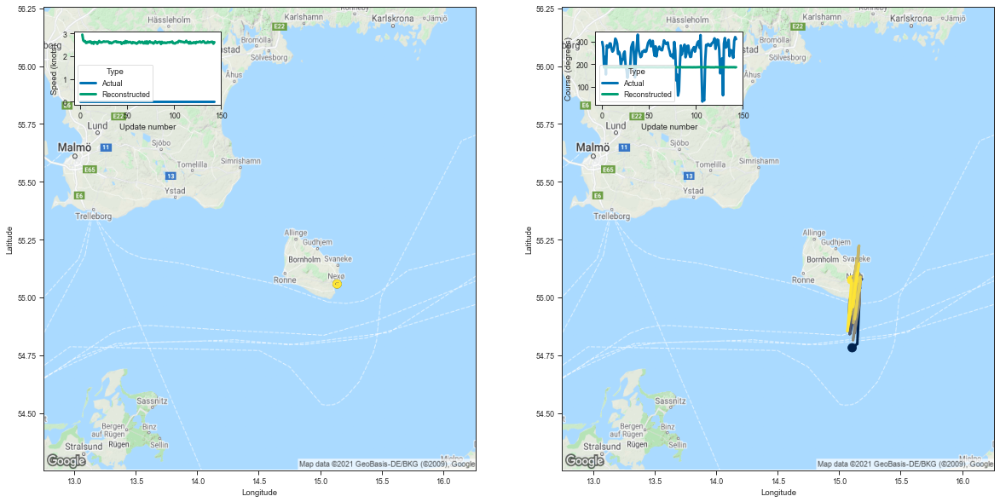

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.106096  54.782059  2.948439  185.014771         0.060548   
3    15.147801  54.798855  2.697412  185.571167         0.040186   
4    15.166144  54.993252  2.656025  186.067276         0.036644   
5    15.154652  54.941418  2.663732  185.972275         0.036039   
6    15.126924  54.972256  2.580123  185.773682         0.035511   
..         ...        ...       ...         ...              ...   
139  15.114153  54.958500  2.622701  186.033905         0.036043   
140  15.142070  55.093464  2.633288  186.291138         0.036611   
141  15.152551  55.108562  2.634438  186.421875         0.036989   
142  15.067548  54.853981  2.549201  185.425812         0.034954   
143  15.100947  55.075062  2.617014  186.240280         0.035821   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.142670     3.195489     99.408737                 1   
3          0.090306     2.996184     99.699753 

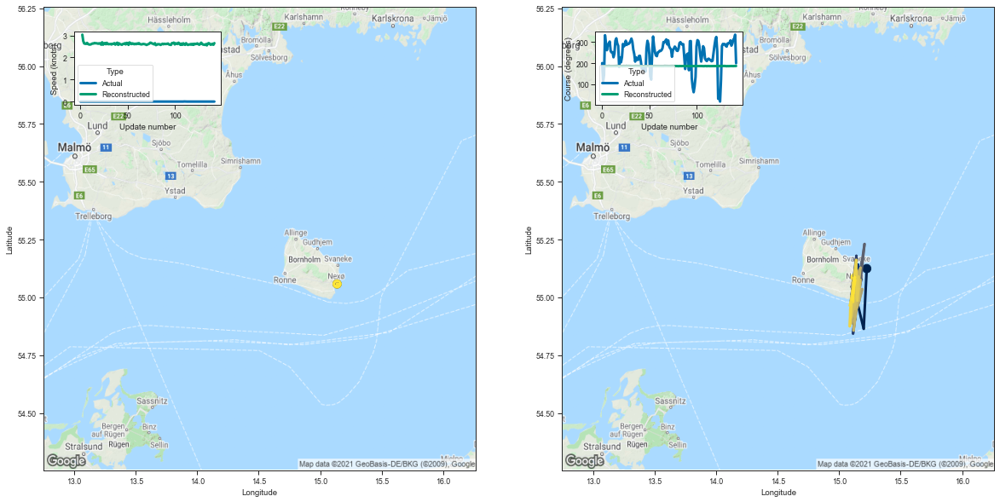

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.224597  55.124321  3.036860  186.199310         0.061092   
3    15.199828  54.863987  2.741081  185.945663         0.040567   
4    15.120216  55.038410  2.635973  186.253891         0.037507   
5    15.130063  55.057388  2.622674  186.188507         0.036252   
6    15.140393  55.056034  2.618807  186.093826         0.035642   
..         ...        ...       ...         ...              ...   
138  15.130754  55.074184  2.577785  186.103455         0.036038   
139  15.106747  54.989071  2.589816  185.867447         0.035612   
140  15.125877  55.068920  2.623981  186.259094         0.035345   
141  15.125248  55.088085  2.577050  186.168732         0.036164   
142  15.130149  55.086395  2.652312  186.421402         0.035820   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.146502     3.183385    100.012299                 1   
3          0.090107     3.014910     99.914932 

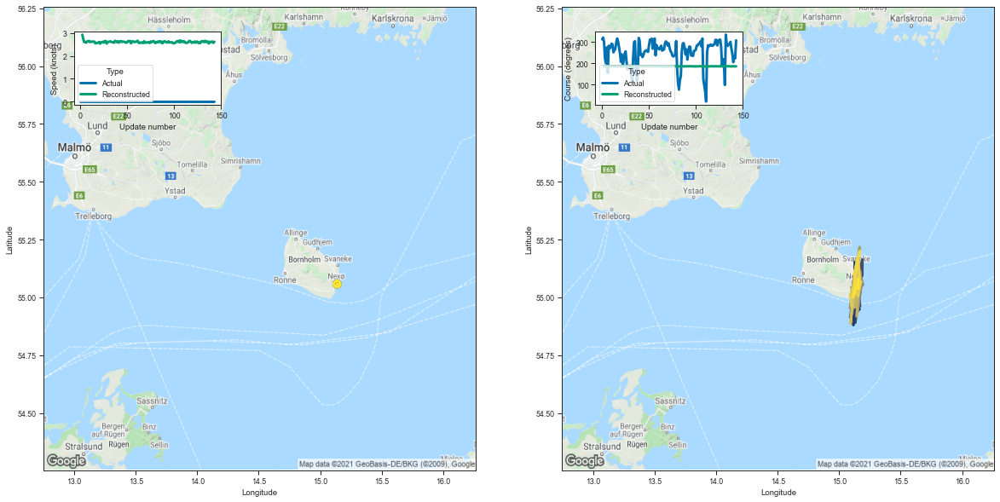

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.144673  55.048637  2.936936  185.658432         0.061035   
3    15.163810  54.947704  2.749686  186.269363         0.040397   
4    15.137142  54.983112  2.610482  185.931976         0.036272   
5    15.168082  55.075706  2.614399  186.227539         0.036718   
6    15.119424  54.960327  2.583850  185.786377         0.036111   
..         ...        ...       ...         ...              ...   
139  15.121252  55.012463  2.602230  185.985123         0.035723   
140  15.149717  55.057278  2.626178  186.267044         0.035819   
141  15.154828  55.080208  2.634921  186.376556         0.036947   
142  15.155707  55.038162  2.573856  185.969131         0.035962   
143  15.151553  55.037075  2.623644  186.218094         0.036463   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.144489     3.196589     99.737091                 1   
3          0.093367     3.049638    100.073578 

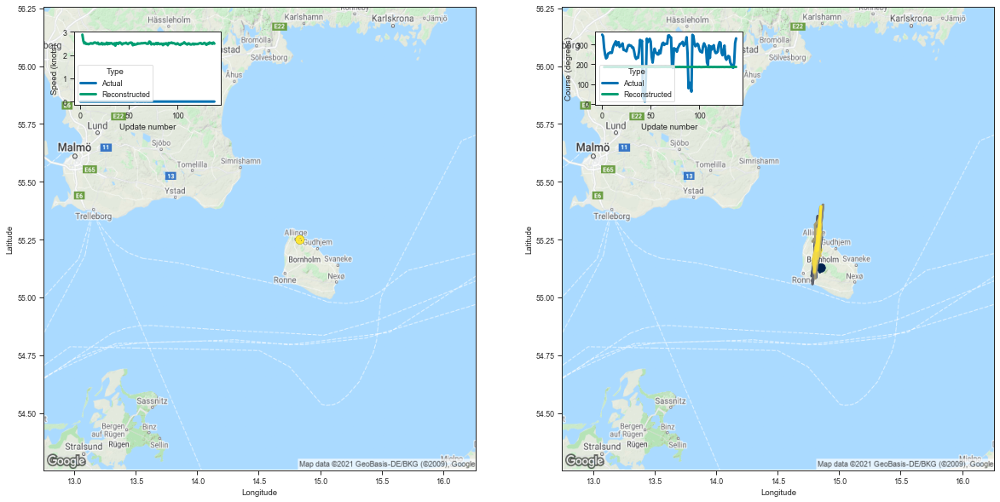

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.854241  55.127216  2.878037  185.991028         0.059549   
3    14.843588  55.109325  2.608037  186.210556         0.037968   
4    14.823099  55.145634  2.499731  186.161514         0.035260   
5    14.841537  55.305317  2.533000  186.802780         0.035356   
6    14.821562  55.256546  2.474688  186.360519         0.034195   
..         ...        ...       ...         ...              ...   
134  14.845571  55.282795  2.501050  186.534241         0.033652   
135  14.815965  55.223713  2.520398  186.398895         0.033384   
136  14.816043  55.200283  2.481362  186.257828         0.033157   
137  14.852338  55.393394  2.538079  187.088791         0.035558   
138  14.826798  55.204174  2.491657  186.382111         0.034627   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.143394     3.252298     99.902351                 1   
3          0.090060     3.098884    100.032677 

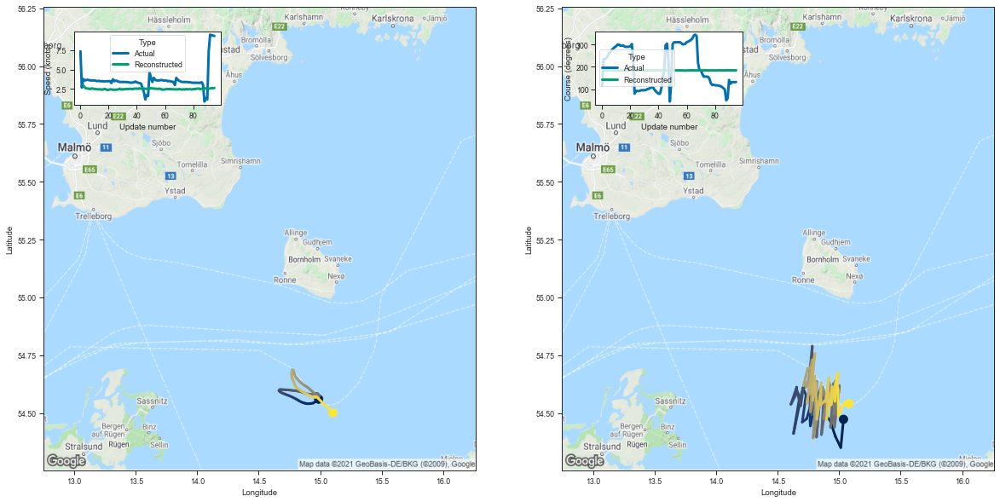

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.035690  54.472569  2.954617  184.013199         0.062822   
3   15.013583  54.350151  2.717593  184.190262         0.040915   
4   14.969457  54.398922  2.566469  183.916595         0.038632   
5   14.925990  54.468105  2.568425  184.010498         0.036499   
6   14.891267  54.490002  2.535981  184.159073         0.036483   
..        ...        ...       ...         ...              ...   
91  14.974505  54.654522  2.542951  184.554550         0.036634   
92  14.991575  54.599960  2.564938  184.617538         0.037258   
93  14.992889  54.488411  2.601543  184.248016         0.037257   
94  15.043260  54.545784  2.604164  184.530258         0.038210   
95  15.080496  54.540051  2.632293  184.565323         0.038328   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.145037     3.168149     98.854401                 1   
3         0.090438     3.021149     98.960213                

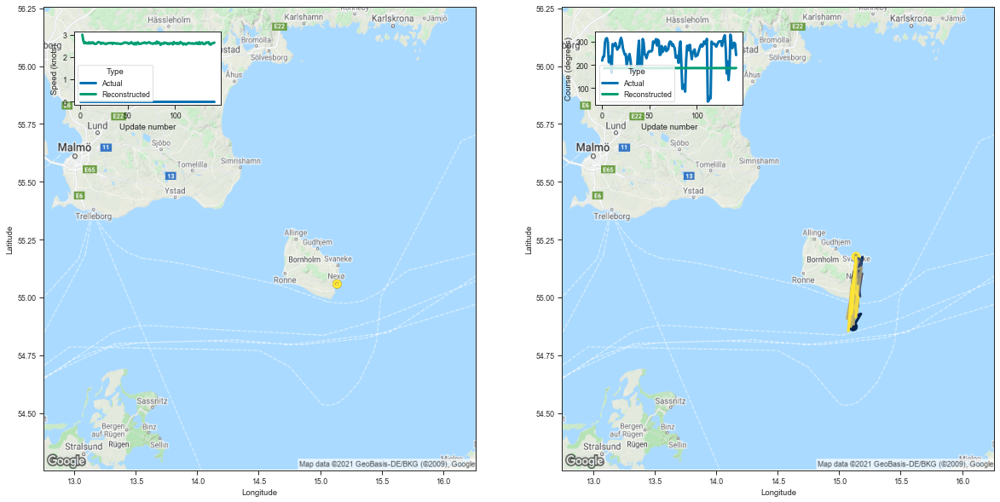

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.114382  54.873135  2.998375  185.397034         0.059928   
3    15.176582  54.928432  2.742134  186.273392         0.041058   
4    15.106184  54.914124  2.610770  185.766617         0.037386   
5    15.119740  55.109734  2.658968  186.531372         0.037187   
6    15.109605  55.085453  2.611276  186.289200         0.036178   
..         ...        ...       ...         ...              ...   
138  15.103280  54.967121  2.548735  185.626801         0.034865   
139  15.074463  54.855175  2.588043  185.537384         0.035742   
140  15.107676  55.051678  2.614063  186.172531         0.036670   
141  15.100958  54.929314  2.618061  185.827957         0.035448   
142  15.137055  55.176666  2.641140  186.661362         0.037446   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.139587     3.193931     99.576233                 1   
3          0.093868     3.083087    100.081467 

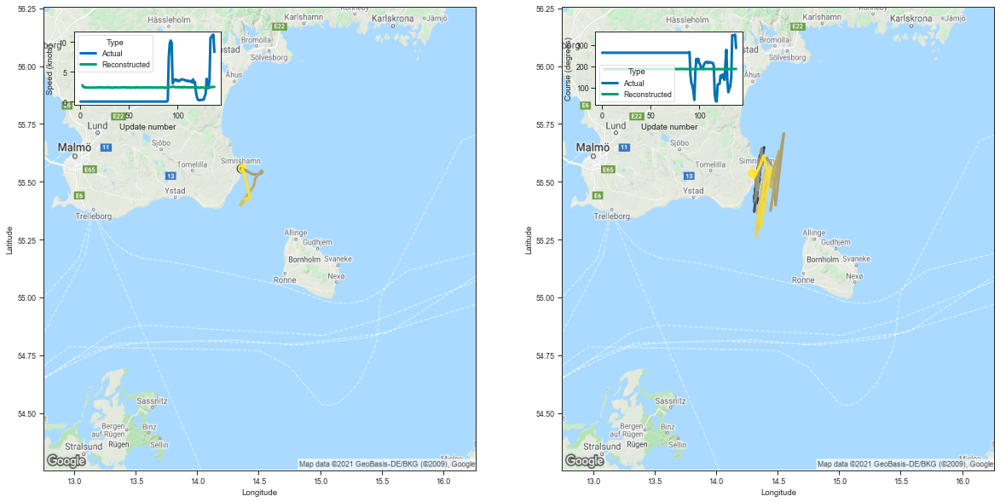

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.368215  55.413002  2.745823  186.218216         0.058890   
3    14.330235  55.433041  2.448201  186.834915         0.037279   
4    14.359425  55.580959  2.422564  187.385895         0.035223   
5    14.345609  55.558399  2.341149  186.994965         0.032828   
6    14.355906  55.529572  2.376991  187.089935         0.034099   
..         ...        ...       ...         ...              ...   
134  14.430294  55.521080  2.360712  186.992401         0.033404   
135  14.386518  55.612717  2.462321  187.550400         0.035848   
136  14.350828  55.562420  2.449087  187.349884         0.036632   
137  14.307982  55.516350  2.475999  187.243378         0.036767   
138  14.296835  55.536587  2.453529  187.339890         0.037650   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.144039     3.369554    100.007034                 1   
3          0.092061     3.232187    100.343628 

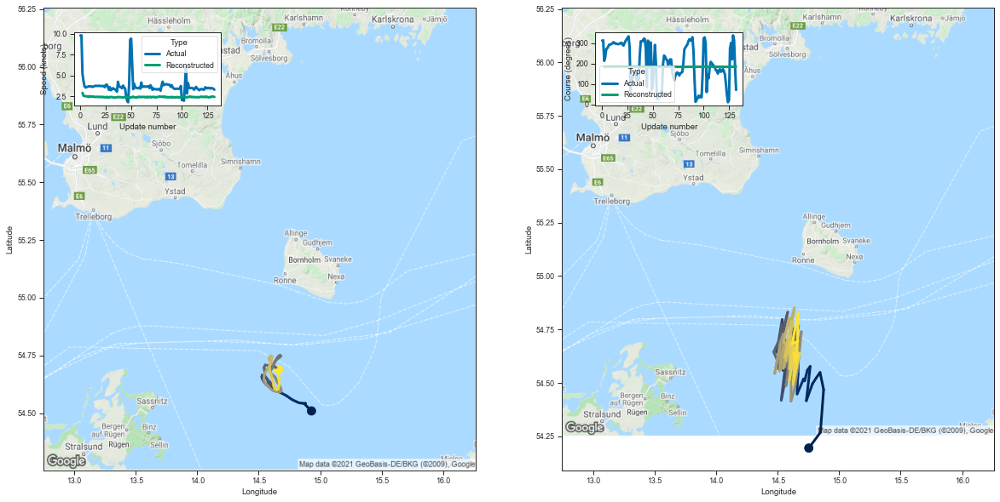

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.753652  54.194633  2.906783  183.156982         0.061096   
3    14.847721  54.267834  2.570229  183.438934         0.039643   
4    14.873992  54.468491  2.522665  184.048431         0.037280   
5    14.844963  54.548801  2.500594  184.202621         0.035639   
6    14.814231  54.523224  2.500083  184.195236         0.035463   
..         ...        ...       ...         ...              ...   
128  14.641865  54.610218  2.421945  184.218307         0.034446   
129  14.657495  54.623333  2.418369  184.222855         0.034584   
130  14.667217  54.826420  2.475018  185.073868         0.035172   
131  14.617223  54.681408  2.450591  184.534561         0.035550   
132  14.665065  54.694820  2.423522  184.527344         0.034730   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.140737     3.213995     98.356529                 1   
3          0.090319     2.989426     98.572372 

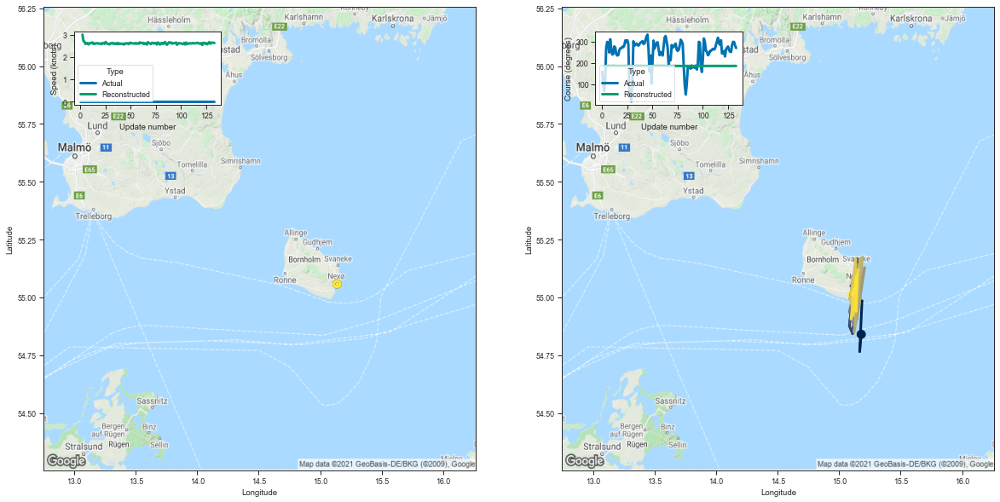

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.179778  54.840126  3.002829  185.459320         0.061502   
3    15.167146  54.765495  2.718255  185.481827         0.039523   
4    15.186080  54.984879  2.679015  186.140060         0.037629   
5    15.111744  54.973202  2.585082  185.786270         0.035658   
6    15.115329  54.994865  2.615151  186.130692         0.036000   
..         ...        ...       ...         ...              ...   
129  15.137646  54.939617  2.594219  185.779373         0.036389   
130  15.143647  55.097572  2.632109  186.360733         0.035881   
131  15.136646  55.076183  2.643785  186.443817         0.036193   
132  15.130084  55.037739  2.637509  186.269547         0.036550   
133  15.107251  55.010029  2.624543  186.180450         0.036180   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.141828     3.175026     99.633476                 1   
3          0.089175     3.005248     99.655777 

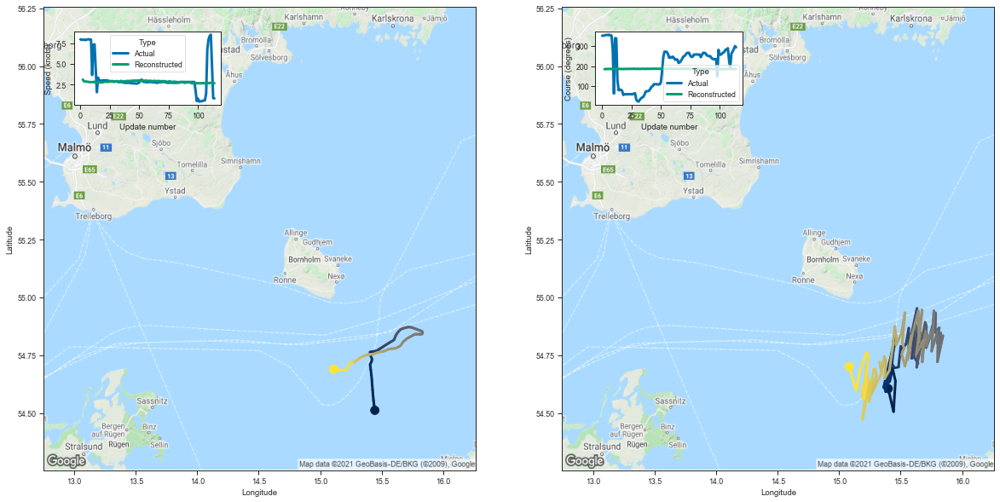

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.399014  54.605370  3.102985  184.666229         0.065864   
3    15.442582  54.505589  2.876987  185.085983         0.044349   
4    15.457859  54.637836  2.873536  185.602432         0.042521   
5    15.434064  54.694256  2.848097  185.686569         0.041193   
6    15.411346  54.636452  2.830736  185.645523         0.041336   
..         ...        ...       ...         ...              ...   
110  15.238717  54.749714  2.689627  185.429993         0.039308   
111  15.222618  54.761753  2.696366  185.423325         0.038278   
112  15.170022  54.683651  2.714226  185.285446         0.038482   
113  15.138053  54.598362  2.614612  184.580215         0.037555   
114  15.081762  54.700165  2.655611  185.319351         0.037513   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.150900     3.124680     99.187675                 1   
3          0.098700     3.004484     99.442451 

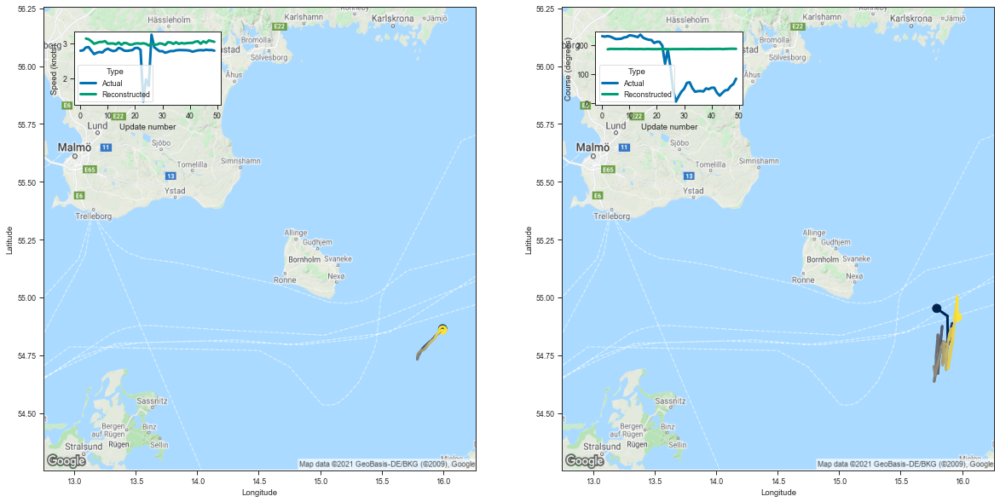

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.793884  54.952194  3.133143  185.441574         0.069506   
3   15.880812  54.919212  3.111446  186.852036         0.048572   
4   15.883216  54.798344  3.054824  186.674225         0.043498   
5   15.909662  54.829445  2.984117  186.557831         0.044228   
6   15.899670  54.815880  3.009104  186.546097         0.044371   
7   15.877671  54.786060  3.034461  186.662674         0.043661   
8   15.895282  54.839359  3.035997  186.634842         0.043950   
9   15.919705  54.887840  3.059497  187.028809         0.044480   
10  15.863469  54.742321  2.988702  186.281830         0.043691   
11  15.876791  54.806454  2.992072  186.519745         0.043588   
12  15.843606  54.719742  2.992852  186.220352         0.044311   
13  15.851290  54.770115  2.969575  186.314957         0.043499   
14  15.844146  54.808575  3.019269  186.661926         0.042490   
15  15.812560  54.740551  2.955954  186.054214         0.04226

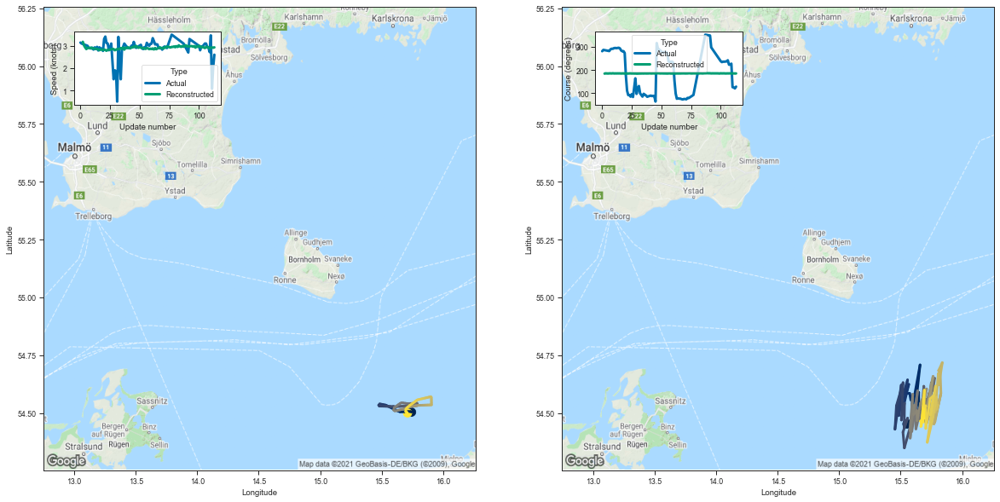

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.551473  54.452408  3.178833  184.539581         0.069461   
3    15.677144  54.526207  3.020195  185.656021         0.048031   
4    15.673625  54.479374  2.927074  185.218231         0.043537   
5    15.652329  54.479137  2.853478  184.974579         0.042281   
6    15.647754  54.534348  2.909979  185.524902         0.043189   
..         ...        ...       ...         ...              ...   
109  15.668091  54.445007  2.870639  184.972183         0.042627   
110  15.664639  54.441936  2.917186  185.128052         0.042425   
111  15.686767  54.517845  2.924013  185.392990         0.042731   
112  15.690512  54.476711  2.913322  185.094910         0.042041   
113  15.680737  54.475101  2.929865  185.243027         0.041969   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.152756     3.098131     99.139046                 1   
3          0.103936     3.035236     99.739738 

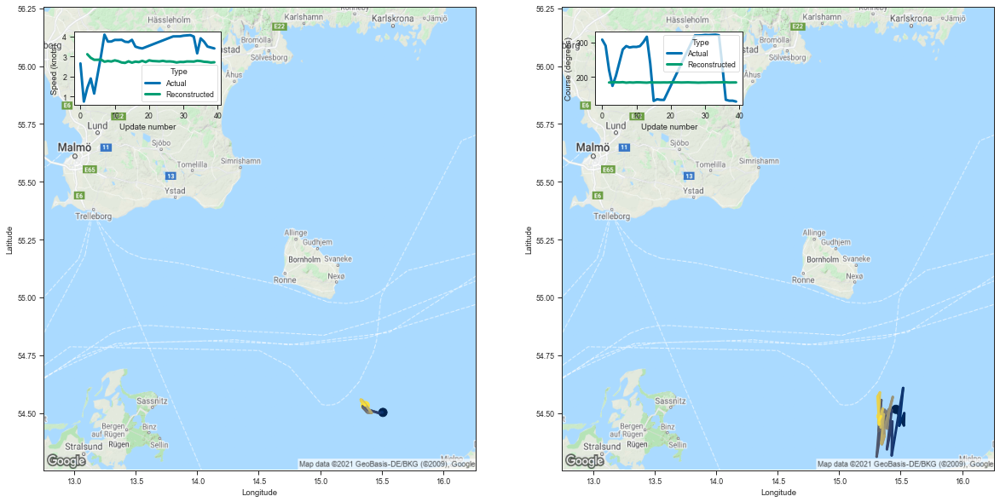

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.461669  54.515778  3.112745  184.484070         0.067843   
3   15.526652  54.446236  2.931012  185.082611         0.044900   
4   15.529506  54.498795  2.832762  185.115814         0.041447   
5   15.488750  54.445190  2.834603  184.838669         0.041175   
6   15.520566  54.608036  2.840638  185.492004         0.042072   
7   15.427430  54.316502  2.738822  184.002747         0.039030   
8   15.432469  54.463203  2.772934  184.857986         0.041213   
9   15.388783  54.343105  2.748784  184.288025         0.039932   
10  15.427368  54.512604  2.804825  185.049866         0.041072   
11  15.402287  54.513641  2.765796  184.944595         0.039587   
12  15.339993  54.425373  2.698850  184.454697         0.039601   
13  15.305099  54.311073  2.679542  184.043518         0.038619   
14  15.342866  54.555862  2.758015  184.987244         0.040600   
15  15.337474  54.533665  2.690333  184.597961         0.03880

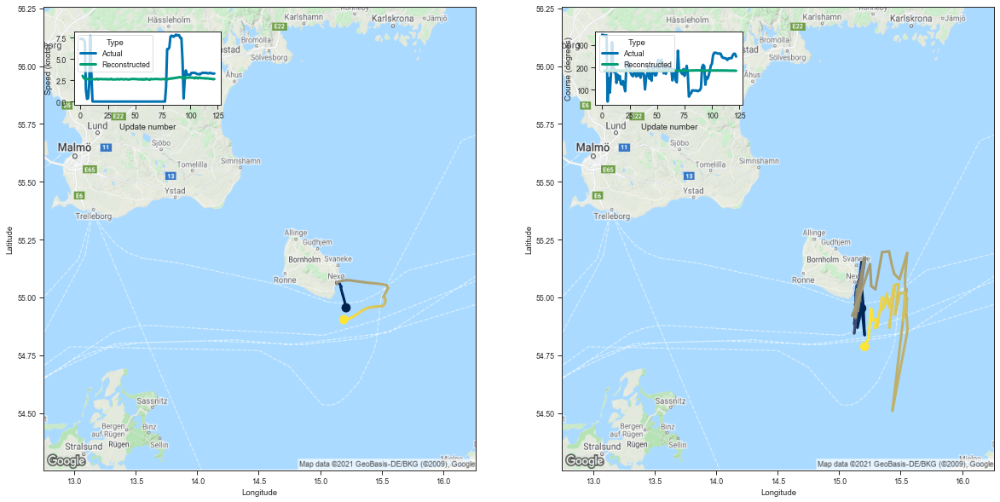

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.183796  54.952438  3.023587  185.763290         0.064265   
3    15.207150  54.837032  2.762396  185.949066         0.042755   
4    15.196597  54.964458  2.669397  186.006500         0.038482   
5    15.183405  55.052170  2.677598  186.361313         0.037831   
6    15.148717  54.869568  2.648631  185.649521         0.037466   
..         ...        ...       ...         ...              ...   
118  15.273410  54.899597  2.653915  185.759644         0.037387   
119  15.278109  54.899437  2.685794  185.981613         0.037526   
120  15.260195  54.951080  2.643025  185.886551         0.037036   
121  15.239554  54.822395  2.609381  185.427719         0.036870   
122  15.207516  54.786903  2.641398  185.355347         0.037598   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.148674     3.225917     99.769066                 1   
3          0.096533     3.037521     99.898964 

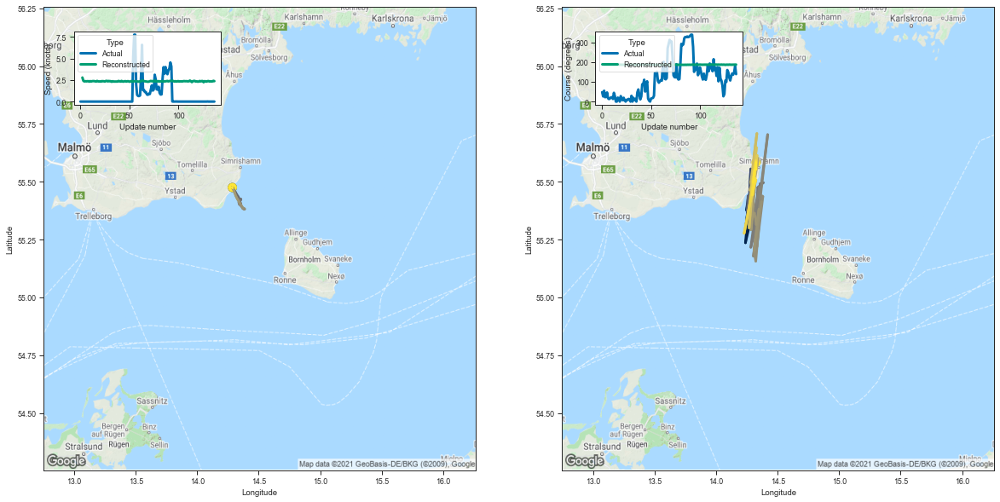

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.291222  55.358223  2.782559  186.481583         0.062375   
3    14.238495  55.236034  2.408500  186.043076         0.037223   
4    14.285650  55.502453  2.333704  186.815598         0.035237   
5    14.244526  55.318020  2.360249  186.337601         0.034402   
6    14.261803  55.398003  2.338981  186.448288         0.033393   
..         ...        ...       ...         ...              ...   
133  14.317472  55.514954  2.344040  186.880478         0.033864   
134  14.302955  55.497677  2.327391  186.834778         0.033501   
135  14.313330  55.552399  2.337970  186.992462         0.033083   
136  14.324675  55.553570  2.400709  187.200668         0.033157   
137  14.325018  55.583179  2.363787  187.226700         0.034421   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.152144     3.443429    100.122459                 1   
3          0.091797     3.211073     99.911583 

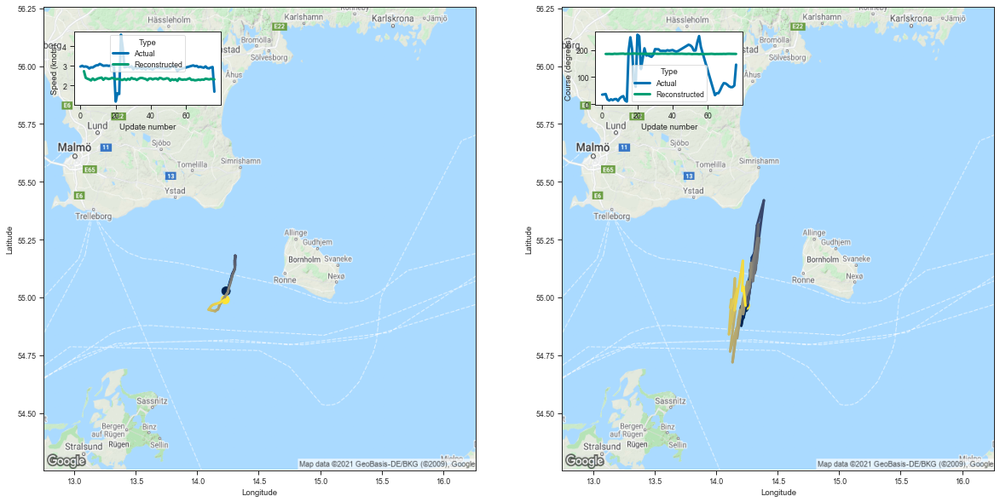

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.227981  54.953594  2.732307  184.982666         0.061418   
3   14.204461  54.877415  2.393553  184.903458         0.038462   
4   14.249175  54.992214  2.344347  185.213058         0.035546   
5   14.222189  54.911144  2.310418  184.750320         0.033850   
6   14.246959  54.966862  2.257111  184.646088         0.033043   
..        ...        ...       ...         ...              ...   
72  14.217385  55.157967  2.329971  185.637497         0.034649   
73  14.218121  55.107040  2.309057  185.374786         0.034732   
74  14.211407  55.028027  2.334036  185.251358         0.034014   
75  14.222065  55.045834  2.321149  185.251831         0.034749   
76  14.238941  54.964119  2.312361  185.009567         0.034332   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.147688     3.394409     99.330887                 1   
3         0.092270     3.178407     99.309883                

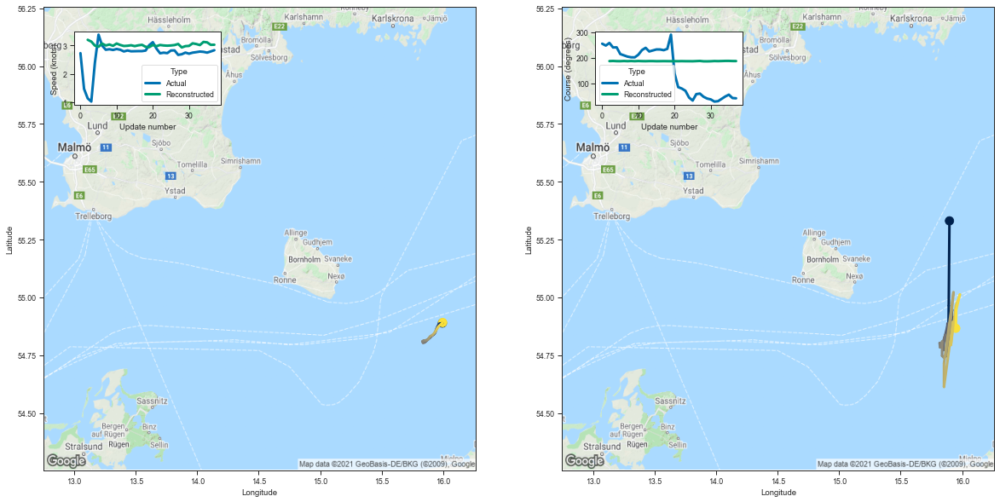

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.896976  55.330803  3.198422  186.746780         0.072820   
3   15.891157  54.964184  3.136116  187.342834         0.049175   
4   15.888624  54.848671  2.994735  186.595337         0.044645   
5   15.911682  54.853958  2.952722  186.420044         0.042565   
6   15.901374  54.921928  3.066156  187.111023         0.042610   
7   15.876311  54.763142  2.998444  186.499313         0.043423   
8   15.918425  54.946438  3.033961  187.123581         0.044552   
9   15.881898  54.785156  2.986721  186.449173         0.042878   
10  15.923530  54.914635  3.067597  187.115372         0.044343   
11  15.897038  54.798580  3.016539  186.625641         0.044906   
12  15.870954  54.745644  2.980690  186.392181         0.042955   
13  15.880967  54.886353  2.988366  186.840668         0.042596   
14  15.885278  54.886124  3.006328  186.811508         0.043984   
15  15.842316  54.792667  2.976033  186.354309         0.04423

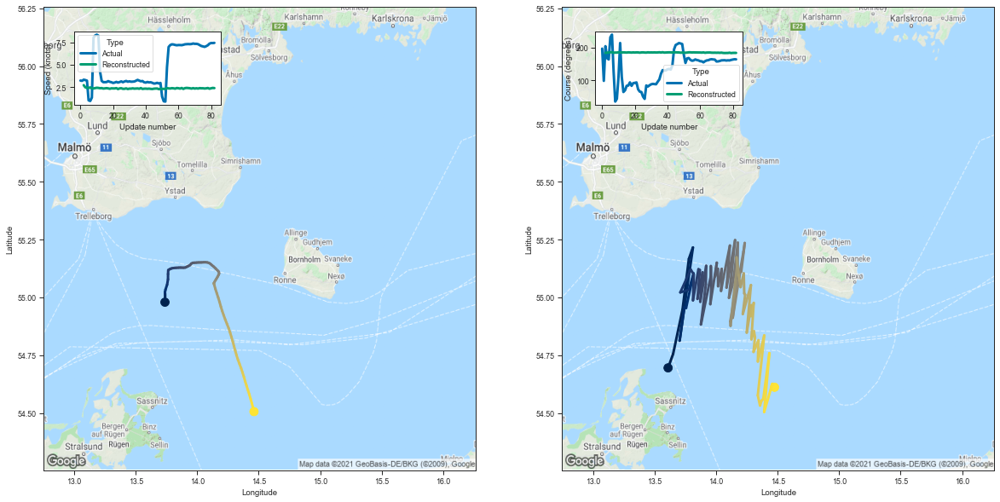

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   13.609625  54.694984  2.703839  184.007767         0.071627   
3   13.650624  54.755623  2.465741  184.717941         0.046459   
4   13.726958  54.946625  2.394312  185.150253         0.042509   
5   13.778648  55.166389  2.397970  185.841980         0.043323   
6   13.811662  55.215755  2.452290  186.255585         0.043182   
..        ...        ...       ...         ...              ...   
78  14.433084  54.758736  2.386979  184.609344         0.035192   
79  14.390524  54.504108  2.307507  183.485107         0.034932   
80  14.457096  54.626129  2.354138  184.032394         0.035520   
81  14.464596  54.606976  2.395950  184.081345         0.035462   
82  14.474989  54.611252  2.377250  184.019379         0.035072   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.160206     3.589467     98.743263                 1   
3         0.103012     3.474867     99.149338                

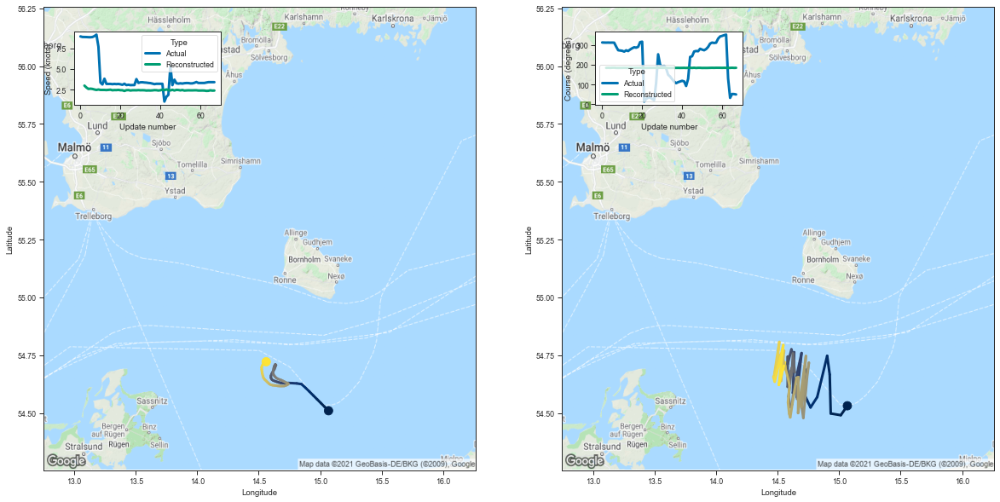

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.066953  54.531132  2.979764  184.289902         0.064249   
3   15.013488  54.490364  2.746402  184.786530         0.042144   
4   14.931814  54.497704  2.574215  184.270096         0.038741   
5   14.923660  54.665863  2.607974  184.970230         0.038665   
6   14.902925  54.746906  2.575471  185.121201         0.036852   
..        ...        ...       ...         ...              ...   
63  14.465866  54.655647  2.337601  184.152267         0.034992   
64  14.476131  54.635353  2.347864  184.148438         0.034519   
65  14.546386  54.793877  2.408183  184.703308         0.034872   
66  14.509779  54.621311  2.370128  184.107742         0.033989   
67  14.551270  54.704533  2.380250  184.441513         0.035206   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.149503     3.162610     98.994682                 1   
3         0.094529     3.051496     99.272713                

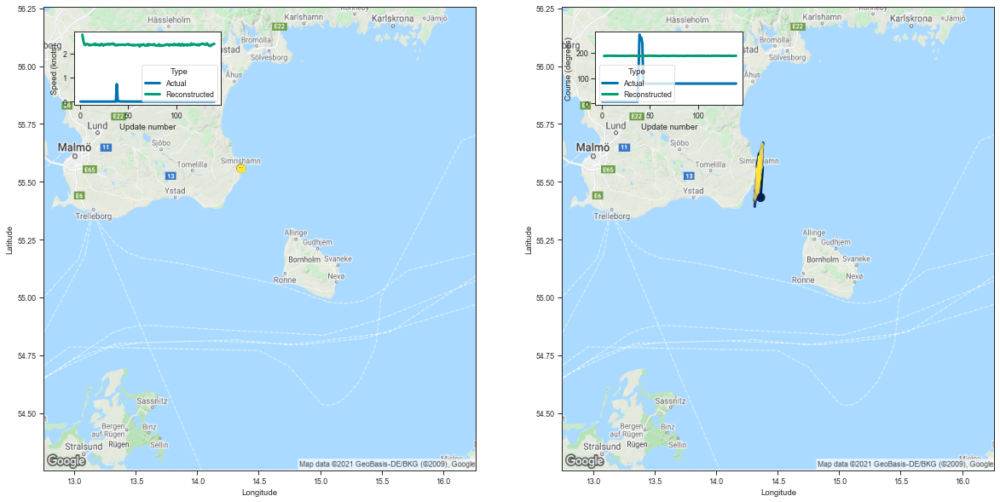

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.361259  55.432327  2.788488  186.374451         0.060238   
3    14.378931  55.562283  2.539214  187.604843         0.038369   
4    14.325561  55.442642  2.389194  186.682755         0.034844   
5    14.333771  55.575665  2.351404  187.105331         0.033778   
6    14.348708  55.621132  2.395914  187.316620         0.034267   
..         ...        ...       ...         ...              ...   
136  14.340651  55.515285  2.309765  186.750641         0.033340   
137  14.329376  55.554707  2.366291  187.056396         0.033721   
138  14.338811  55.505852  2.375851  186.880341         0.033086   
139  14.349901  55.607300  2.402755  187.342484         0.033508   
140  14.351704  55.501694  2.399969  187.024628         0.033937   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.145239     3.419365    100.059822                 1   
3          0.091880     3.257199    100.730988 

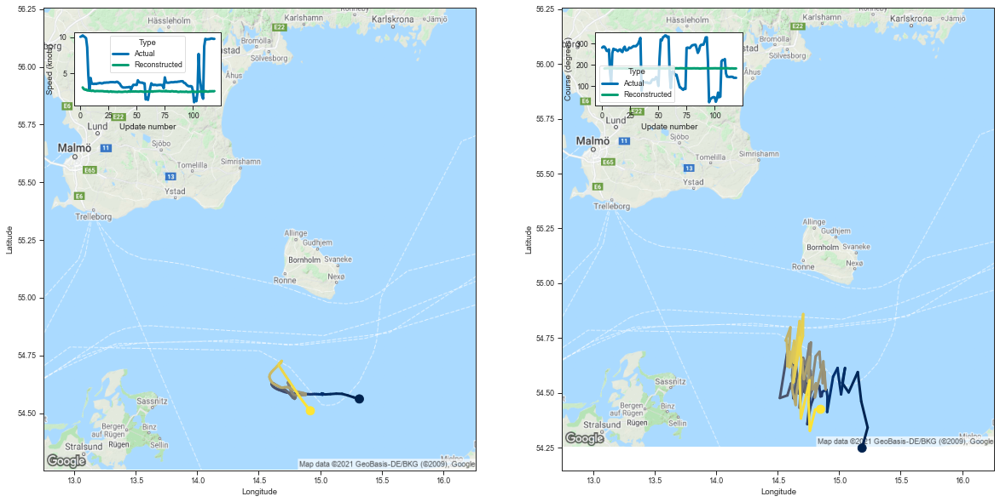

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.186456  54.248123  3.015073  183.429810         0.063692   
3    15.231935  54.341694  2.790001  184.454849         0.043633   
4    15.179736  54.461514  2.710735  184.616379         0.040880   
5    15.151601  54.594727  2.732858  185.077988         0.040737   
6    15.077707  54.502102  2.604219  184.303772         0.038772   
..         ...        ...       ...         ...              ...   
115  14.759956  54.556862  2.502244  184.220612         0.036535   
116  14.750827  54.462139  2.467576  183.963852         0.035956   
117  14.762084  54.326897  2.502110  183.519638         0.036085   
118  14.805862  54.424187  2.473506  183.660690         0.036585   
119  14.848983  54.424953  2.509441  183.736572         0.036302   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.146617     3.128528     98.522491                 1   
3          0.096464     3.004357     99.094795 

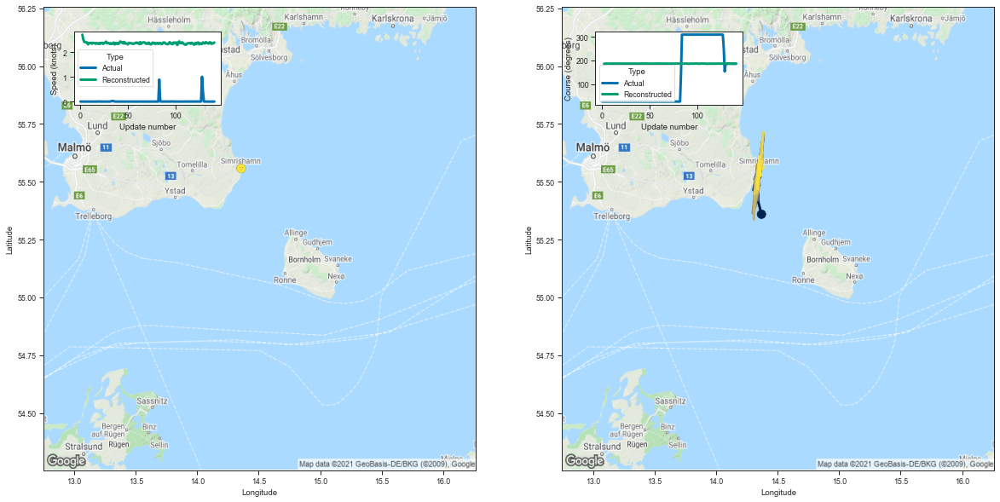

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.368920  55.359425  2.713309  185.937714         0.060659   
3    14.341578  55.415909  2.520827  187.045441         0.038540   
4    14.342016  55.512768  2.421454  187.112000         0.035478   
5    14.361409  55.550377  2.412618  187.046143         0.034822   
6    14.344249  55.509254  2.392755  186.981873         0.034244   
..         ...        ...       ...         ...              ...   
137  14.336737  55.469364  2.394594  186.827225         0.033024   
138  14.341721  55.513077  2.334744  186.860382         0.033537   
139  14.348993  55.549885  2.359329  187.083832         0.033188   
140  14.363782  55.526577  2.361885  187.037750         0.034247   
141  14.354750  55.564198  2.395037  187.158905         0.033387   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.150427     3.373820     99.864830                 1   
3          0.091225     3.258124    100.431000 

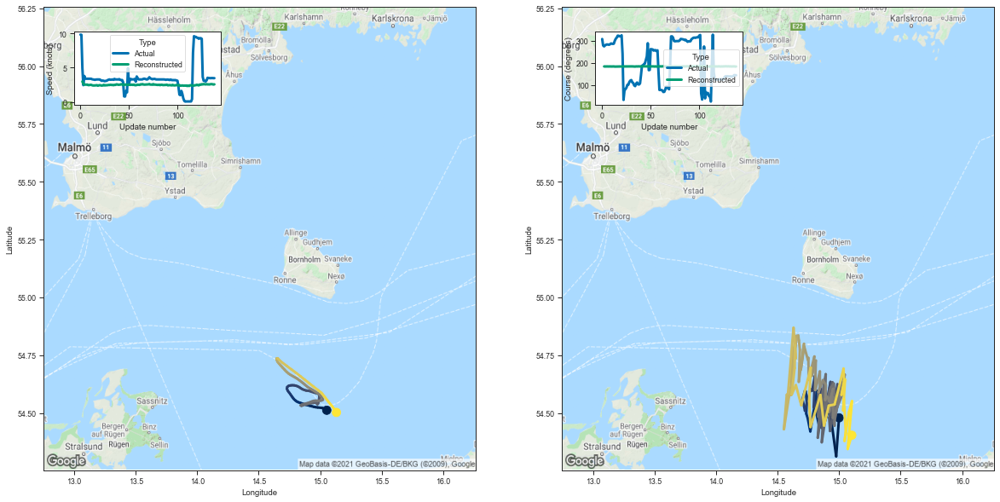

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.999210  54.479061  3.008401  184.172882         0.065011   
3    14.976172  54.312454  2.647114  183.934387         0.041050   
4    14.938974  54.457787  2.539464  183.997726         0.038027   
5    14.919493  54.521919  2.547455  184.272202         0.036092   
6    14.880880  54.457508  2.541431  184.030472         0.035751   
..         ...        ...       ...         ...              ...   
134  15.043985  54.378971  2.607381  184.067474         0.036792   
135  15.079585  54.502140  2.620494  184.305023         0.037430   
136  15.104909  54.551208  2.601227  184.482513         0.037337   
137  15.069542  54.344196  2.561883  183.685928         0.037129   
138  15.103054  54.403805  2.587027  183.933548         0.037130   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.146149     3.201122     98.924683                 1   
3          0.092906     2.987760     98.830208 

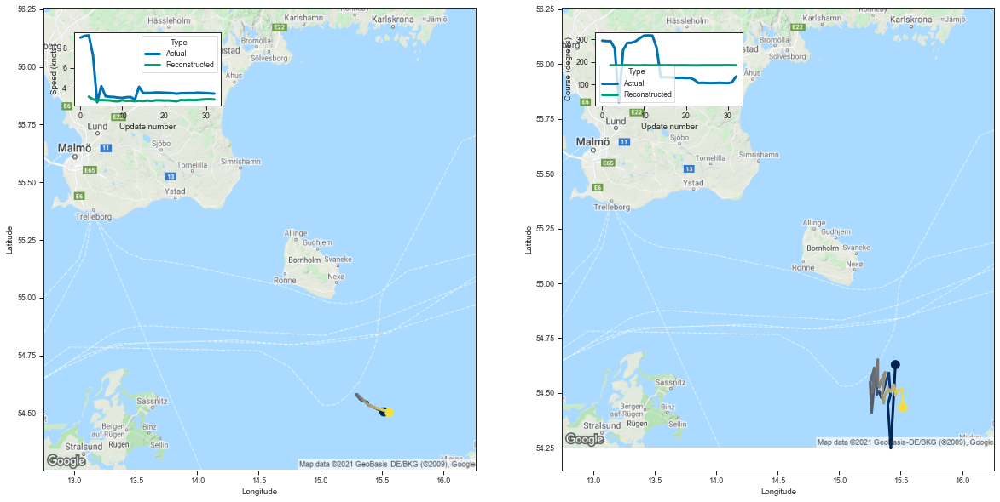

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.457615  54.629101  3.117406  184.833572         0.068903   
3   15.420293  54.249012  2.848563  184.212128         0.045134   
4   15.395751  54.445736  2.749792  184.444382         0.041092   
5   15.417310  54.490585  2.778884  184.914322         0.041570   
6   15.404304  54.591621  2.762685  185.142395         0.041386   
7   15.342326  54.479717  2.744484  184.776108         0.040014   
8   15.324319  54.508709  2.678289  184.603653         0.039350   
9   15.305357  54.492702  2.651384  184.498322         0.038458   
10  15.309170  54.585869  2.763175  185.211929         0.040360   
11  15.287307  54.549717  2.702680  184.902405         0.039548   
12  15.264902  54.411972  2.716554  184.455368         0.038756   
13  15.251876  54.546402  2.666174  184.750183         0.038378   
14  15.286037  54.614693  2.713381  185.075424         0.039644   
15  15.269666  54.501289  2.679554  184.613449         0.03896

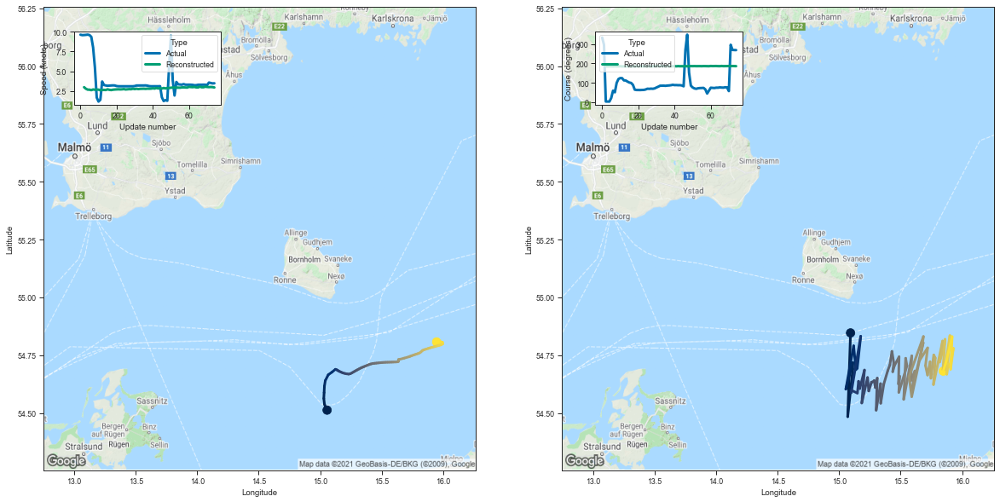

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.092901  54.846169  2.982889  185.250214         0.065691   
3   15.069823  54.483917  2.788685  184.953552         0.042595   
4   15.111134  54.689495  2.673017  185.276886         0.039791   
5   15.111523  54.718235  2.669320  185.264862         0.038924   
6   15.054646  54.602894  2.609438  184.697357         0.038270   
..        ...        ...       ...         ...              ...   
70  15.928725  54.779598  3.013968  186.562866         0.043956   
71  15.906163  54.688995  2.994416  186.248459         0.044131   
72  15.918730  54.830086  3.011012  186.631714         0.043986   
73  15.871898  54.725674  2.993925  186.295761         0.043901   
74  15.846245  54.680912  2.949347  185.869797         0.043755   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.153644     3.188313     99.522148                 1   
3         0.094659     3.050811     99.356735                

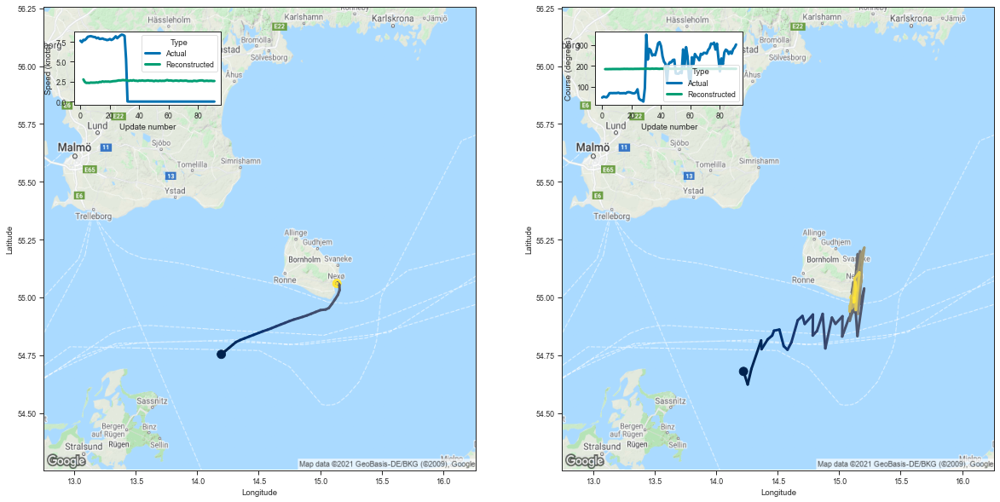

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.222769  54.679718  2.782471  184.306595         0.065863   
3   14.256727  54.623253  2.464446  184.357452         0.040267   
4   14.286853  54.690544  2.343109  184.223358         0.035828   
5   14.365993  54.813709  2.357648  184.586349         0.035295   
6   14.369431  54.775658  2.336615  184.411011         0.035041   
..        ...        ...       ...         ...              ...   
87  15.137943  55.029259  2.586890  185.944901         0.035874   
88  15.132987  55.064865  2.604871  186.203964         0.035904   
89  15.127837  54.982822  2.608005  185.928314         0.035878   
90  15.118786  54.978374  2.580306  185.869492         0.035261   
91  15.121435  54.999046  2.585926  185.897659         0.036017   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.151525     3.401720     98.958359                 1   
3         0.092830     3.148412     99.022377                

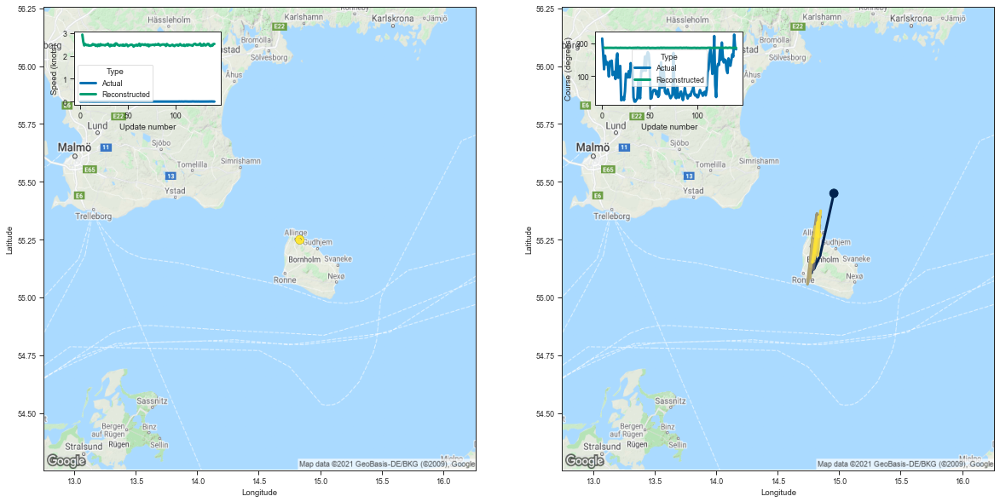

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.957415  55.449944  2.940547  187.061462         0.059900   
3    14.845622  55.181335  2.627887  186.535950         0.037755   
4    14.796853  55.124130  2.463523  185.869797         0.034573   
5    14.823282  55.248257  2.525901  186.643295         0.035620   
6    14.813115  55.258408  2.489877  186.408051         0.034098   
..         ...        ...       ...         ...              ...   
137  14.825513  55.325459  2.439334  186.424377         0.034041   
138  14.800161  55.191769  2.480188  186.292999         0.033973   
139  14.825473  55.292431  2.459046  186.455643         0.033255   
140  14.831834  55.261395  2.527712  186.713333         0.034060   
141  14.820107  55.268467  2.531344  186.646957         0.034944   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.146072     3.279772    100.476578                 1   
3          0.088810     3.133333    100.210854 

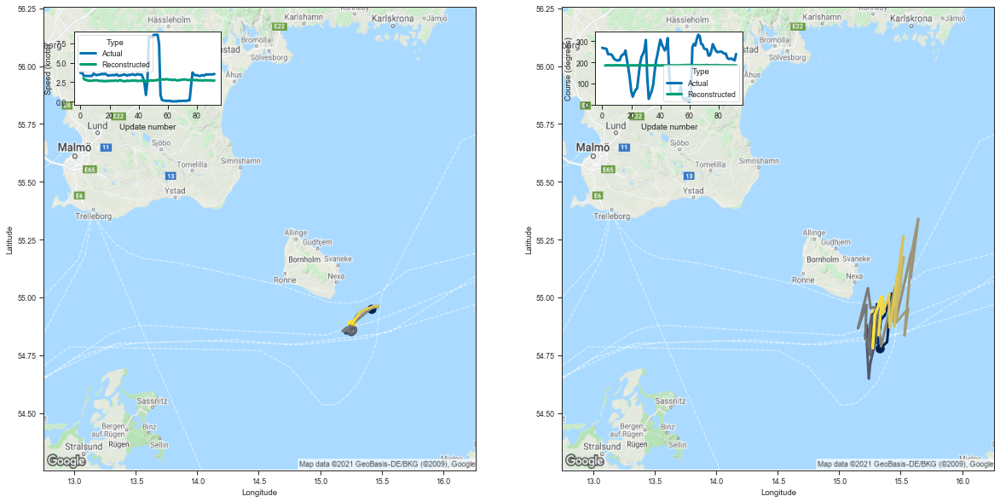

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.332980  54.777893  3.014401  185.121658         0.063067   
3   15.389941  54.807343  2.815466  185.855408         0.041654   
4   15.425824  55.015331  2.806099  186.595718         0.039835   
5   15.370940  54.921707  2.714811  186.031647         0.037943   
6   15.340277  54.903301  2.690793  185.859177         0.038400   
..        ...        ...       ...         ...              ...   
88  15.334165  54.906883  2.745302  186.225601         0.038565   
89  15.340547  55.002438  2.730204  186.393936         0.038224   
90  15.289117  54.917995  2.742022  186.176224         0.038524   
91  15.272537  54.780201  2.673551  185.451370         0.037606   
92  15.291426  54.927544  2.728424  186.183929         0.038332   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.145507     3.097402     99.459641                 1   
3         0.092514     3.011166     99.846825                

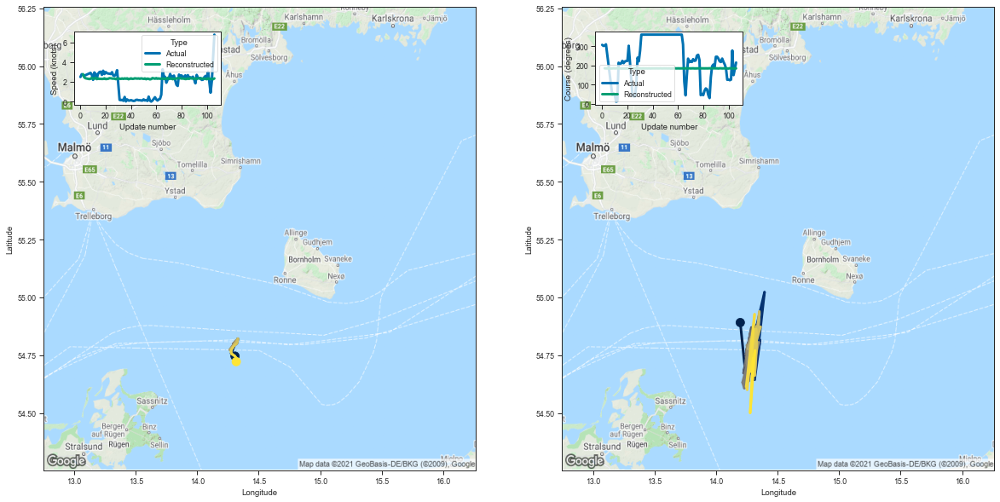

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.196349  54.891029  2.781182  184.877899         0.062871   
3    14.233720  54.697693  2.463123  184.572983         0.040084   
4    14.242471  54.755985  2.368224  184.334457         0.035704   
5    14.247560  54.665298  2.337559  184.185089         0.035133   
6    14.273271  54.716576  2.312781  184.226410         0.035016   
..         ...        ...       ...         ...              ...   
102  14.283623  54.711811  2.312073  184.153366         0.034316   
103  14.274974  54.678455  2.286713  184.009659         0.033589   
104  14.316301  54.770229  2.312050  184.424362         0.034524   
105  14.276964  54.500767  2.268816  183.424118         0.034435   
106  14.300482  54.737362  2.350122  184.343735         0.034151   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.147281     3.403897     99.246086                 1   
3          0.092956     3.191293     99.147690 

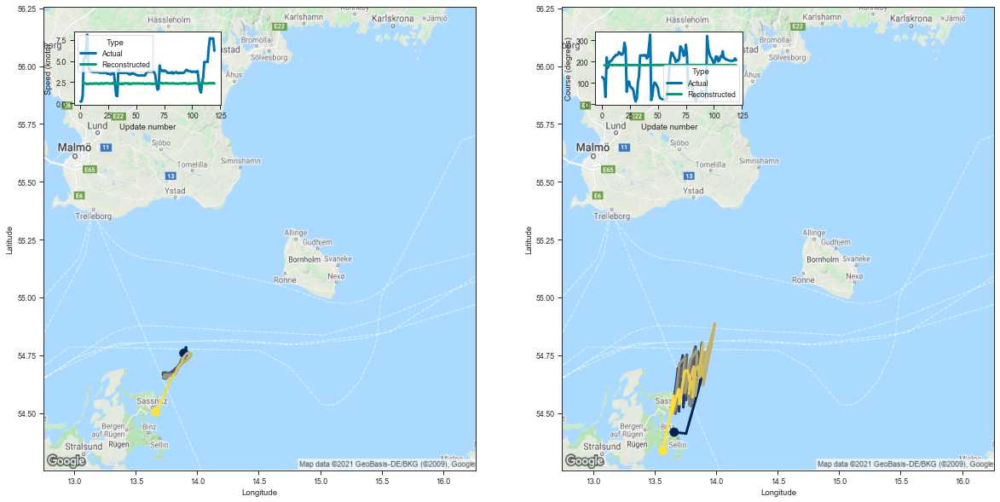

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    13.658903  54.417065  2.621316  182.858322         0.067776   
3    13.755692  54.410999  2.365302  183.266891         0.042710   
4    13.888599  54.662495  2.372219  184.115128         0.039918   
5    13.883939  54.799416  2.309417  184.377747         0.039486   
6    13.888983  54.694675  2.305142  184.106598         0.038643   
..         ...        ...       ...         ...              ...   
116  13.676825  54.569679  2.382873  183.870300         0.043315   
117  13.641716  54.498489  2.358286  183.626633         0.044155   
118  13.653040  54.574783  2.389551  183.993561         0.043131   
119  13.600829  54.422287  2.411199  183.426193         0.043137   
120  13.565739  54.337223  2.335060  183.039200         0.045069   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.153900     3.460993     98.153778                 1   
3          0.094094     3.252071     98.388779 

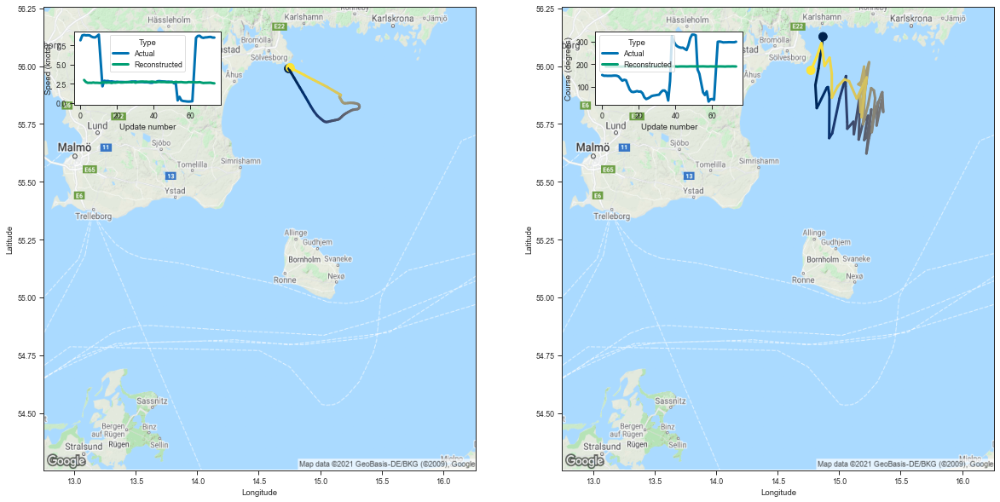

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.868682  56.127556  2.991295  189.038651         0.064816   
3   14.832220  55.989815  2.723811  189.291275         0.040616   
4   14.806954  55.918056  2.617227  188.932602         0.036710   
5   14.818190  55.818417  2.628818  188.730591         0.036742   
6   14.834621  55.835384  2.615682  188.765717         0.036483   
..        ...        ...       ...         ...              ...   
69  14.922839  56.036598  2.619153  189.413086         0.035682   
70  14.881251  56.000916  2.629754  189.215500         0.036209   
71  14.856107  56.099262  2.633641  189.707825         0.036341   
72  14.818346  56.040672  2.578650  189.367477         0.036200   
73  14.770278  55.981724  2.552791  189.083939         0.036488   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.160810     3.425177    101.509514                 1   
3         0.098198     3.299680    101.651588                

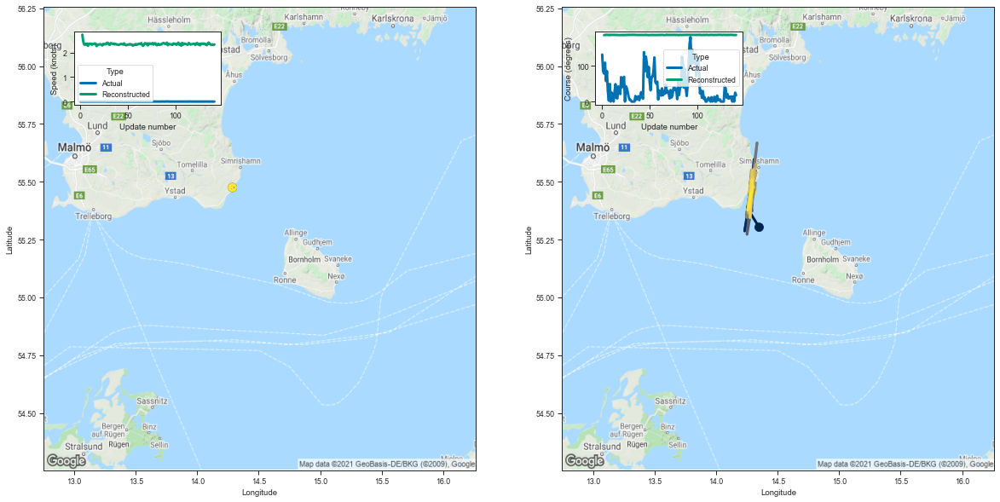

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.349903  55.303143  2.737659  185.865173         0.060047   
3    14.272637  55.369427  2.455731  186.786514         0.037951   
4    14.280018  55.463459  2.327863  186.657349         0.034669   
5    14.309438  55.597466  2.358222  187.216232         0.034518   
6    14.285194  55.428272  2.328047  186.491592         0.032971   
..         ...        ...       ...         ...              ...   
137  14.300196  55.476665  2.333617  186.709198         0.033235   
138  14.273160  55.414505  2.312503  186.462112         0.033519   
139  14.275853  55.395706  2.341169  186.429413         0.034168   
140  14.256073  55.377476  2.312202  186.272949         0.033867   
141  14.289293  55.456326  2.336245  186.625031         0.033728   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.145132     3.375041     99.781746                 1   
3          0.090607     3.240956    100.314316 

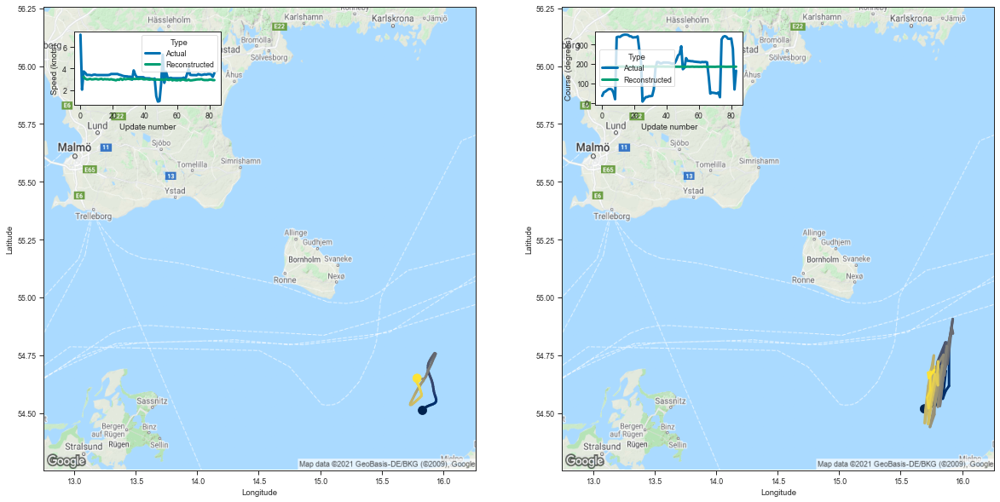

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.693676  54.517838  3.232345  184.715958         0.071143   
3   15.798981  54.535763  3.062688  185.708389         0.047493   
4   15.809578  54.573395  2.989132  185.818573         0.045138   
5   15.846505  54.673462  3.009624  186.071960         0.044324   
6   15.867491  54.681160  3.051196  186.180023         0.044387   
..        ...        ...       ...         ...              ...   
79  15.740329  54.597343  2.934181  185.708954         0.042588   
80  15.742033  54.677994  2.975634  186.095261         0.043126   
81  15.723646  54.674160  2.980813  186.126556         0.043253   
82  15.728685  54.651932  2.933768  185.831909         0.042724   
83  15.773120  54.686157  2.928450  185.988373         0.043418   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.158693     3.104328     99.239418                 1   
3         0.100800     2.978903     99.765060                

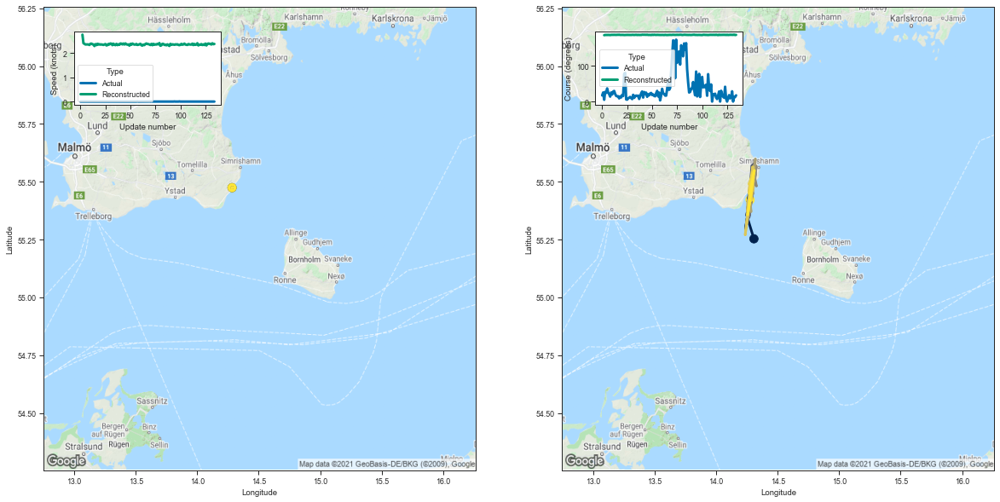

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.307436  55.253220  2.753421  185.801376         0.058695   
3    14.253220  55.346561  2.401956  186.434814         0.037816   
4    14.264035  55.360710  2.374231  186.482574         0.035134   
5    14.266389  55.449226  2.348285  186.578796         0.034436   
6    14.266005  55.403572  2.350524  186.513916         0.034520   
..         ...        ...       ...         ...              ...   
130  14.287772  55.489944  2.367694  186.961548         0.034438   
131  14.283770  55.477242  2.347955  186.742584         0.033539   
132  14.310574  55.548782  2.396018  187.342957         0.035596   
133  14.256648  55.357529  2.359857  186.315109         0.034375   
134  14.276124  55.421989  2.370362  186.690643         0.034325   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.142150     3.367564     99.757195                 1   
3          0.093045     3.217523    100.119476 

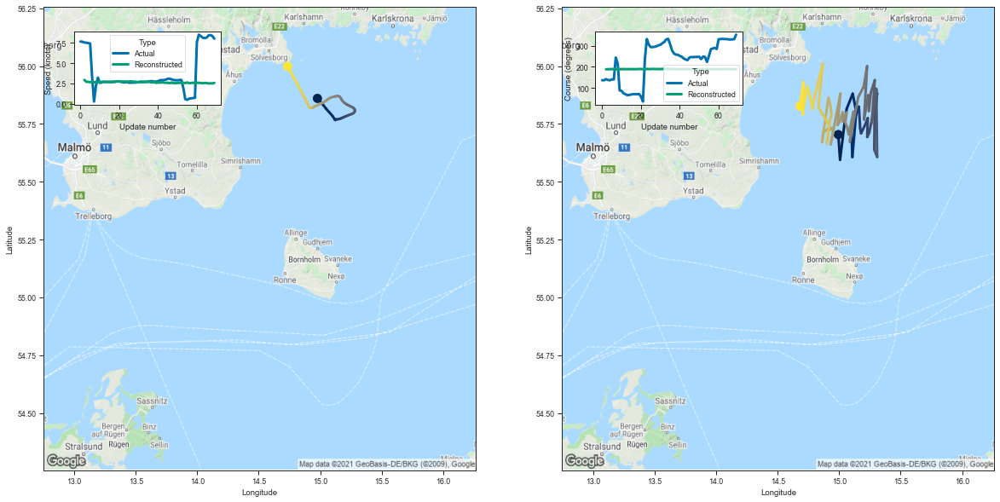

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.993261  55.704094  2.941342  187.782928         0.060760   
3   15.007599  55.594719  2.717860  188.178070         0.039624   
4   15.042896  55.747887  2.705733  188.674606         0.037546   
5   15.061644  55.815411  2.664524  188.705063         0.035993   
6   15.110462  55.880798  2.708793  189.113663         0.037250   
..        ...        ...       ...         ...              ...   
65  14.766166  55.864845  2.555785  188.576996         0.035475   
66  14.740110  55.911415  2.508296  188.594650         0.034724   
67  14.702197  55.788914  2.521329  188.129593         0.034842   
68  14.710975  55.931232  2.513620  188.644226         0.035259   
69  14.681305  55.827126  2.573362  188.609406         0.035789   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.148480     3.295402    100.860596                 1   
3         0.093412     3.161877    101.059837                

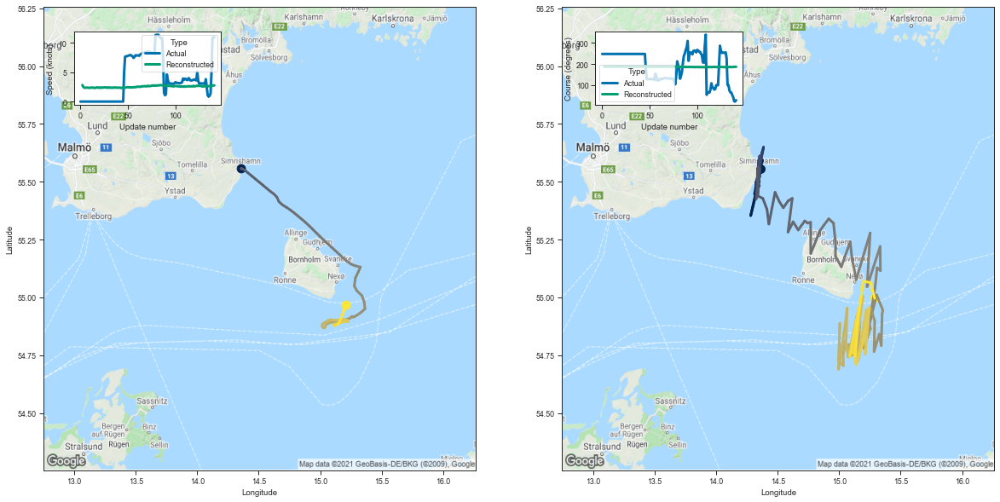

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.364745  55.554344  2.807943  186.961777         0.061021   
3    14.281426  55.353596  2.495458  186.745697         0.037713   
4    14.350825  55.503593  2.370864  186.937775         0.034755   
5    14.327664  55.462109  2.331033  186.708282         0.033233   
6    14.312562  55.447399  2.365615  186.740234         0.033501   
..         ...        ...       ...         ...              ...   
137  15.128456  54.743805  2.590769  185.096130         0.036807   
138  15.146362  54.878551  2.609174  185.530472         0.036745   
139  15.195875  55.069748  2.713515  186.659073         0.038918   
140  15.256387  55.063713  2.743052  186.526108         0.039594   
141  15.288940  54.995449  2.743052  186.362946         0.039412   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.147048     3.427270    100.368698                 1   
3          0.090757     3.271161    100.289284 

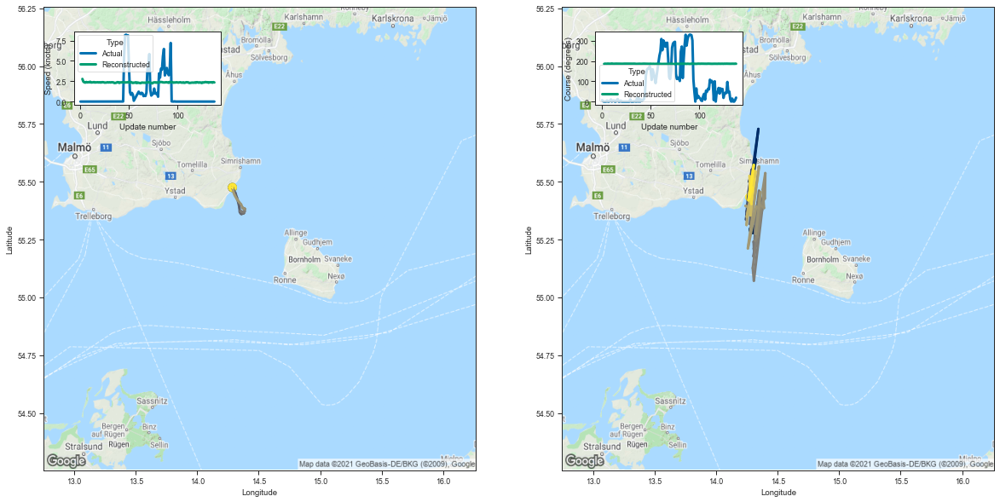

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.301346  55.292465  2.784310  186.039429         0.059808   
3    14.272077  55.419426  2.451956  186.860016         0.038719   
4    14.266176  55.407040  2.369107  186.546936         0.035296   
5    14.261844  55.412518  2.332770  186.542938         0.034450   
6    14.322712  55.597359  2.411021  187.380112         0.035613   
..         ...        ...       ...         ...              ...   
134  14.289944  55.456551  2.368059  186.811569         0.034224   
135  14.295320  55.475540  2.378487  186.851044         0.034751   
136  14.262255  55.419662  2.323056  186.458389         0.034147   
137  14.306075  55.572754  2.389616  187.160202         0.034624   
138  14.272662  55.433437  2.352809  186.632538         0.033855   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.145611     3.428531     99.879463                 1   
3          0.091709     3.238665    100.334946 

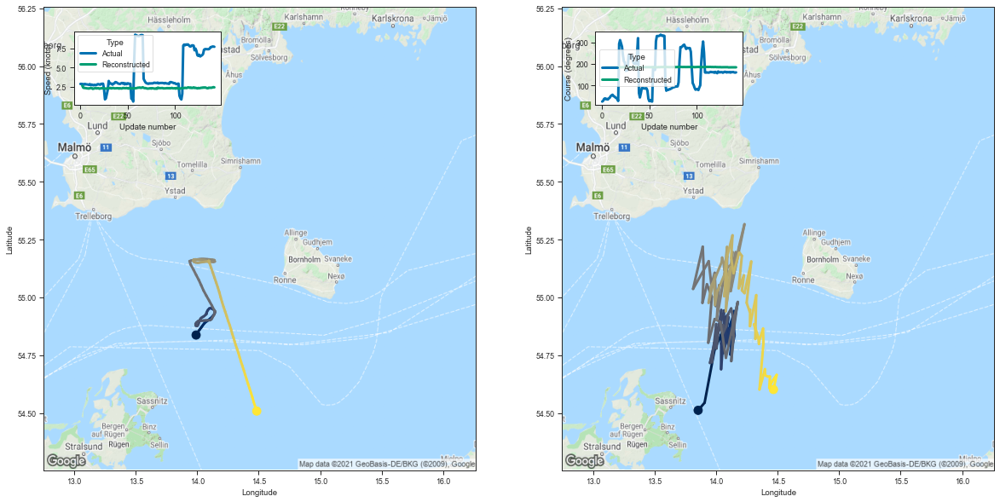

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    13.853998  54.511559  2.644175  183.188431         0.063353   
3    13.906569  54.544464  2.383039  183.890015         0.041949   
4    13.987747  54.773972  2.347861  184.511230         0.038111   
5    14.048630  54.848236  2.342539  184.673035         0.035965   
6    14.046614  54.835812  2.313073  184.478958         0.036068   
..         ...        ...       ...         ...              ...   
138  14.437793  54.657543  2.381422  184.212875         0.036168   
139  14.432167  54.608410  2.371213  184.076340         0.035582   
140  14.453620  54.635639  2.408524  184.188538         0.035886   
141  14.492340  54.664597  2.455074  184.489899         0.035467   
142  14.466239  54.601555  2.425967  184.180298         0.036031   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.147717     3.413418     98.325226                 1   
3          0.093786     3.250735     98.735832 

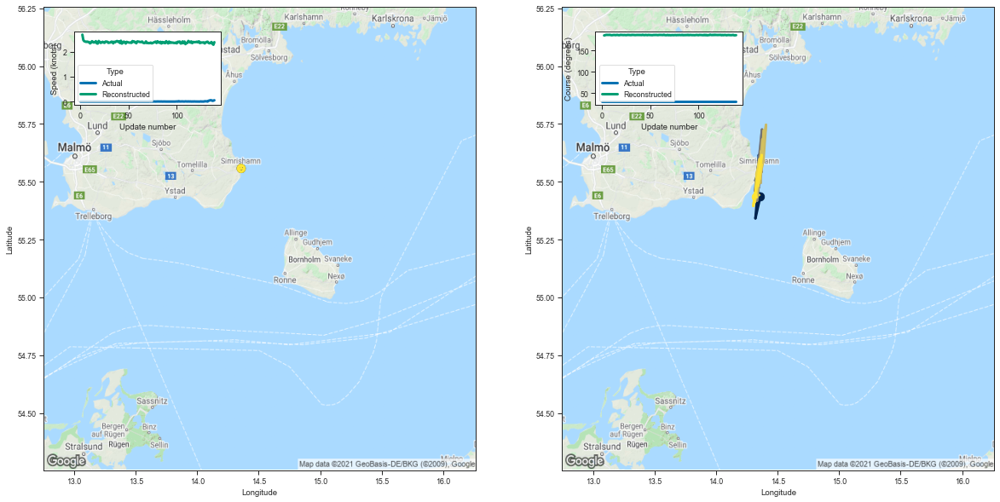

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.358731  55.434765  2.682438  186.090942         0.058315   
3    14.319627  55.341774  2.466939  186.628082         0.039200   
4    14.361135  55.587936  2.417348  187.414032         0.035233   
5    14.365771  55.598679  2.403051  187.398788         0.034224   
6    14.333078  55.528332  2.390482  187.172745         0.034054   
..         ...        ...       ...         ...              ...   
135  14.364905  55.584938  2.355375  187.128220         0.034507   
136  14.371067  55.615078  2.387000  187.321671         0.033941   
137  14.302444  55.395370  2.314054  186.396530         0.033307   
138  14.318512  55.453339  2.277525  186.452377         0.032816   
139  14.327247  55.433315  2.379479  186.720581         0.033794   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.146825     3.356802     99.957771                 1   
3          0.092408     3.258878    100.217819 

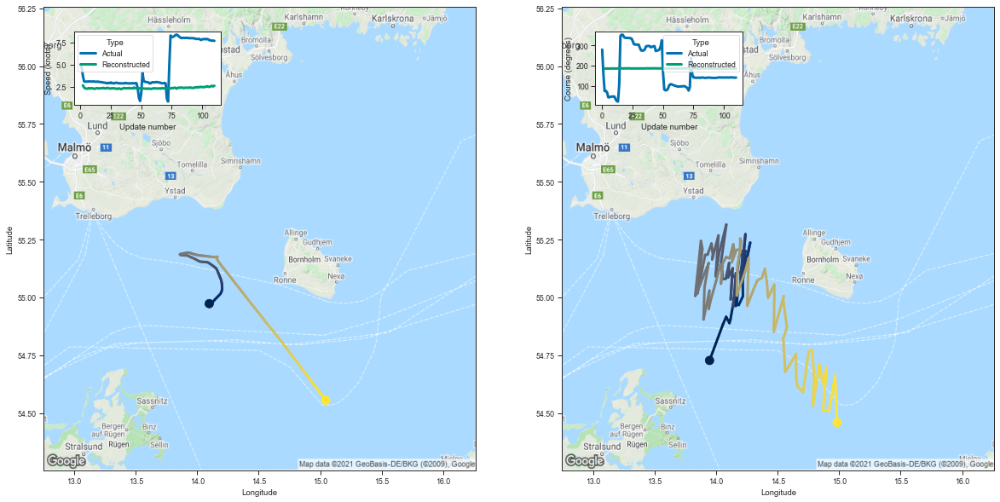

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    13.946778  54.727180  2.681309  184.160919         0.063972   
3    14.055223  54.882751  2.429130  184.983215         0.040207   
4    14.081751  54.915783  2.322635  184.939423         0.036880   
5    14.108508  54.888664  2.304513  184.743317         0.036163   
6    14.116684  54.904831  2.298854  184.800705         0.034646   
..         ...        ...       ...         ...              ...   
106  14.868941  54.512783  2.505790  184.180969         0.035862   
107  14.918283  54.508595  2.562937  184.349274         0.036750   
108  14.966452  54.661339  2.617658  185.019211         0.037367   
109  14.979977  54.514507  2.555943  184.311539         0.037045   
110  14.983348  54.458244  2.625567  184.269913         0.036944   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.149591     3.445705     98.867790                 1   
3          0.094974     3.293249     99.330940 

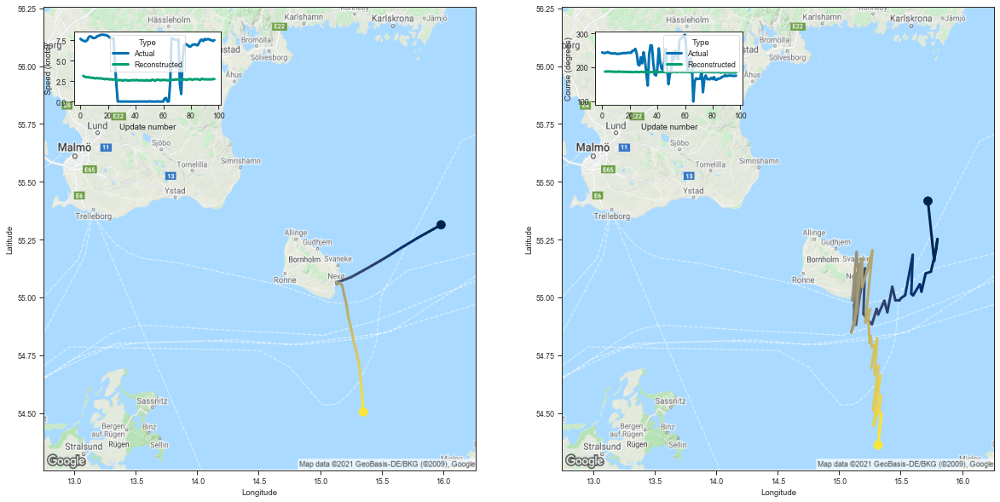

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.722040  55.416576  3.142351  187.137527         0.067436   
3   15.773004  55.157410  3.046747  187.575119         0.045883   
4   15.799328  55.252178  2.980107  187.834824         0.042445   
5   15.789932  55.210304  2.966050  187.755768         0.042156   
6   15.746026  55.111130  2.957889  187.413666         0.042578   
..        ...        ...       ...         ...              ...   
93  15.341130  54.500992  2.723941  184.603165         0.039825   
94  15.323237  54.411446  2.689672  184.330124         0.040213   
95  15.343579  54.491661  2.718462  184.642014         0.039309   
96  15.325976  54.397705  2.735633  184.446030         0.039440   
97  15.317500  54.361282  2.753619  184.398987         0.039428   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.161145     3.143581    100.538483                 1   
3         0.102485     3.061316    100.776550                

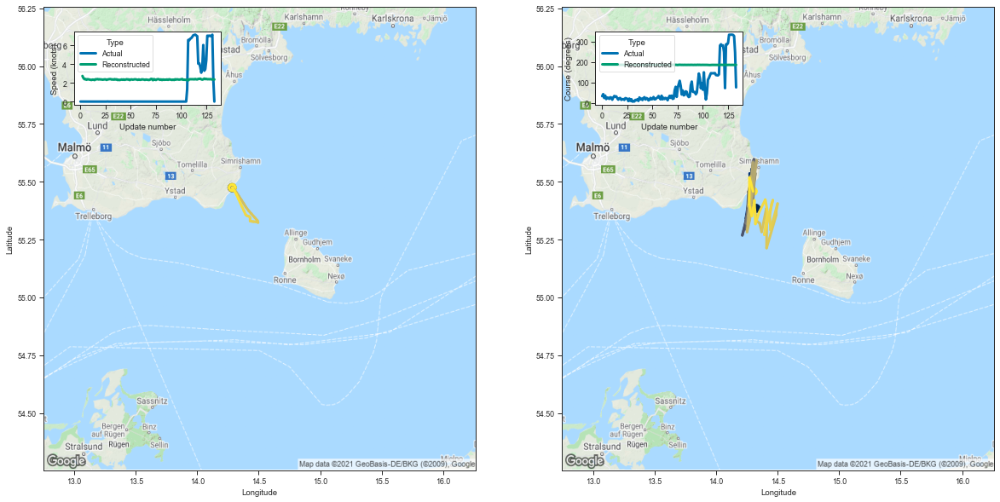

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.324664  55.384510  2.727016  186.133286         0.059856   
3    14.275116  55.377640  2.501725  186.890594         0.038424   
4    14.283540  55.505703  2.380274  186.980072         0.034842   
5    14.264483  55.436089  2.400949  186.802216         0.034898   
6    14.260770  55.391872  2.324774  186.402649         0.033459   
..         ...        ...       ...         ...              ...   
129  14.311388  55.419720  2.391235  186.717209         0.035469   
130  14.290256  55.351795  2.366502  186.382950         0.035172   
131  14.268858  55.400944  2.366105  186.512970         0.034830   
132  14.270989  55.517612  2.362461  186.857773         0.035071   
133  14.300632  55.458366  2.350719  186.707932         0.034543   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.147053     3.360059     99.935623                 1   
3          0.092907     3.304159    100.356628 

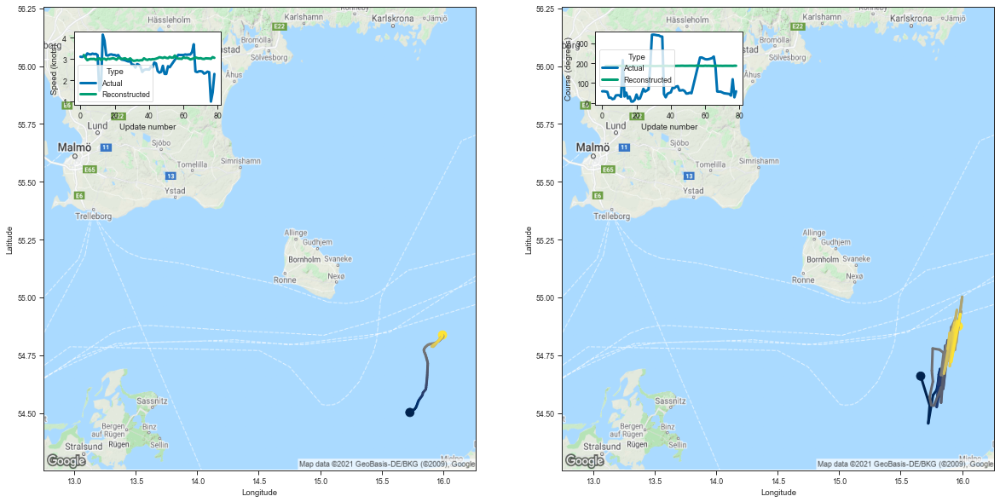

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.663161  54.659374  3.193202  185.090347         0.071198   
3   15.736140  54.533192  3.052248  185.715866         0.047882   
4   15.724664  54.455032  2.946189  185.169189         0.044069   
5   15.763368  54.576820  2.988508  185.732010         0.044128   
6   15.797083  54.602070  3.004871  185.965225         0.044702   
..        ...        ...       ...         ...              ...   
74  15.936591  54.856823  3.029377  186.689346         0.043958   
75  15.961636  54.895153  3.025643  186.866577         0.044050   
76  15.911234  54.720135  3.011981  186.317703         0.043997   
77  15.985550  54.927872  3.090555  187.222122         0.045069   
78  15.969804  54.875183  3.056575  187.037613         0.044863   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.161717     3.108608     99.425003                 1   
3         0.103609     3.028302     99.774841                

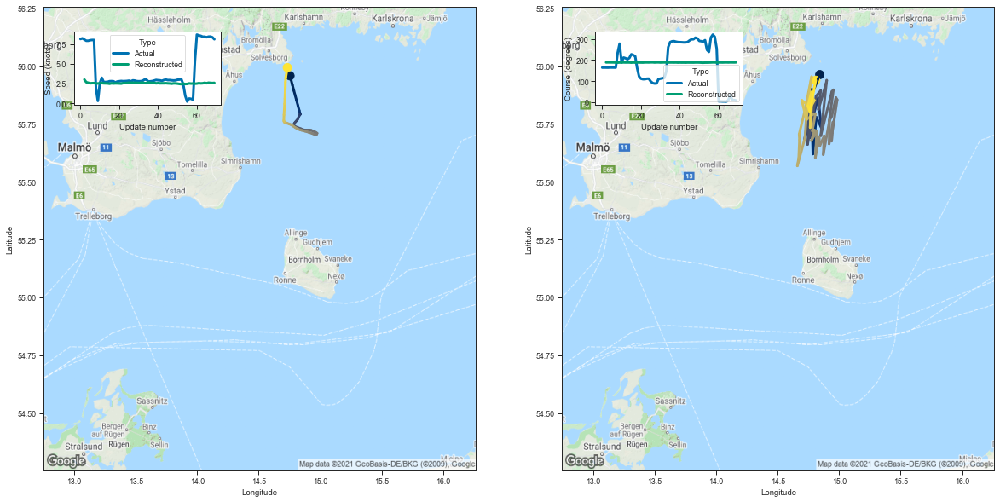

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.842895  55.963322  3.009809  188.711334         0.063465   
3   14.782651  55.882549  2.673716  188.935165         0.040564   
4   14.751682  55.884563  2.605959  188.783249         0.036943   
5   14.775416  55.899601  2.536756  188.690948         0.035125   
6   14.779392  55.840626  2.554607  188.533646         0.036060   
..        ...        ...       ...         ...              ...   
65  14.756775  55.810909  2.544500  188.371536         0.036143   
66  14.775514  55.887985  2.608753  188.814926         0.035836   
67  14.746497  55.828106  2.585155  188.698257         0.036446   
68  14.761266  55.803627  2.568621  188.510483         0.036427   
69  14.810368  55.938732  2.588310  188.984009         0.036071   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.152297     3.443259    101.330086                 1   
3         0.097535     3.277275    101.459152                

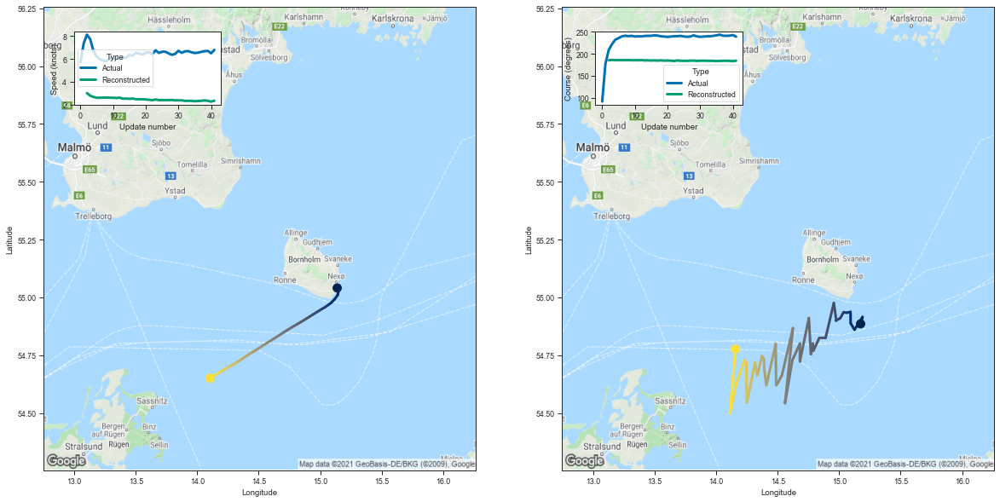

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.174815  54.885422  3.007067  185.447769         0.059832   
3   15.190272  54.914692  2.769430  186.156250         0.041230   
4   15.125149  54.859997  2.667261  185.750656         0.038506   
5   15.093800  54.887978  2.588620  185.654953         0.037312   
6   15.092690  54.937042  2.598640  185.744003         0.036988   
7   15.062818  54.933376  2.607499  185.712524         0.036115   
8   15.037168  54.935818  2.606697  185.828796         0.037394   
9   15.007812  54.909214  2.600309  185.606064         0.036809   
10  14.973623  54.900055  2.591174  185.609116         0.036805   
11  14.976932  54.899929  2.576194  185.498169         0.037074   
12  14.956983  54.975868  2.599534  185.821091         0.036862   
13  14.889975  54.824810  2.519228  185.140427         0.035951   
14  14.839146  54.824566  2.520983  185.256210         0.035452   
15  14.790046  54.769005  2.503737  184.924011         0.03544

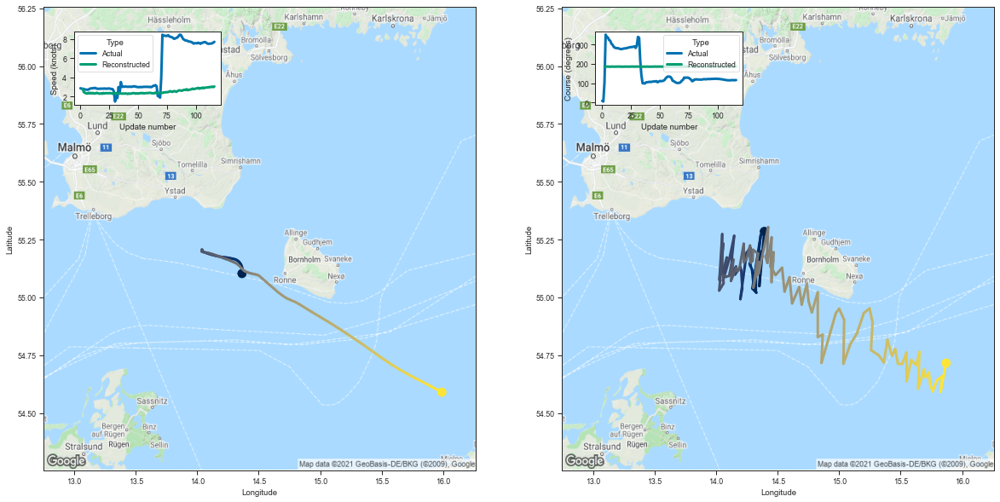

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.392099  55.284885  2.773252  186.015900         0.061452   
3    14.351460  55.048771  2.427267  185.552109         0.037491   
4    14.368590  55.199047  2.368373  185.781067         0.035733   
5    14.325055  55.122463  2.309521  185.538605         0.034957   
6    14.322678  55.027092  2.301584  185.229019         0.033798   
..         ...        ...       ...         ...              ...   
112  15.759554  54.593994  2.951049  185.638718         0.043040   
113  15.794470  54.640556  2.992462  186.022690         0.044963   
114  15.838884  54.659538  3.007296  185.985916         0.044120   
115  15.825085  54.591267  2.967746  185.697678         0.043245   
116  15.869630  54.715771  3.032366  186.382462         0.045503   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.149785     3.385909     99.875771                 1   
3          0.090799     3.169566     99.681351 

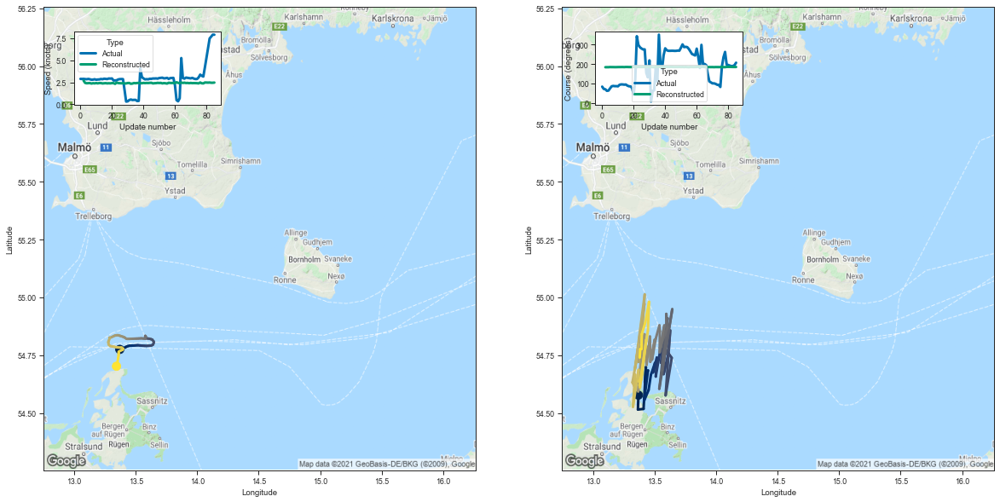

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   13.368376  54.577141  2.687840  183.501480         0.078931   
3   13.364377  54.514809  2.421765  183.659470         0.051543   
4   13.410202  54.517551  2.385492  183.655426         0.047689   
5   13.429372  54.698212  2.400394  184.303024         0.048528   
6   13.420538  54.632912  2.410421  184.113846         0.048873   
..        ...        ...       ...         ...              ...   
81  13.423621  54.889843  2.457972  185.248611         0.049867   
82  13.395658  54.840061  2.471284  184.993805         0.049792   
83  13.393888  54.776779  2.443796  184.736008         0.049787   
84  13.383663  54.776066  2.443722  184.690598         0.048722   
85  13.379076  54.739609  2.464831  184.725067         0.050638   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.174280     3.666261     98.441666                 1   
3         0.110080     3.519547     98.535316                

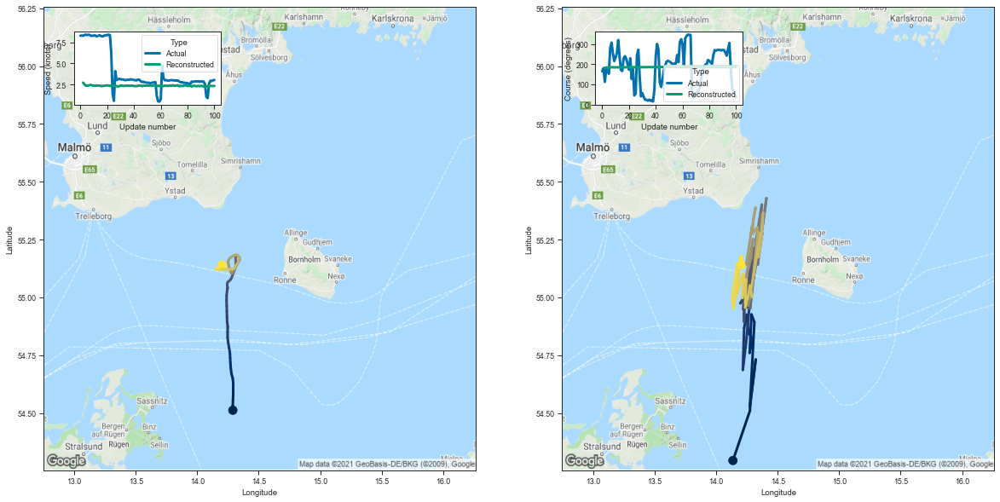

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.136644  54.294369  2.717804  182.862625         0.063318   
3    14.275458  54.510395  2.520308  184.212845         0.041342   
4    14.275804  54.532715  2.345487  183.731094         0.036975   
5    14.321880  54.731113  2.387581  184.422455         0.036417   
6    14.274829  54.526379  2.370915  183.775604         0.035219   
..         ...        ...       ...         ...              ...   
96   14.171859  55.147839  2.360323  185.771515         0.036072   
97   14.182612  55.127308  2.326444  185.631348         0.035091   
98   14.187252  55.133099  2.330554  185.692612         0.035084   
99   14.207477  55.178814  2.309772  185.700317         0.033692   
100  14.206102  55.141506  2.323938  185.604752         0.034288   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.147925     3.328090     98.174797                 1   
3          0.094388     3.180716     98.934158 

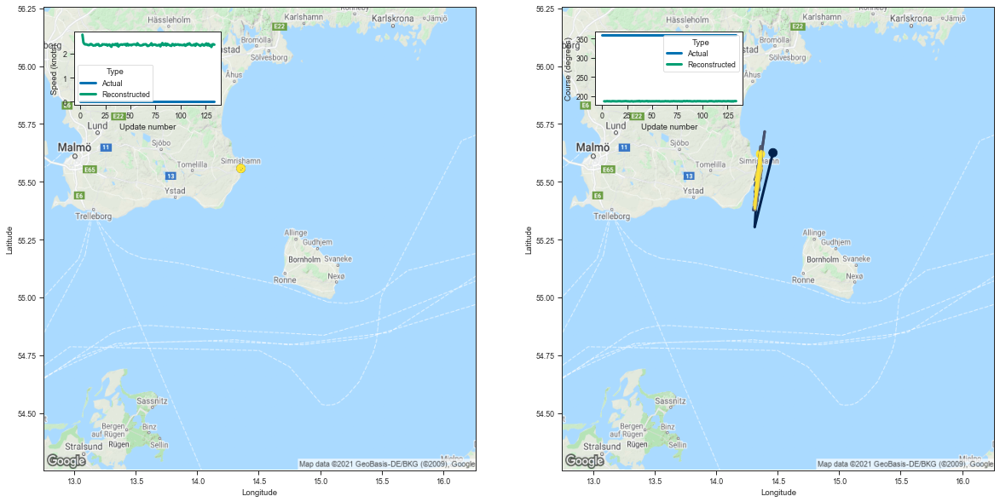

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.462279  55.625370  2.793202  186.995209         0.061569   
3    14.313858  55.304596  2.466242  186.584351         0.037540   
4    14.334285  55.479969  2.400911  186.869965         0.035171   
5    14.361307  55.597588  2.382113  187.294632         0.034140   
6    14.328772  55.474602  2.390334  186.922958         0.034668   
..         ...        ...       ...         ...              ...   
130  14.359664  55.628426  2.356471  187.355850         0.033707   
131  14.320162  55.423302  2.277699  186.313721         0.033477   
132  14.357615  55.619431  2.386193  187.325058         0.033840   
133  14.354104  55.580391  2.394272  187.240936         0.034166   
134  14.360977  55.620026  2.373677  187.365082         0.034420   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.152507     3.398133    100.413643                 1   
3          0.091688     3.229577    100.195938 

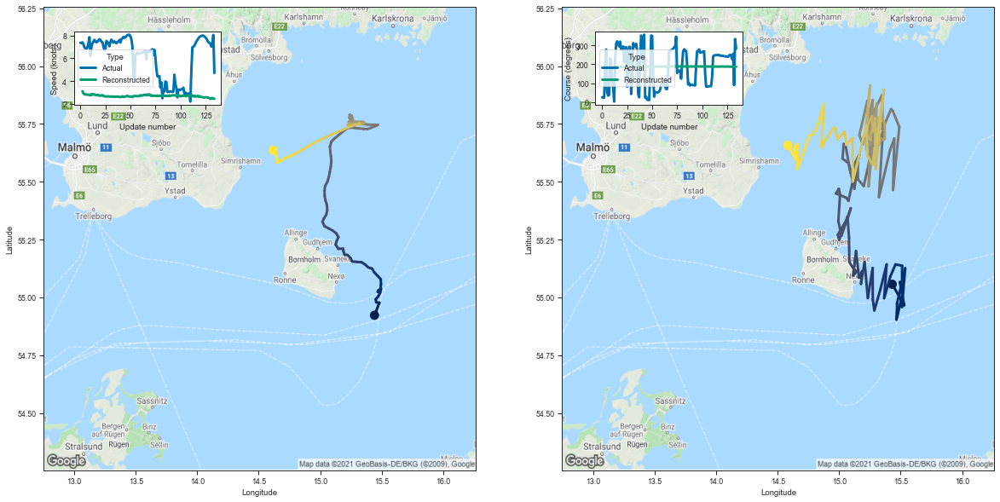

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.431648  55.056759  3.116476  186.181931         0.066351   
3    15.529397  54.965660  2.925614  186.731613         0.043682   
4    15.508317  55.026062  2.844972  186.839645         0.040645   
5    15.493692  55.065804  2.852016  186.930405         0.041000   
6    15.524261  55.067242  2.811402  186.813431         0.040704   
..         ...        ...       ...         ...              ...   
130  14.660207  55.555649  2.448732  187.228317         0.033941   
131  14.663354  55.663292  2.491905  187.763687         0.034419   
132  14.636470  55.646801  2.528254  187.910370         0.034634   
133  14.645562  55.598263  2.466001  187.431335         0.035170   
134  14.583032  55.657852  2.456019  187.629013         0.035018   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.152116     3.159286    100.004662                 1   
3          0.097869     3.017491    100.287643 

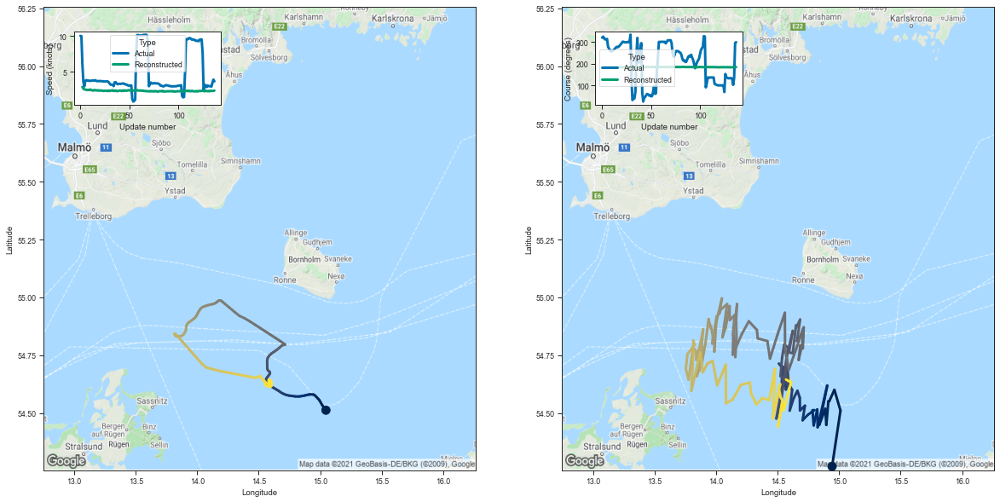

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.942841  54.268826  2.915784  183.201324         0.063707   
3    15.010937  54.510639  2.691521  184.623520         0.041282   
4    14.961428  54.600143  2.575365  184.617706         0.037819   
5    14.919694  54.550419  2.561363  184.457565         0.036567   
6    14.912604  54.550388  2.524967  184.284134         0.036574   
..         ...        ...       ...         ...              ...   
133  14.537419  54.545025  2.399322  183.890823         0.034009   
134  14.553305  54.533413  2.362226  183.835037         0.034146   
135  14.547866  54.510899  2.365317  183.610825         0.034459   
136  14.609139  54.632519  2.367775  184.148895         0.034646   
137  14.568522  54.644566  2.417507  184.345932         0.034809   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.147310     3.183848     98.408043                 1   
3          0.096467     3.047160     99.186714 

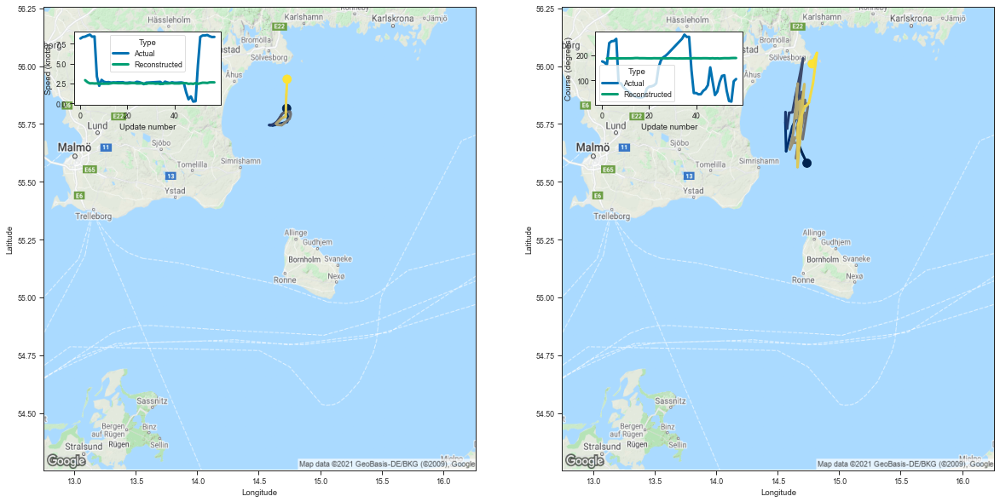

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.738822  55.580349  2.903390  187.404327         0.062242   
3   14.705152  55.617313  2.650636  188.091766         0.039441   
4   14.667956  55.665394  2.500304  187.702713         0.036010   
5   14.687470  55.817715  2.511031  188.303650         0.036308   
6   14.619953  55.738132  2.485835  187.889282         0.035402   
7   14.569176  55.631687  2.498706  187.741455         0.034771   
8   14.563160  55.755680  2.452221  187.876480         0.034799   
9   14.564043  55.800781  2.458037  188.110916         0.033689   
10  14.576324  55.729904  2.457792  187.929245         0.034441   
11  14.594262  55.798286  2.464820  188.154266         0.034641   
12  14.620250  55.800453  2.455325  188.045090         0.034407   
13  14.643174  55.865334  2.502403  188.341583         0.034278   
14  14.681770  55.963398  2.561182  189.128662         0.036273   
15  14.706737  56.033188  2.538522  189.274719         0.03587

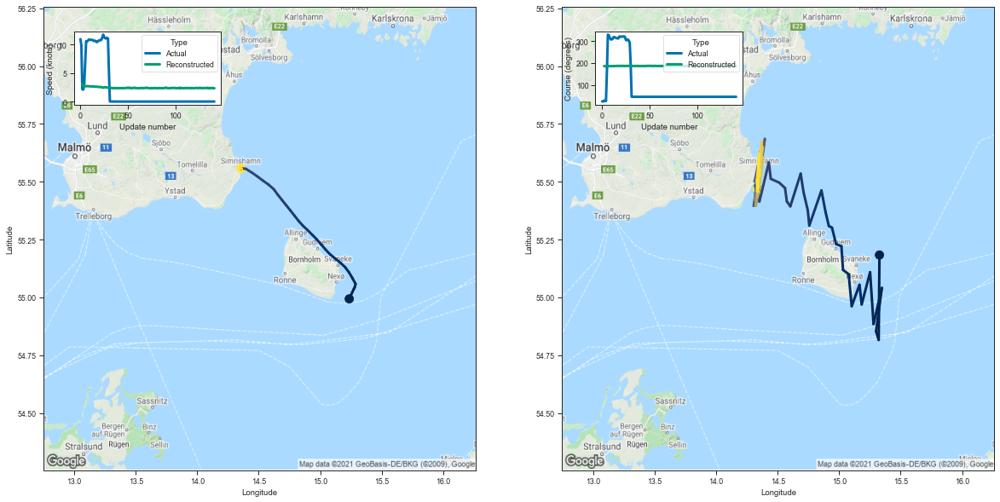

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.327877  55.183189  3.100520  186.437088         0.066332   
3    15.321872  54.815918  2.789222  185.830917         0.042077   
4    15.300441  54.853355  2.696169  185.704422         0.038299   
5    15.347430  55.040806  2.705272  186.479584         0.038441   
6    15.279815  54.884541  2.669756  185.762009         0.038078   
..         ...        ...       ...         ...              ...   
137  14.332869  55.496292  2.322450  186.768875         0.033939   
138  14.349443  55.621307  2.390234  187.278946         0.033224   
139  14.338167  55.495033  2.383121  186.885559         0.034256   
140  14.334960  55.479729  2.321277  186.619339         0.034344   
141  14.336133  55.468296  2.339888  186.679047         0.034344   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.156389     3.201047    100.144463                 1   
3          0.096866     3.049127     99.845123 

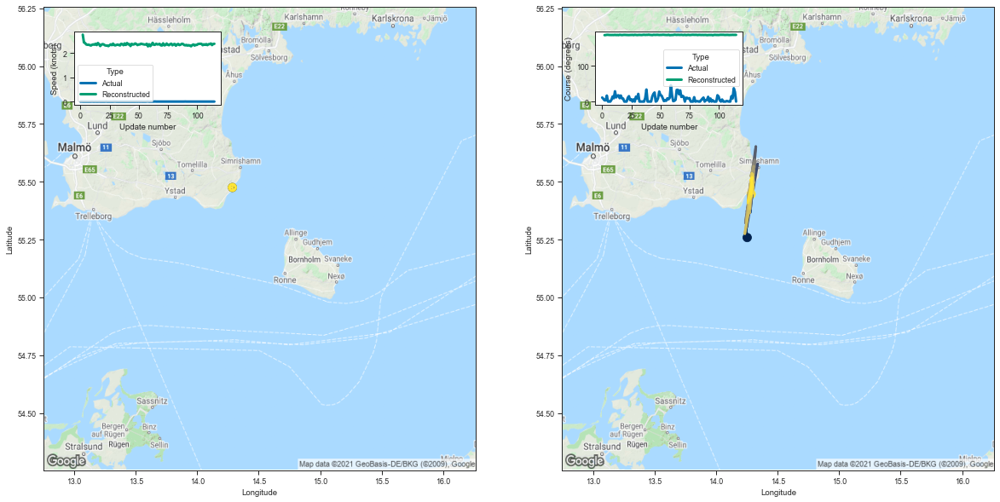

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.252632  55.258652  2.762214  186.057205         0.060340   
3    14.244120  55.288387  2.440841  186.351639         0.038570   
4    14.287203  55.478210  2.412450  186.982529         0.035078   
5    14.319777  55.556778  2.355744  187.002487         0.034675   
6    14.282357  55.447186  2.342824  186.600128         0.034447   
..         ...        ...       ...         ...              ...   
111  14.260036  55.416840  2.368206  186.730469         0.033821   
112  14.289062  55.492458  2.395996  186.987946         0.034386   
113  14.281636  55.507069  2.331817  186.757339         0.033760   
114  14.292048  55.517975  2.375578  186.883148         0.034246   
115  14.285254  55.446579  2.384563  186.781204         0.034348   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.145651     3.416333     99.885590                 1   
3          0.091912     3.239253    100.073509 

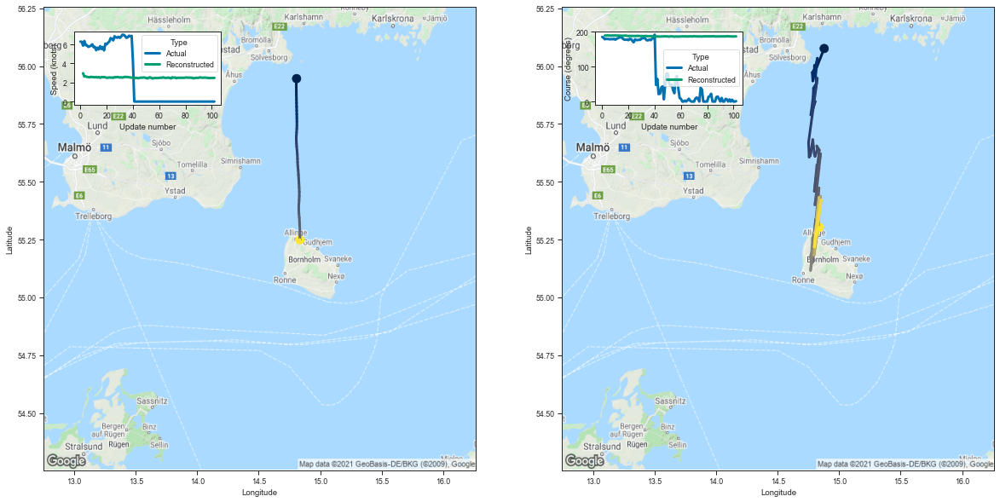

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.878407  56.076180  2.972787  188.878189         0.061812   
3    14.802111  55.973579  2.631487  188.974762         0.040202   
4    14.799841  56.003426  2.640872  189.447784         0.035941   
5    14.798002  55.965374  2.596729  188.990051         0.035460   
6    14.786121  55.935963  2.567039  188.892166         0.035847   
..         ...        ...       ...         ...              ...   
98   14.808711  55.285336  2.464804  186.497330         0.033900   
99   14.804899  55.233482  2.472504  186.271652         0.034195   
100  14.798745  55.217197  2.477962  186.361938         0.034927   
101  14.808254  55.266499  2.475577  186.435471         0.033726   
102  14.839477  55.302727  2.484190  186.635086         0.034488   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.152642     3.416707    101.415428                 1   
3          0.099018     3.270873    101.489395 

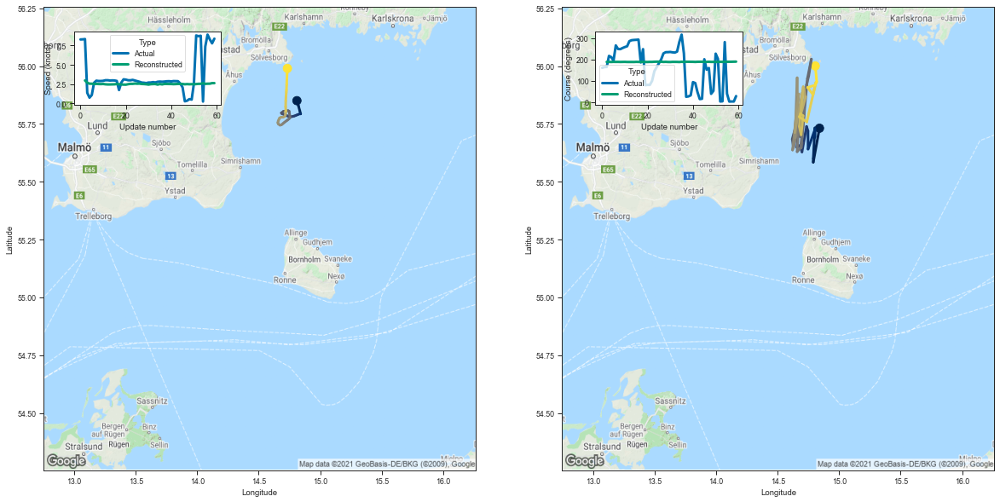

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.840319  55.731438  2.974403  187.891418         0.063421   
3   14.789757  55.584084  2.672089  187.986313         0.039387   
4   14.790136  55.600727  2.553290  187.713882         0.036216   
5   14.803097  55.732811  2.547174  188.206024         0.034845   
6   14.802585  55.692039  2.519703  188.015213         0.034839   
7   14.803558  55.726742  2.531862  188.071365         0.034764   
8   14.747633  55.641136  2.508663  187.739120         0.033692   
9   14.746975  55.719517  2.499215  188.026031         0.034863   
10  14.735316  55.739166  2.516076  188.193573         0.034771   
11  14.697973  55.628716  2.474491  187.715790         0.033856   
12  14.686976  55.651005  2.453813  187.643021         0.033931   
13  14.709959  55.668156  2.454441  187.710327         0.033595   
14  14.656663  55.647919  2.463850  187.616226         0.033347   
15  14.681149  55.820171  2.470745  188.176453         0.03420

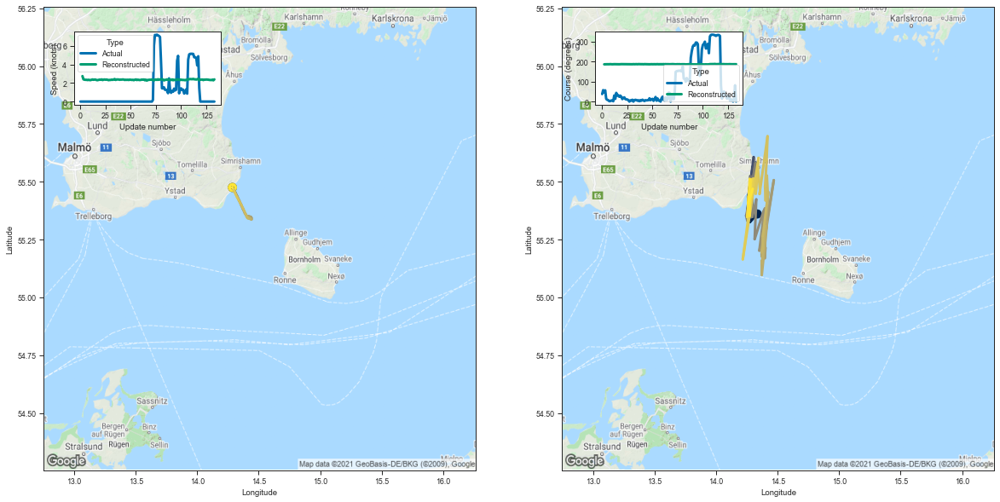

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.334550  55.360626  2.747443  186.146912         0.059678   
3    14.274844  55.325413  2.399180  186.371765         0.037784   
4    14.290442  55.447025  2.360178  186.605698         0.034268   
5    14.280790  55.425133  2.346974  186.559433         0.033710   
6    14.252926  55.339451  2.347726  186.322556         0.033749   
..         ...        ...       ...         ...              ...   
129  14.273821  55.511906  2.328867  186.701813         0.033849   
130  14.271928  55.352322  2.320599  186.300003         0.034252   
131  14.265052  55.437008  2.355912  186.744171         0.034063   
132  14.260874  55.407082  2.292414  186.355240         0.034260   
133  14.297261  55.469646  2.391696  186.900589         0.034380   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.145869     3.390277     99.967430                 1   
3          0.093116     3.206729    100.104095 

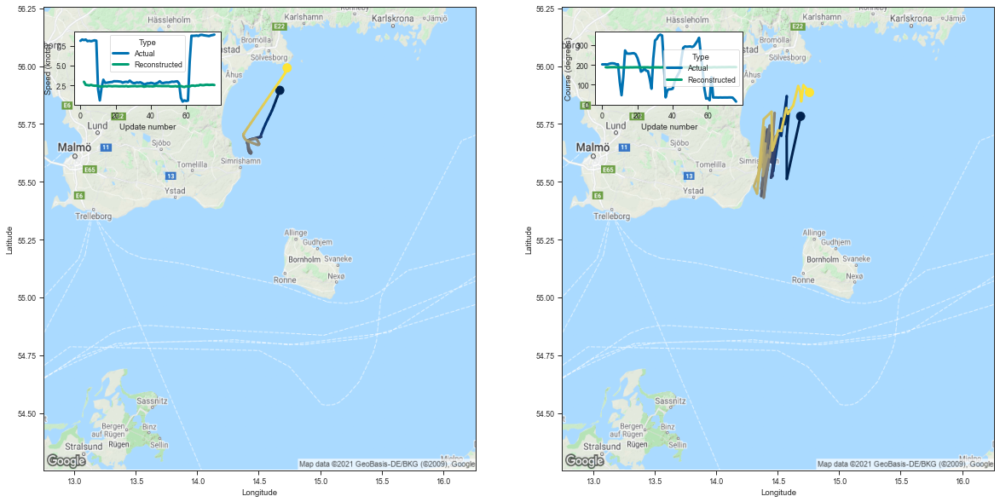

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.686879  55.783134  2.960067  188.183563         0.064830   
3   14.574878  55.512165  2.575612  187.475403         0.039258   
4   14.573668  55.696346  2.543844  188.027115         0.036639   
5   14.592146  55.808140  2.505073  188.204163         0.035325   
6   14.559576  55.748714  2.572121  188.281967         0.036299   
..        ...        ...       ...         ...              ...   
72  14.667274  55.913631  2.593869  189.009186         0.037136   
73  14.683716  55.890305  2.563871  188.743729         0.037196   
74  14.691837  55.847828  2.580783  188.736404         0.036475   
75  14.710027  55.917366  2.592852  188.932983         0.035891   
76  14.759402  55.886196  2.554837  188.607986         0.036003   

    Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2         0.151857     3.442186    101.024155                 1   
3         0.093446     3.258558    100.685745                

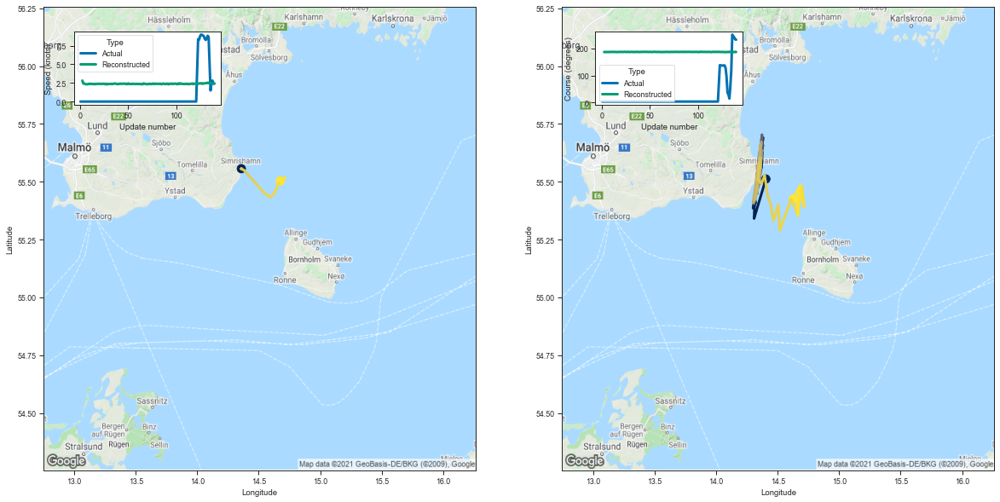

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.404467  55.511787  2.815418  186.816193         0.061653   
3    14.308992  55.341717  2.429162  186.500961         0.036785   
4    14.314747  55.428825  2.405740  186.820312         0.035117   
5    14.321285  55.408710  2.369049  186.727661         0.034312   
6    14.300304  55.386070  2.325060  186.448120         0.034174   
..         ...        ...       ...         ...              ...   
136  14.681504  55.463921  2.475608  187.075470         0.034534   
137  14.665689  55.353733  2.410714  186.631516         0.034231   
138  14.657520  55.389950  2.419606  186.694977         0.033443   
139  14.681030  55.482151  2.458535  187.215622         0.034425   
140  14.626540  55.425259  2.438228  186.851730         0.033428   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.149729     3.446916    100.303490                 1   
3          0.090709     3.201681    100.155678 

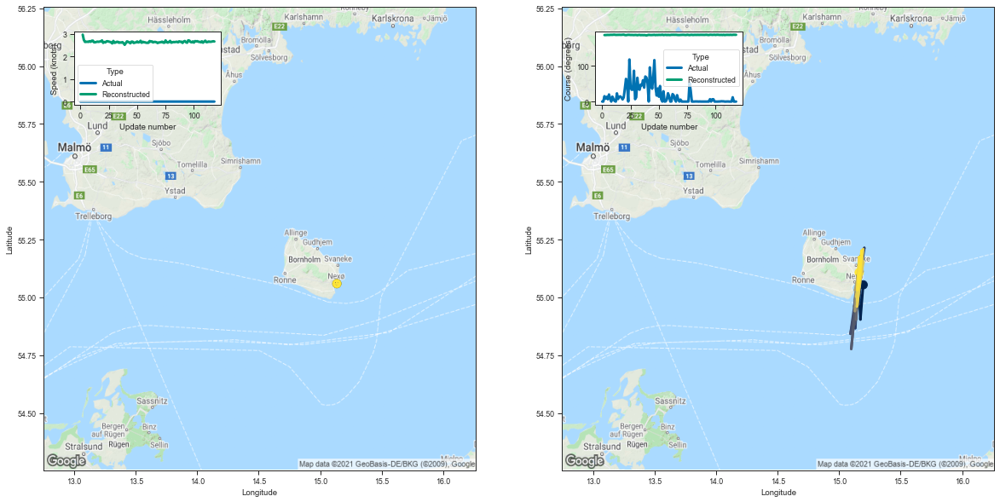

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.195518  55.054180  2.962618  185.830170         0.062129   
3    15.172956  54.904377  2.731555  185.863235         0.040255   
4    15.165000  54.990669  2.640309  186.086472         0.037385   
5    15.175006  55.083759  2.643516  186.292145         0.036944   
6    15.158502  55.014259  2.650458  186.088547         0.036924   
..         ...        ...       ...         ...              ...   
114  15.152359  55.032475  2.645666  186.240906         0.035874   
115  15.168633  55.078506  2.647160  186.409653         0.037097   
116  15.182303  55.202023  2.656542  186.771683         0.037192   
117  15.158232  55.065254  2.668583  186.527481         0.037553   
118  15.163587  55.107609  2.659329  186.525848         0.036860   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.147156     3.193926     99.840935                 1   
3          0.092556     3.048562     99.846687 

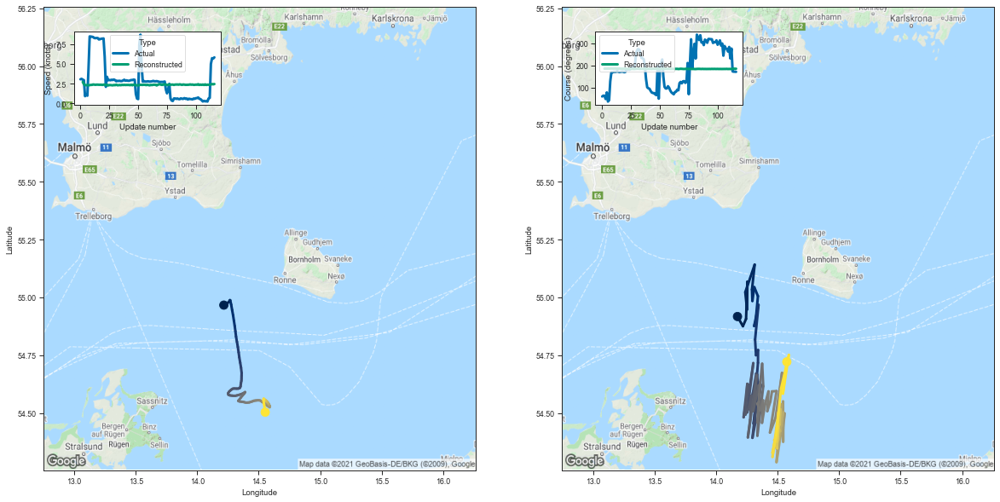

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.173710  54.917110  2.710215  184.797165         0.059744   
3    14.217839  54.875221  2.423219  185.004318         0.038368   
4    14.243526  54.906914  2.317350  184.745239         0.035211   
5    14.254037  55.067612  2.289026  185.177658         0.034773   
6    14.251547  54.947208  2.313092  184.911301         0.034101   
..         ...        ...       ...         ...              ...   
112  14.487952  54.401588  2.366337  183.280930         0.034487   
113  14.528152  54.605762  2.384331  184.066467         0.034819   
114  14.591693  54.751331  2.443188  184.740921         0.036213   
115  14.542940  54.583603  2.408723  184.066864         0.036124   
116  14.574841  54.721237  2.446278  184.507614         0.035538   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.141651     3.411622     99.227158                 1   
3          0.090410     3.215677     99.372795 

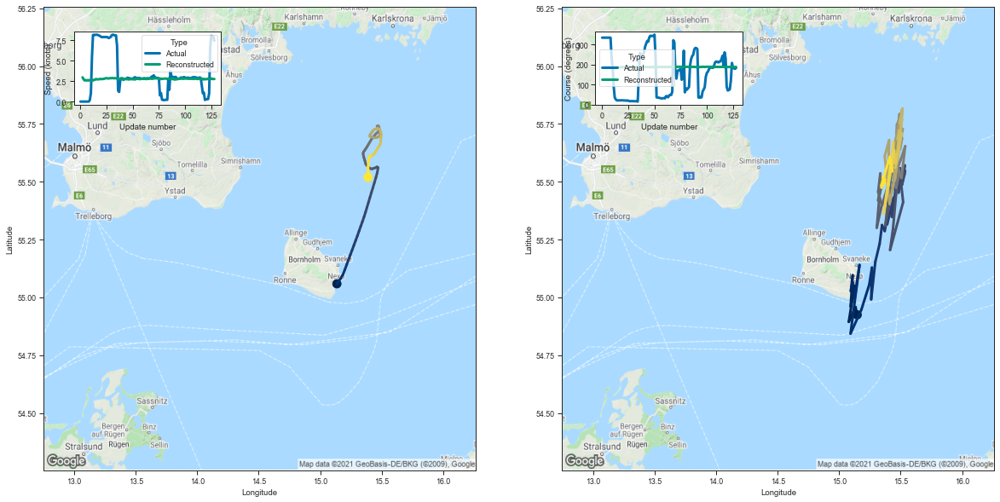

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.146667  54.924442  2.975622  185.637085         0.062028   
3    15.133360  54.958160  2.737114  186.184036         0.039996   
4    15.078544  54.894012  2.592895  185.466782         0.036317   
5    15.124603  55.050365  2.626174  186.313049         0.036916   
6    15.093761  54.960484  2.583041  185.707565         0.035535   
..         ...        ...       ...         ...              ...   
124  15.422093  55.555573  2.753735  188.197327         0.036944   
125  15.412349  55.607788  2.845154  188.725250         0.038466   
126  15.342884  55.484219  2.772645  188.009399         0.037863   
127  15.344394  55.474766  2.766502  188.068024         0.037448   
128  15.373130  55.508675  2.770233  188.262985         0.038186   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.147070     3.193808     99.736977                 1   
3          0.091690     3.060337    100.018143 

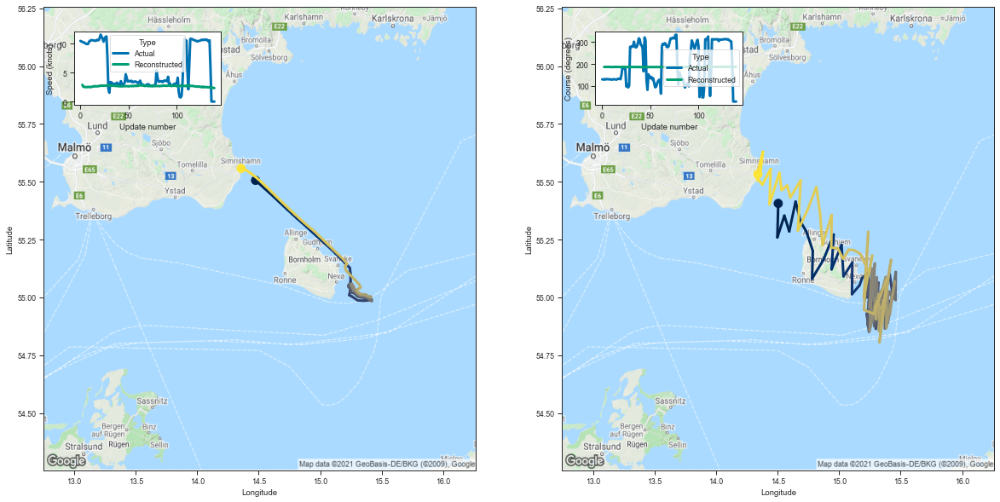

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.505131  55.406170  2.896878  186.584808         0.066123   
3    14.497940  55.259148  2.562582  186.644119         0.040564   
4    14.554952  55.353436  2.541847  186.971680         0.037030   
5    14.594490  55.285294  2.499811  186.629013         0.036325   
6    14.646214  55.414040  2.511271  187.058289         0.036867   
..         ...        ...       ...         ...              ...   
135  14.326066  55.519863  2.405146  187.100891         0.036651   
136  14.380796  55.629456  2.427964  187.541641         0.035701   
137  14.359331  55.537361  2.367940  186.936539         0.035266   
138  14.335835  55.505638  2.383584  186.917389         0.034316   
139  14.339651  55.533020  2.332164  186.884918         0.033511   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.156892     3.438240    100.178841                 1   
3          0.096303     3.233644    100.222588 

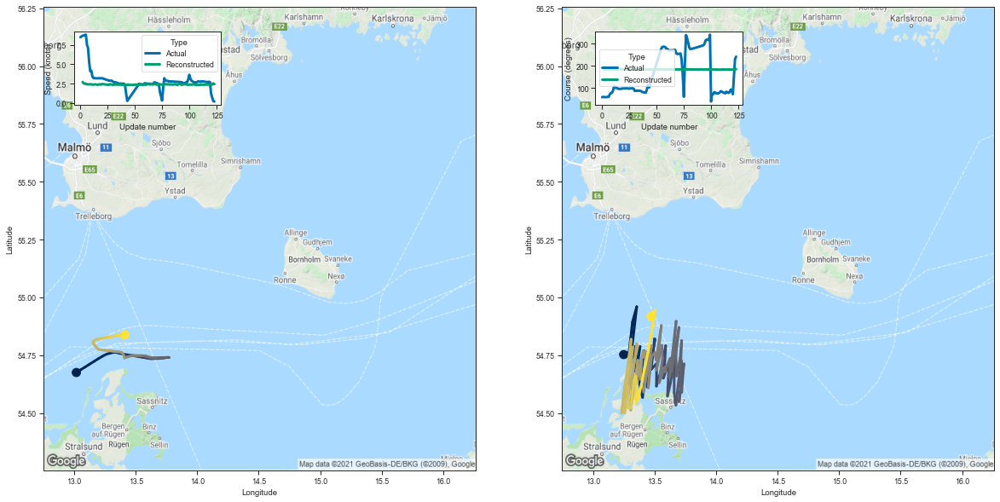

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    13.248900  54.752598  2.721772  184.067230         0.081852   
3    13.291918  54.762516  2.549862  184.974945         0.056462   
4    13.320540  54.894211  2.489980  185.133835         0.052760   
5    13.354800  54.959576  2.510629  185.511658         0.053439   
6    13.300530  54.711288  2.419723  184.415176         0.050868   
..         ...        ...       ...         ...              ...   
119  13.365681  54.585720  2.385794  183.824509         0.046391   
120  13.364251  54.552116  2.393216  183.909088         0.049062   
121  13.445292  54.759529  2.394650  184.485672         0.047700   
122  13.505712  54.945950  2.539809  185.583984         0.049126   
123  13.471042  54.917233  2.450024  185.254868         0.048256   

     Latitude sigma  Speed sigma  Course sigma  Max mixing index  \
2          0.176547     3.759184     98.730980                 1   
3          0.117048     3.656468     99.212746 

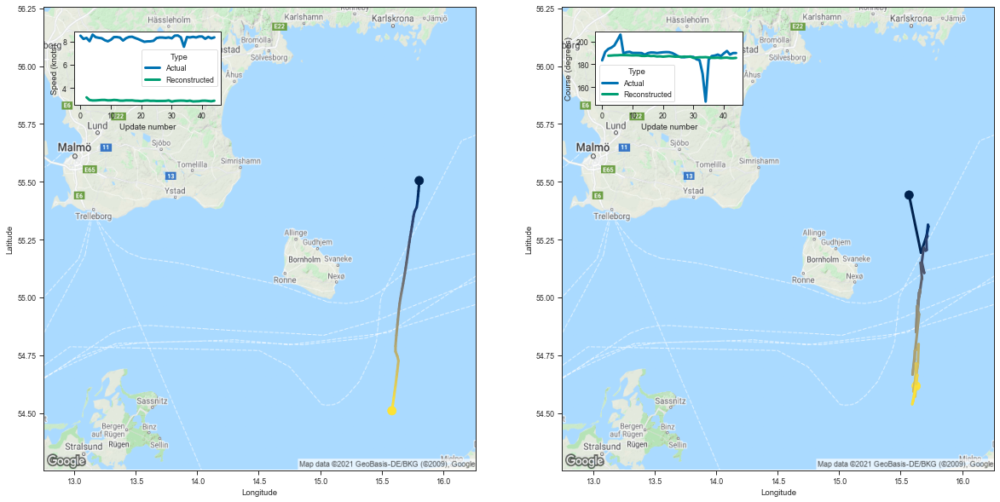

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.568496  55.442295  3.202362  187.527847         0.067280   
3   15.665394  55.193302  2.971269  187.673920         0.045556   
4   15.709253  55.263126  2.934013  187.882385         0.041629   
5   15.726186  55.306278  2.938571  187.917831         0.041470   
6   15.722341  55.313793  2.957829  188.080048         0.041147   
7   15.714382  55.270473  2.977930  188.041641         0.040944   
8   15.717839  55.264172  2.979569  188.008133         0.041473   
9   15.709362  55.251495  2.941859  187.897141         0.042546   
10  15.712068  55.204956  2.946131  187.784744         0.041450   
11  15.702591  55.201977  2.978491  187.886902         0.041684   
12  15.687776  55.214924  2.963041  187.807678         0.042046   
13  15.672358  55.152370  2.917989  187.341232         0.041351   
14  15.692085  55.105633  2.915451  187.307480         0.041708   
15  15.662070  55.149448  2.943207  187.581558         0.04220

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
17,17,6685896,265759000,Fishing,143,-644.531982,-4.507217
60,60,6869996,265759000,Fishing,143,-645.277405,-4.512429
29,29,6787151,265759000,Fishing,143,-650.816528,-4.551165
74,74,6962046,265759000,Fishing,143,-654.998047,-4.580406
70,70,2240973,230069190,Fishing,141,-648.598328,-4.599988
...,...,...,...,...,...,...,...
94,94,3010756,261002520,Fishing,117,-744.240723,-6.361032
80,80,2458890,261001400,Fishing,129,-824.676147,-6.392838
91,91,5598936,265750000,Fishing,140,-903.317139,-6.452265
2,2,295372,211314800,Fishing,124,-810.102539,-6.533085


In [12]:
# Focus on the overall n=100 best reconstructions
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(100): 
    tracks = plot_actual_reconstructed(idx)
    # print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
    print(tracks['Reconstructed trajectory'])
df_n